# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory 'data': File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

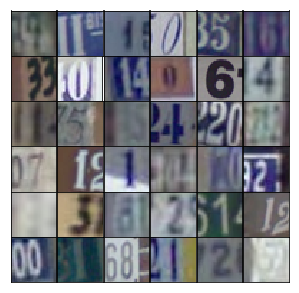

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(self.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.1464... Generator Loss: 0.9381
Epoch 1/25... Discriminator Loss: 0.6038... Generator Loss: 1.2846
Epoch 1/25... Discriminator Loss: 0.2087... Generator Loss: 2.4507
Epoch 1/25... Discriminator Loss: 0.1875... Generator Loss: 2.6752
Epoch 1/25... Discriminator Loss: 0.1808... Generator Loss: 2.4819
Epoch 1/25... Discriminator Loss: 0.1128... Generator Loss: 2.9424
Epoch 1/25... Discriminator Loss: 0.1883... Generator Loss: 2.8374
Epoch 1/25... Discriminator Loss: 0.2266... Generator Loss: 2.8741
Epoch 1/25... Discriminator Loss: 0.2327... Generator Loss: 2.1942
Epoch 1/25... Discriminator Loss: 0.3206... Generator Loss: 2.9769


/home/ubuntu/miniconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


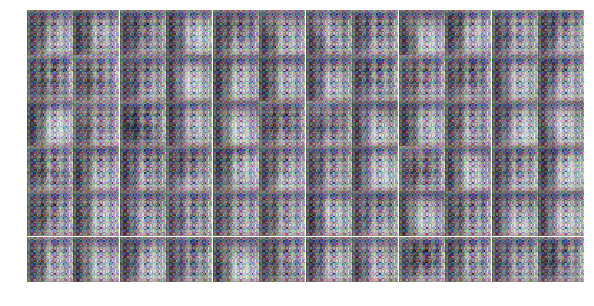

Epoch 1/25... Discriminator Loss: 1.8799... Generator Loss: 4.0243
Epoch 1/25... Discriminator Loss: 0.6500... Generator Loss: 1.6954
Epoch 1/25... Discriminator Loss: 0.6279... Generator Loss: 1.6178
Epoch 1/25... Discriminator Loss: 0.3873... Generator Loss: 1.8652
Epoch 1/25... Discriminator Loss: 0.4226... Generator Loss: 2.1741
Epoch 1/25... Discriminator Loss: 0.8407... Generator Loss: 1.8619
Epoch 1/25... Discriminator Loss: 0.3452... Generator Loss: 1.7895
Epoch 1/25... Discriminator Loss: 0.5147... Generator Loss: 1.7881
Epoch 1/25... Discriminator Loss: 0.8914... Generator Loss: 3.7208
Epoch 1/25... Discriminator Loss: 0.5697... Generator Loss: 1.5163


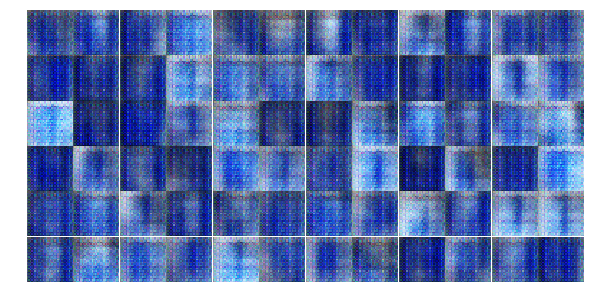

Epoch 1/25... Discriminator Loss: 0.5453... Generator Loss: 1.3879
Epoch 1/25... Discriminator Loss: 0.4661... Generator Loss: 1.9215
Epoch 1/25... Discriminator Loss: 0.5862... Generator Loss: 2.2687
Epoch 1/25... Discriminator Loss: 1.5444... Generator Loss: 2.8551
Epoch 1/25... Discriminator Loss: 0.4309... Generator Loss: 1.7029
Epoch 1/25... Discriminator Loss: 0.9307... Generator Loss: 3.9544
Epoch 1/25... Discriminator Loss: 1.7558... Generator Loss: 0.3107
Epoch 1/25... Discriminator Loss: 0.9934... Generator Loss: 1.0645
Epoch 1/25... Discriminator Loss: 0.8961... Generator Loss: 1.4624
Epoch 1/25... Discriminator Loss: 0.9821... Generator Loss: 1.0582


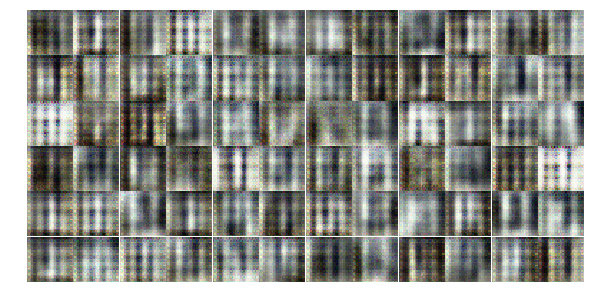

Epoch 1/25... Discriminator Loss: 1.9780... Generator Loss: 0.6725
Epoch 1/25... Discriminator Loss: 0.6503... Generator Loss: 1.4852
Epoch 1/25... Discriminator Loss: 0.5702... Generator Loss: 1.6138
Epoch 1/25... Discriminator Loss: 0.6010... Generator Loss: 1.7896
Epoch 1/25... Discriminator Loss: 0.4359... Generator Loss: 1.9660
Epoch 1/25... Discriminator Loss: 1.0125... Generator Loss: 0.7664
Epoch 1/25... Discriminator Loss: 0.8233... Generator Loss: 1.0405
Epoch 1/25... Discriminator Loss: 0.6878... Generator Loss: 1.4693
Epoch 1/25... Discriminator Loss: 0.5839... Generator Loss: 1.5112
Epoch 1/25... Discriminator Loss: 0.8710... Generator Loss: 1.6218


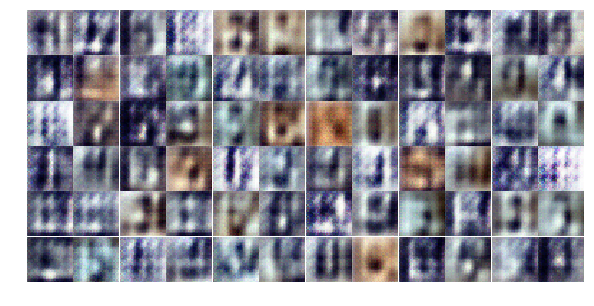

Epoch 1/25... Discriminator Loss: 0.6875... Generator Loss: 1.3808
Epoch 1/25... Discriminator Loss: 0.6936... Generator Loss: 1.2899
Epoch 1/25... Discriminator Loss: 0.9904... Generator Loss: 0.8885
Epoch 1/25... Discriminator Loss: 0.6604... Generator Loss: 1.5263
Epoch 1/25... Discriminator Loss: 0.6609... Generator Loss: 1.7791
Epoch 1/25... Discriminator Loss: 1.2079... Generator Loss: 0.6355
Epoch 1/25... Discriminator Loss: 0.5621... Generator Loss: 1.6132
Epoch 1/25... Discriminator Loss: 0.6506... Generator Loss: 1.3705
Epoch 1/25... Discriminator Loss: 1.0492... Generator Loss: 0.9474
Epoch 1/25... Discriminator Loss: 0.6415... Generator Loss: 1.9871


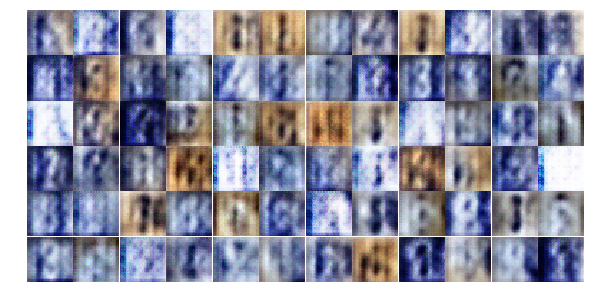

Epoch 1/25... Discriminator Loss: 0.8374... Generator Loss: 1.4149
Epoch 1/25... Discriminator Loss: 1.1006... Generator Loss: 0.8855
Epoch 1/25... Discriminator Loss: 0.7881... Generator Loss: 1.9885
Epoch 1/25... Discriminator Loss: 1.2270... Generator Loss: 0.5783
Epoch 1/25... Discriminator Loss: 0.5530... Generator Loss: 1.9194
Epoch 1/25... Discriminator Loss: 0.6117... Generator Loss: 1.2711
Epoch 1/25... Discriminator Loss: 0.7412... Generator Loss: 1.3950
Epoch 2/25... Discriminator Loss: 0.8361... Generator Loss: 1.4940
Epoch 2/25... Discriminator Loss: 0.8232... Generator Loss: 1.4438
Epoch 2/25... Discriminator Loss: 1.0351... Generator Loss: 0.6661


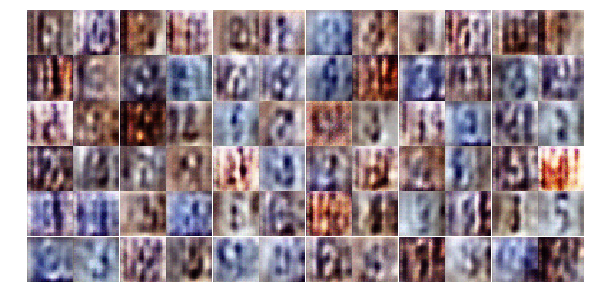

Epoch 2/25... Discriminator Loss: 1.0107... Generator Loss: 0.9582
Epoch 2/25... Discriminator Loss: 1.2889... Generator Loss: 1.2402
Epoch 2/25... Discriminator Loss: 0.8657... Generator Loss: 1.0723
Epoch 2/25... Discriminator Loss: 1.2288... Generator Loss: 0.8720
Epoch 2/25... Discriminator Loss: 0.9577... Generator Loss: 1.0330
Epoch 2/25... Discriminator Loss: 0.8881... Generator Loss: 1.5659
Epoch 2/25... Discriminator Loss: 0.9379... Generator Loss: 1.0529
Epoch 2/25... Discriminator Loss: 0.8706... Generator Loss: 1.1462
Epoch 2/25... Discriminator Loss: 0.8694... Generator Loss: 1.4385
Epoch 2/25... Discriminator Loss: 1.1989... Generator Loss: 1.5520


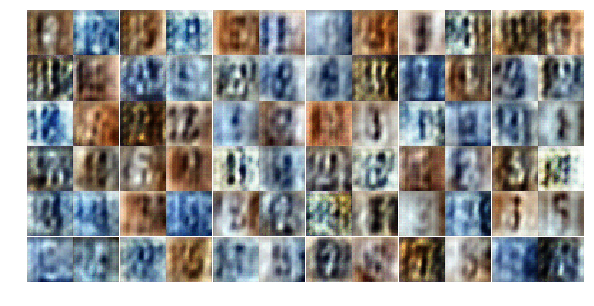

Epoch 2/25... Discriminator Loss: 1.0361... Generator Loss: 1.0796
Epoch 2/25... Discriminator Loss: 1.4326... Generator Loss: 1.8178
Epoch 2/25... Discriminator Loss: 1.1897... Generator Loss: 0.6069
Epoch 2/25... Discriminator Loss: 1.0577... Generator Loss: 0.7861
Epoch 2/25... Discriminator Loss: 1.1077... Generator Loss: 1.1040
Epoch 2/25... Discriminator Loss: 1.1181... Generator Loss: 1.2781
Epoch 2/25... Discriminator Loss: 1.3421... Generator Loss: 0.5459
Epoch 2/25... Discriminator Loss: 1.1212... Generator Loss: 1.0387
Epoch 2/25... Discriminator Loss: 1.1919... Generator Loss: 1.0051
Epoch 2/25... Discriminator Loss: 1.2584... Generator Loss: 0.6668


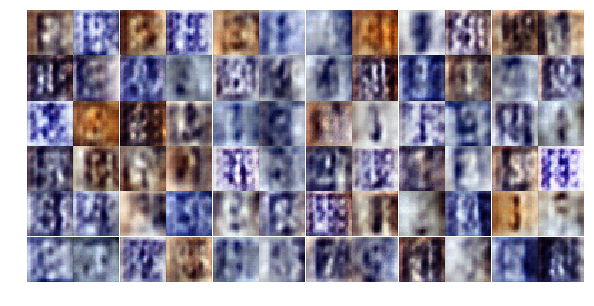

Epoch 2/25... Discriminator Loss: 1.0366... Generator Loss: 0.8823
Epoch 2/25... Discriminator Loss: 1.0450... Generator Loss: 1.1954
Epoch 2/25... Discriminator Loss: 0.9770... Generator Loss: 1.1351
Epoch 2/25... Discriminator Loss: 1.1091... Generator Loss: 1.3566
Epoch 2/25... Discriminator Loss: 1.3393... Generator Loss: 1.0539
Epoch 2/25... Discriminator Loss: 1.1047... Generator Loss: 1.1107
Epoch 2/25... Discriminator Loss: 1.1400... Generator Loss: 0.6568
Epoch 2/25... Discriminator Loss: 1.0629... Generator Loss: 0.7682
Epoch 2/25... Discriminator Loss: 1.2230... Generator Loss: 0.9021
Epoch 2/25... Discriminator Loss: 0.7879... Generator Loss: 1.2982


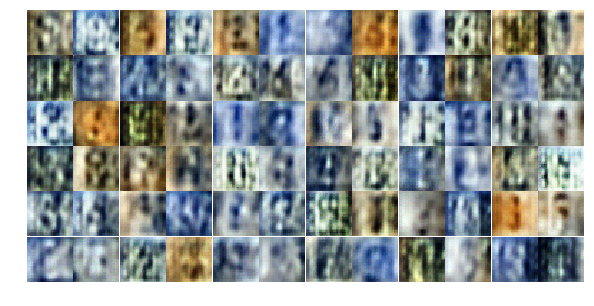

Epoch 2/25... Discriminator Loss: 1.2163... Generator Loss: 1.3548
Epoch 2/25... Discriminator Loss: 1.2351... Generator Loss: 0.6672
Epoch 2/25... Discriminator Loss: 1.2159... Generator Loss: 0.7096
Epoch 2/25... Discriminator Loss: 1.1469... Generator Loss: 0.7934
Epoch 2/25... Discriminator Loss: 0.9925... Generator Loss: 1.6546
Epoch 2/25... Discriminator Loss: 1.2798... Generator Loss: 0.9150
Epoch 2/25... Discriminator Loss: 1.2353... Generator Loss: 0.8517
Epoch 2/25... Discriminator Loss: 1.2624... Generator Loss: 1.3023
Epoch 2/25... Discriminator Loss: 1.0771... Generator Loss: 1.2013
Epoch 2/25... Discriminator Loss: 1.2097... Generator Loss: 0.7564


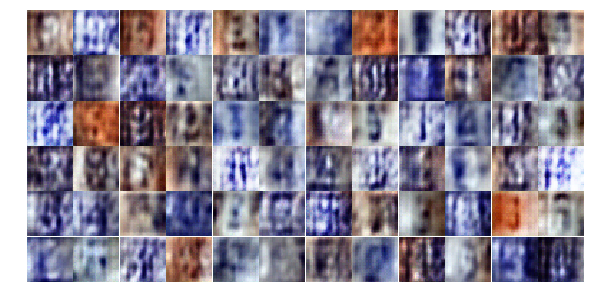

Epoch 2/25... Discriminator Loss: 0.8733... Generator Loss: 1.3921
Epoch 2/25... Discriminator Loss: 1.1617... Generator Loss: 0.8187
Epoch 2/25... Discriminator Loss: 0.6362... Generator Loss: 1.5154
Epoch 2/25... Discriminator Loss: 1.1594... Generator Loss: 0.6271
Epoch 2/25... Discriminator Loss: 1.0767... Generator Loss: 0.7993
Epoch 2/25... Discriminator Loss: 1.3149... Generator Loss: 0.4846
Epoch 2/25... Discriminator Loss: 0.5902... Generator Loss: 2.7600
Epoch 2/25... Discriminator Loss: 0.8570... Generator Loss: 1.3833
Epoch 2/25... Discriminator Loss: 0.6933... Generator Loss: 2.0103
Epoch 2/25... Discriminator Loss: 1.1069... Generator Loss: 0.7516


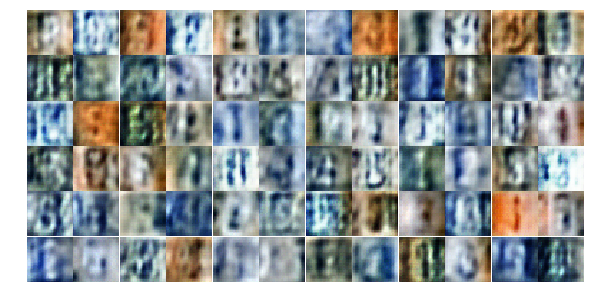

Epoch 2/25... Discriminator Loss: 1.1030... Generator Loss: 1.1313
Epoch 2/25... Discriminator Loss: 0.5553... Generator Loss: 1.7023
Epoch 2/25... Discriminator Loss: 1.6104... Generator Loss: 0.3317
Epoch 2/25... Discriminator Loss: 0.9645... Generator Loss: 1.0403
Epoch 3/25... Discriminator Loss: 0.7036... Generator Loss: 2.3682
Epoch 3/25... Discriminator Loss: 0.8806... Generator Loss: 1.4046
Epoch 3/25... Discriminator Loss: 1.0605... Generator Loss: 1.7375
Epoch 3/25... Discriminator Loss: 0.6540... Generator Loss: 1.1686
Epoch 3/25... Discriminator Loss: 1.0402... Generator Loss: 2.2297
Epoch 3/25... Discriminator Loss: 1.4892... Generator Loss: 0.4578


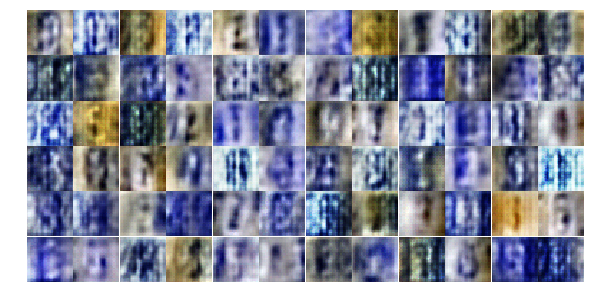

Epoch 3/25... Discriminator Loss: 0.5948... Generator Loss: 1.2543
Epoch 3/25... Discriminator Loss: 1.2329... Generator Loss: 2.3861
Epoch 3/25... Discriminator Loss: 1.1747... Generator Loss: 0.6600
Epoch 3/25... Discriminator Loss: 0.8058... Generator Loss: 0.9969
Epoch 3/25... Discriminator Loss: 1.3296... Generator Loss: 0.4353
Epoch 3/25... Discriminator Loss: 0.7936... Generator Loss: 0.8995
Epoch 3/25... Discriminator Loss: 1.0882... Generator Loss: 1.0930
Epoch 3/25... Discriminator Loss: 0.5434... Generator Loss: 2.2519
Epoch 3/25... Discriminator Loss: 0.7389... Generator Loss: 0.9531
Epoch 3/25... Discriminator Loss: 0.5579... Generator Loss: 1.5023


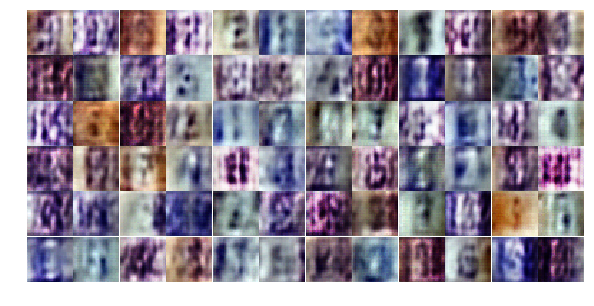

Epoch 3/25... Discriminator Loss: 1.3295... Generator Loss: 2.1985
Epoch 3/25... Discriminator Loss: 0.9490... Generator Loss: 0.8980
Epoch 3/25... Discriminator Loss: 0.7552... Generator Loss: 0.9844
Epoch 3/25... Discriminator Loss: 1.1990... Generator Loss: 2.4510
Epoch 3/25... Discriminator Loss: 0.8220... Generator Loss: 1.2572
Epoch 3/25... Discriminator Loss: 0.8378... Generator Loss: 3.5529
Epoch 3/25... Discriminator Loss: 0.7306... Generator Loss: 0.9816
Epoch 3/25... Discriminator Loss: 0.7585... Generator Loss: 1.2110
Epoch 3/25... Discriminator Loss: 1.2172... Generator Loss: 3.8754
Epoch 3/25... Discriminator Loss: 0.7689... Generator Loss: 2.3017


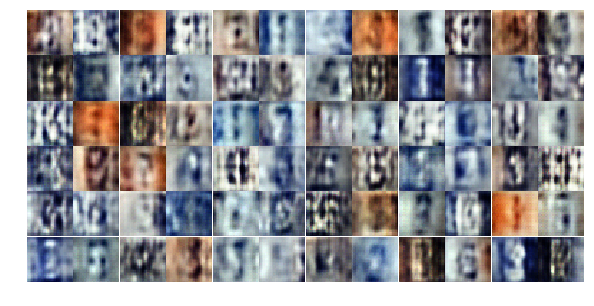

Epoch 3/25... Discriminator Loss: 1.0241... Generator Loss: 2.0024
Epoch 3/25... Discriminator Loss: 1.1156... Generator Loss: 0.7005
Epoch 3/25... Discriminator Loss: 0.6693... Generator Loss: 1.3021
Epoch 3/25... Discriminator Loss: 1.4687... Generator Loss: 0.3445
Epoch 3/25... Discriminator Loss: 1.2026... Generator Loss: 1.2268
Epoch 3/25... Discriminator Loss: 0.5945... Generator Loss: 1.5729
Epoch 3/25... Discriminator Loss: 0.9724... Generator Loss: 0.8025
Epoch 3/25... Discriminator Loss: 0.8156... Generator Loss: 1.2151
Epoch 3/25... Discriminator Loss: 0.9222... Generator Loss: 0.7572
Epoch 3/25... Discriminator Loss: 0.8876... Generator Loss: 1.1035


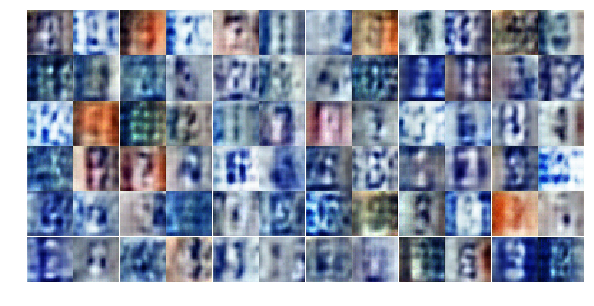

Epoch 3/25... Discriminator Loss: 0.4016... Generator Loss: 2.5197
Epoch 3/25... Discriminator Loss: 0.7820... Generator Loss: 1.3904
Epoch 3/25... Discriminator Loss: 0.9301... Generator Loss: 1.3684
Epoch 3/25... Discriminator Loss: 0.8990... Generator Loss: 0.8629
Epoch 3/25... Discriminator Loss: 0.4148... Generator Loss: 1.8392
Epoch 3/25... Discriminator Loss: 0.4024... Generator Loss: 2.4220
Epoch 3/25... Discriminator Loss: 0.4073... Generator Loss: 2.2668
Epoch 3/25... Discriminator Loss: 0.5608... Generator Loss: 1.3171
Epoch 3/25... Discriminator Loss: 1.2685... Generator Loss: 2.1190
Epoch 3/25... Discriminator Loss: 0.8755... Generator Loss: 1.4328


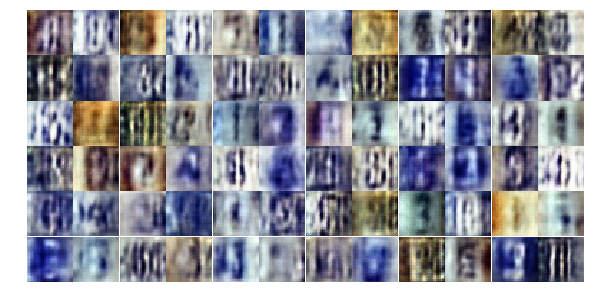

Epoch 3/25... Discriminator Loss: 1.2036... Generator Loss: 0.5239
Epoch 3/25... Discriminator Loss: 0.8577... Generator Loss: 2.5771
Epoch 3/25... Discriminator Loss: 0.6447... Generator Loss: 1.3742
Epoch 3/25... Discriminator Loss: 0.5527... Generator Loss: 1.7513
Epoch 3/25... Discriminator Loss: 0.7109... Generator Loss: 2.5419
Epoch 3/25... Discriminator Loss: 0.9913... Generator Loss: 0.6930
Epoch 3/25... Discriminator Loss: 0.9828... Generator Loss: 0.7571
Epoch 3/25... Discriminator Loss: 0.5845... Generator Loss: 1.8226
Epoch 3/25... Discriminator Loss: 0.5344... Generator Loss: 1.3965
Epoch 3/25... Discriminator Loss: 0.4238... Generator Loss: 1.8967


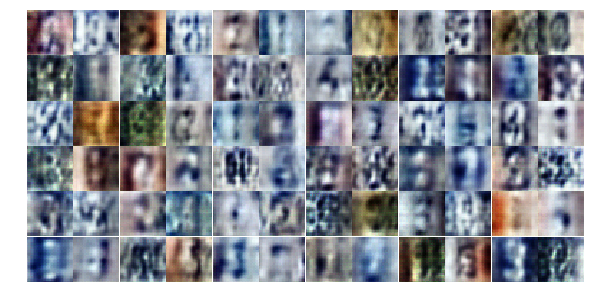

Epoch 3/25... Discriminator Loss: 1.3046... Generator Loss: 0.4500
Epoch 4/25... Discriminator Loss: 0.7515... Generator Loss: 1.1558
Epoch 4/25... Discriminator Loss: 0.7273... Generator Loss: 0.9168
Epoch 4/25... Discriminator Loss: 1.0068... Generator Loss: 0.5738
Epoch 4/25... Discriminator Loss: 0.4463... Generator Loss: 1.7415
Epoch 4/25... Discriminator Loss: 0.3909... Generator Loss: 1.6665
Epoch 4/25... Discriminator Loss: 1.1568... Generator Loss: 0.6700
Epoch 4/25... Discriminator Loss: 0.6208... Generator Loss: 1.7939
Epoch 4/25... Discriminator Loss: 0.6897... Generator Loss: 1.1072
Epoch 4/25... Discriminator Loss: 0.6077... Generator Loss: 1.3234


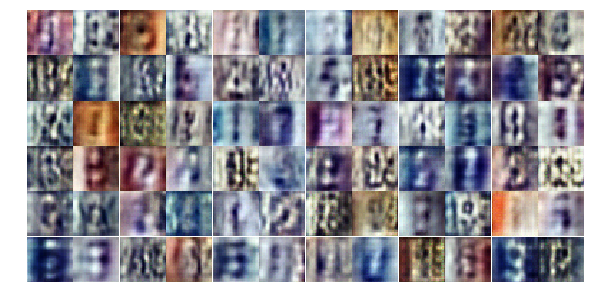

Epoch 4/25... Discriminator Loss: 0.7409... Generator Loss: 3.3212
Epoch 4/25... Discriminator Loss: 1.6438... Generator Loss: 2.6930
Epoch 4/25... Discriminator Loss: 0.9910... Generator Loss: 0.8789
Epoch 4/25... Discriminator Loss: 0.5854... Generator Loss: 1.2263
Epoch 4/25... Discriminator Loss: 0.6307... Generator Loss: 1.7943
Epoch 4/25... Discriminator Loss: 0.6521... Generator Loss: 1.0871
Epoch 4/25... Discriminator Loss: 0.6799... Generator Loss: 1.0770
Epoch 4/25... Discriminator Loss: 0.7607... Generator Loss: 0.8233
Epoch 4/25... Discriminator Loss: 0.6148... Generator Loss: 1.1153
Epoch 4/25... Discriminator Loss: 0.5880... Generator Loss: 1.7900


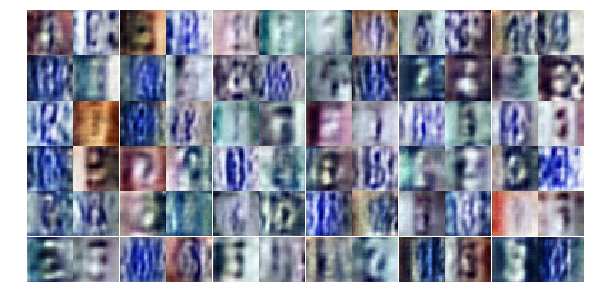

Epoch 4/25... Discriminator Loss: 0.7576... Generator Loss: 1.0310
Epoch 4/25... Discriminator Loss: 0.6062... Generator Loss: 1.3324
Epoch 4/25... Discriminator Loss: 0.6474... Generator Loss: 1.6028
Epoch 4/25... Discriminator Loss: 0.5388... Generator Loss: 1.4036
Epoch 4/25... Discriminator Loss: 0.5360... Generator Loss: 2.8337
Epoch 4/25... Discriminator Loss: 0.8420... Generator Loss: 3.0089
Epoch 4/25... Discriminator Loss: 1.0903... Generator Loss: 0.6220
Epoch 4/25... Discriminator Loss: 0.7563... Generator Loss: 1.0494
Epoch 4/25... Discriminator Loss: 0.4763... Generator Loss: 1.5149
Epoch 4/25... Discriminator Loss: 0.7328... Generator Loss: 2.0494


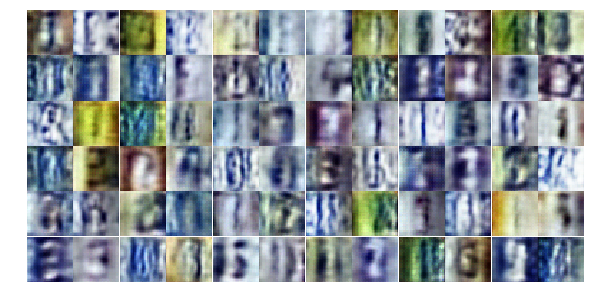

Epoch 4/25... Discriminator Loss: 0.5438... Generator Loss: 1.3963
Epoch 4/25... Discriminator Loss: 0.7249... Generator Loss: 1.2763
Epoch 4/25... Discriminator Loss: 0.6930... Generator Loss: 1.6510
Epoch 4/25... Discriminator Loss: 0.5789... Generator Loss: 1.6420
Epoch 4/25... Discriminator Loss: 0.5598... Generator Loss: 2.7885
Epoch 4/25... Discriminator Loss: 0.6755... Generator Loss: 1.1649
Epoch 4/25... Discriminator Loss: 0.4648... Generator Loss: 1.8009
Epoch 4/25... Discriminator Loss: 0.5361... Generator Loss: 1.5493
Epoch 4/25... Discriminator Loss: 0.4801... Generator Loss: 1.5390
Epoch 4/25... Discriminator Loss: 0.6140... Generator Loss: 1.2178


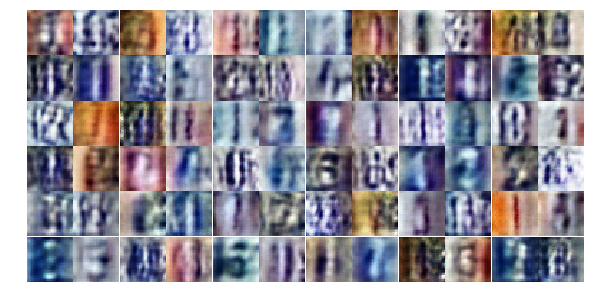

Epoch 4/25... Discriminator Loss: 0.5296... Generator Loss: 1.7665
Epoch 4/25... Discriminator Loss: 0.6308... Generator Loss: 1.0303
Epoch 4/25... Discriminator Loss: 0.4618... Generator Loss: 1.5881
Epoch 4/25... Discriminator Loss: 0.5891... Generator Loss: 1.1831
Epoch 4/25... Discriminator Loss: 0.3057... Generator Loss: 2.2288
Epoch 4/25... Discriminator Loss: 0.9700... Generator Loss: 0.7950
Epoch 4/25... Discriminator Loss: 0.6191... Generator Loss: 1.0463
Epoch 4/25... Discriminator Loss: 1.0535... Generator Loss: 1.7479
Epoch 4/25... Discriminator Loss: 0.6517... Generator Loss: 1.0974
Epoch 4/25... Discriminator Loss: 0.6667... Generator Loss: 1.8547


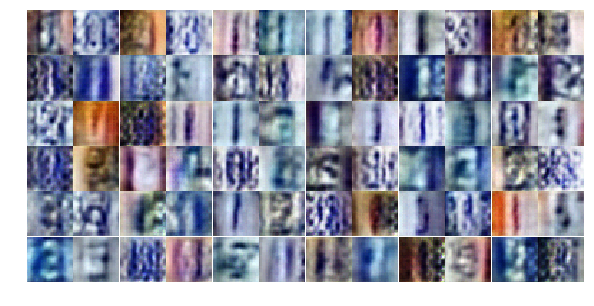

Epoch 4/25... Discriminator Loss: 0.5999... Generator Loss: 1.3093
Epoch 4/25... Discriminator Loss: 0.8031... Generator Loss: 2.0971
Epoch 4/25... Discriminator Loss: 0.5011... Generator Loss: 1.4499
Epoch 4/25... Discriminator Loss: 0.7223... Generator Loss: 2.1154
Epoch 4/25... Discriminator Loss: 0.6169... Generator Loss: 1.2735
Epoch 4/25... Discriminator Loss: 0.6002... Generator Loss: 1.5311
Epoch 4/25... Discriminator Loss: 0.8334... Generator Loss: 0.8655
Epoch 4/25... Discriminator Loss: 0.6392... Generator Loss: 1.4833
Epoch 4/25... Discriminator Loss: 0.5559... Generator Loss: 1.7058
Epoch 5/25... Discriminator Loss: 0.5028... Generator Loss: 1.7139


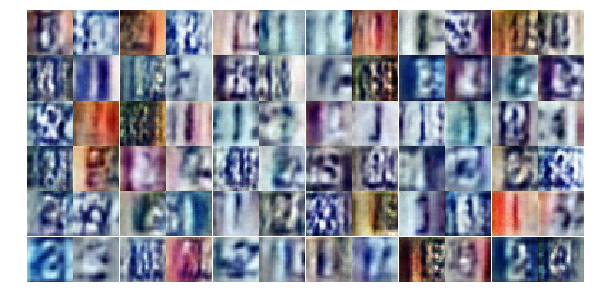

Epoch 5/25... Discriminator Loss: 0.6064... Generator Loss: 1.2676
Epoch 5/25... Discriminator Loss: 0.5370... Generator Loss: 1.5523
Epoch 5/25... Discriminator Loss: 0.5984... Generator Loss: 1.3337
Epoch 5/25... Discriminator Loss: 0.3215... Generator Loss: 1.8703
Epoch 5/25... Discriminator Loss: 0.4179... Generator Loss: 1.5842
Epoch 5/25... Discriminator Loss: 0.8203... Generator Loss: 0.8004
Epoch 5/25... Discriminator Loss: 0.6578... Generator Loss: 2.3091
Epoch 5/25... Discriminator Loss: 0.4737... Generator Loss: 1.9743
Epoch 5/25... Discriminator Loss: 0.5643... Generator Loss: 1.3633
Epoch 5/25... Discriminator Loss: 0.7014... Generator Loss: 1.2055


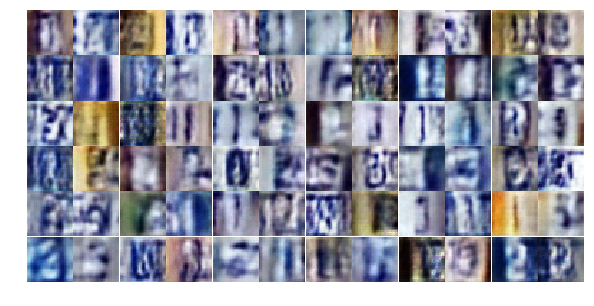

Epoch 5/25... Discriminator Loss: 0.6919... Generator Loss: 2.3251
Epoch 5/25... Discriminator Loss: 0.3977... Generator Loss: 1.9663
Epoch 5/25... Discriminator Loss: 0.6016... Generator Loss: 1.8862
Epoch 5/25... Discriminator Loss: 1.6420... Generator Loss: 0.3472
Epoch 5/25... Discriminator Loss: 0.7047... Generator Loss: 1.2902
Epoch 5/25... Discriminator Loss: 0.8102... Generator Loss: 1.0606
Epoch 5/25... Discriminator Loss: 0.6060... Generator Loss: 1.1922
Epoch 5/25... Discriminator Loss: 0.4811... Generator Loss: 1.5178
Epoch 5/25... Discriminator Loss: 0.5328... Generator Loss: 1.3541
Epoch 5/25... Discriminator Loss: 0.4035... Generator Loss: 1.9908


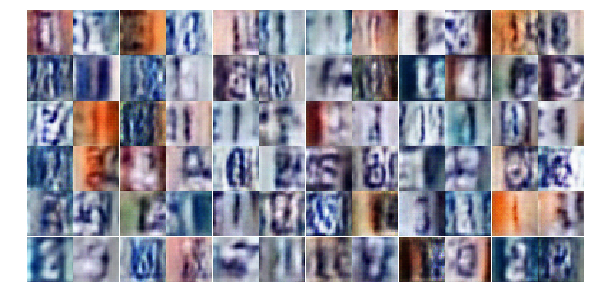

Epoch 5/25... Discriminator Loss: 0.4548... Generator Loss: 1.3958
Epoch 5/25... Discriminator Loss: 0.6203... Generator Loss: 1.3277
Epoch 5/25... Discriminator Loss: 0.4968... Generator Loss: 2.0851
Epoch 5/25... Discriminator Loss: 0.7629... Generator Loss: 1.1300
Epoch 5/25... Discriminator Loss: 1.0592... Generator Loss: 0.5827
Epoch 5/25... Discriminator Loss: 0.5550... Generator Loss: 1.2522
Epoch 5/25... Discriminator Loss: 0.7609... Generator Loss: 0.8620
Epoch 5/25... Discriminator Loss: 0.5316... Generator Loss: 1.4837
Epoch 5/25... Discriminator Loss: 0.6526... Generator Loss: 1.2655
Epoch 5/25... Discriminator Loss: 0.3627... Generator Loss: 1.8621


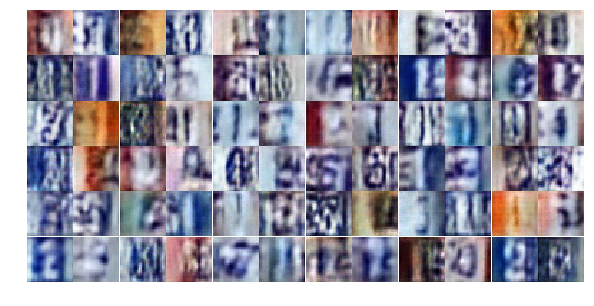

Epoch 5/25... Discriminator Loss: 0.5537... Generator Loss: 1.7752
Epoch 5/25... Discriminator Loss: 0.5230... Generator Loss: 1.2440
Epoch 5/25... Discriminator Loss: 0.4935... Generator Loss: 1.6912
Epoch 5/25... Discriminator Loss: 0.3805... Generator Loss: 1.6330
Epoch 5/25... Discriminator Loss: 1.4896... Generator Loss: 4.2137
Epoch 5/25... Discriminator Loss: 0.5642... Generator Loss: 1.5268
Epoch 5/25... Discriminator Loss: 0.7301... Generator Loss: 1.1788
Epoch 5/25... Discriminator Loss: 0.6270... Generator Loss: 1.2499
Epoch 5/25... Discriminator Loss: 0.6642... Generator Loss: 1.0087
Epoch 5/25... Discriminator Loss: 0.8145... Generator Loss: 0.9024


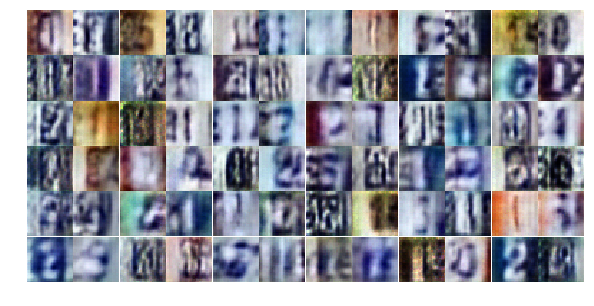

Epoch 5/25... Discriminator Loss: 0.3252... Generator Loss: 2.3787
Epoch 5/25... Discriminator Loss: 0.8168... Generator Loss: 0.7686
Epoch 5/25... Discriminator Loss: 1.2769... Generator Loss: 0.5130
Epoch 5/25... Discriminator Loss: 0.4464... Generator Loss: 1.6811
Epoch 5/25... Discriminator Loss: 0.8990... Generator Loss: 2.8127
Epoch 5/25... Discriminator Loss: 0.7858... Generator Loss: 1.7335
Epoch 5/25... Discriminator Loss: 0.8702... Generator Loss: 0.8377
Epoch 5/25... Discriminator Loss: 0.7375... Generator Loss: 3.0972
Epoch 5/25... Discriminator Loss: 1.6291... Generator Loss: 0.3634
Epoch 5/25... Discriminator Loss: 0.6037... Generator Loss: 1.1703


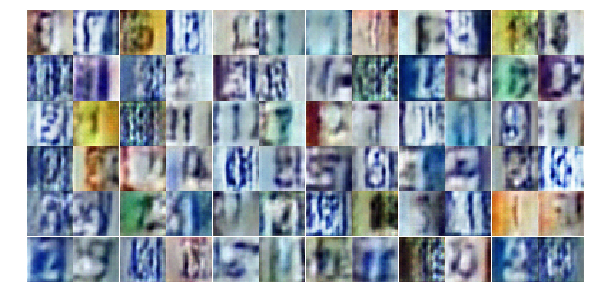

Epoch 5/25... Discriminator Loss: 1.0326... Generator Loss: 0.6598
Epoch 5/25... Discriminator Loss: 0.8422... Generator Loss: 0.7943
Epoch 5/25... Discriminator Loss: 0.7567... Generator Loss: 0.9620
Epoch 5/25... Discriminator Loss: 0.4802... Generator Loss: 1.2632
Epoch 5/25... Discriminator Loss: 0.4801... Generator Loss: 1.5628
Epoch 5/25... Discriminator Loss: 0.7240... Generator Loss: 1.0323
Epoch 6/25... Discriminator Loss: 0.7749... Generator Loss: 0.7995
Epoch 6/25... Discriminator Loss: 0.4986... Generator Loss: 1.2719
Epoch 6/25... Discriminator Loss: 2.0063... Generator Loss: 0.2271
Epoch 6/25... Discriminator Loss: 0.7290... Generator Loss: 1.1135


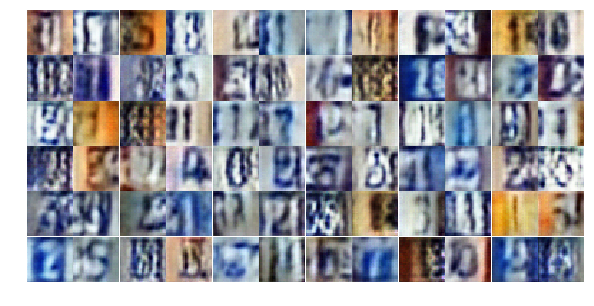

Epoch 6/25... Discriminator Loss: 0.5690... Generator Loss: 1.2100
Epoch 6/25... Discriminator Loss: 0.6557... Generator Loss: 1.3324
Epoch 6/25... Discriminator Loss: 0.7066... Generator Loss: 1.1447
Epoch 6/25... Discriminator Loss: 0.7734... Generator Loss: 1.2114
Epoch 6/25... Discriminator Loss: 0.6223... Generator Loss: 1.1898
Epoch 6/25... Discriminator Loss: 0.7163... Generator Loss: 0.8645
Epoch 6/25... Discriminator Loss: 0.5286... Generator Loss: 1.5735
Epoch 6/25... Discriminator Loss: 0.8986... Generator Loss: 0.6883
Epoch 6/25... Discriminator Loss: 0.8596... Generator Loss: 0.7391
Epoch 6/25... Discriminator Loss: 0.5541... Generator Loss: 1.2660


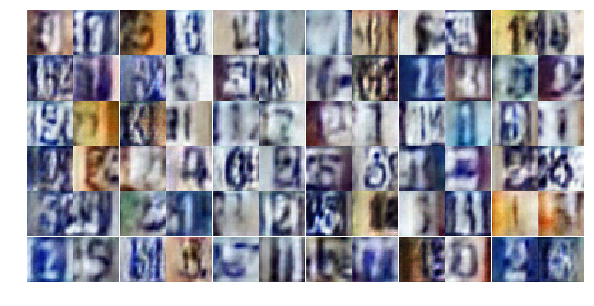

Epoch 6/25... Discriminator Loss: 0.6308... Generator Loss: 1.9642
Epoch 6/25... Discriminator Loss: 0.9000... Generator Loss: 1.1895
Epoch 6/25... Discriminator Loss: 0.7136... Generator Loss: 0.9136
Epoch 6/25... Discriminator Loss: 0.4848... Generator Loss: 1.2996
Epoch 6/25... Discriminator Loss: 0.6216... Generator Loss: 2.3974
Epoch 6/25... Discriminator Loss: 0.4828... Generator Loss: 1.4276
Epoch 6/25... Discriminator Loss: 0.6990... Generator Loss: 1.0417
Epoch 6/25... Discriminator Loss: 1.5257... Generator Loss: 0.3747
Epoch 6/25... Discriminator Loss: 1.0322... Generator Loss: 2.5085
Epoch 6/25... Discriminator Loss: 0.9326... Generator Loss: 0.7092


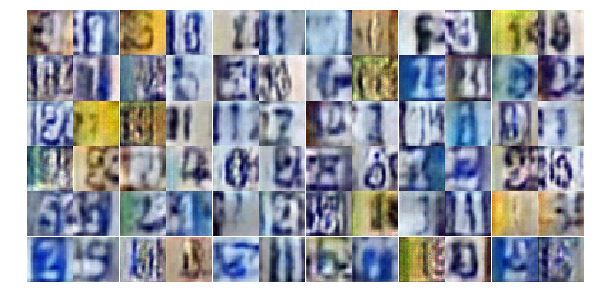

Epoch 6/25... Discriminator Loss: 0.5955... Generator Loss: 1.1665
Epoch 6/25... Discriminator Loss: 0.7021... Generator Loss: 0.9821
Epoch 6/25... Discriminator Loss: 0.6953... Generator Loss: 1.0157
Epoch 6/25... Discriminator Loss: 0.8027... Generator Loss: 0.8014
Epoch 6/25... Discriminator Loss: 0.4303... Generator Loss: 2.1805
Epoch 6/25... Discriminator Loss: 2.2559... Generator Loss: 0.2226
Epoch 6/25... Discriminator Loss: 0.9797... Generator Loss: 1.1096
Epoch 6/25... Discriminator Loss: 0.5248... Generator Loss: 1.4685
Epoch 6/25... Discriminator Loss: 0.9300... Generator Loss: 0.7284
Epoch 6/25... Discriminator Loss: 0.5827... Generator Loss: 1.4703


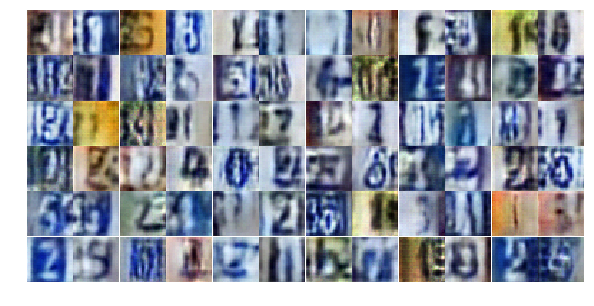

Epoch 6/25... Discriminator Loss: 0.6924... Generator Loss: 0.9916
Epoch 6/25... Discriminator Loss: 0.6357... Generator Loss: 1.2497
Epoch 6/25... Discriminator Loss: 1.1118... Generator Loss: 0.5717
Epoch 6/25... Discriminator Loss: 0.6698... Generator Loss: 1.0876
Epoch 6/25... Discriminator Loss: 0.9180... Generator Loss: 0.7595
Epoch 6/25... Discriminator Loss: 0.5791... Generator Loss: 1.0882
Epoch 6/25... Discriminator Loss: 0.6008... Generator Loss: 1.1638
Epoch 6/25... Discriminator Loss: 0.5931... Generator Loss: 1.2270
Epoch 6/25... Discriminator Loss: 0.8582... Generator Loss: 0.7663
Epoch 6/25... Discriminator Loss: 0.5181... Generator Loss: 1.4003


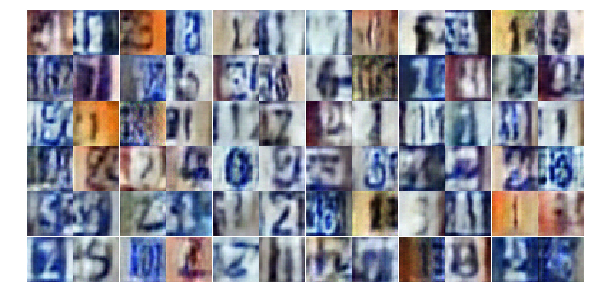

Epoch 6/25... Discriminator Loss: 0.6890... Generator Loss: 1.6860
Epoch 6/25... Discriminator Loss: 1.3096... Generator Loss: 0.4193
Epoch 6/25... Discriminator Loss: 0.8509... Generator Loss: 0.9803
Epoch 6/25... Discriminator Loss: 0.5247... Generator Loss: 1.6740
Epoch 6/25... Discriminator Loss: 0.5584... Generator Loss: 1.2115
Epoch 6/25... Discriminator Loss: 0.5865... Generator Loss: 1.1268
Epoch 6/25... Discriminator Loss: 1.0717... Generator Loss: 0.5824
Epoch 6/25... Discriminator Loss: 1.2462... Generator Loss: 0.4571
Epoch 6/25... Discriminator Loss: 0.6611... Generator Loss: 1.2214
Epoch 6/25... Discriminator Loss: 2.0065... Generator Loss: 0.2055


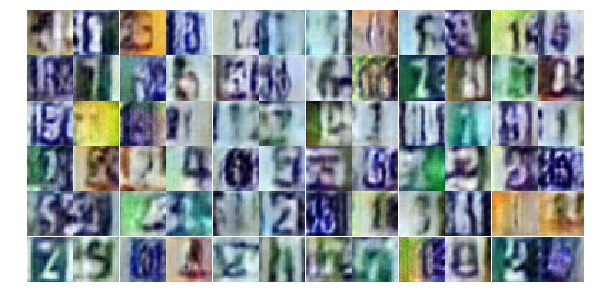

Epoch 6/25... Discriminator Loss: 0.6524... Generator Loss: 1.0916
Epoch 6/25... Discriminator Loss: 0.9413... Generator Loss: 0.6499
Epoch 6/25... Discriminator Loss: 0.5034... Generator Loss: 1.7249
Epoch 7/25... Discriminator Loss: 0.6159... Generator Loss: 1.1843
Epoch 7/25... Discriminator Loss: 0.4529... Generator Loss: 1.7423
Epoch 7/25... Discriminator Loss: 0.6668... Generator Loss: 1.1706
Epoch 7/25... Discriminator Loss: 0.5387... Generator Loss: 1.2178
Epoch 7/25... Discriminator Loss: 0.6242... Generator Loss: 1.4844
Epoch 7/25... Discriminator Loss: 0.5629... Generator Loss: 1.2370
Epoch 7/25... Discriminator Loss: 0.7514... Generator Loss: 1.0007


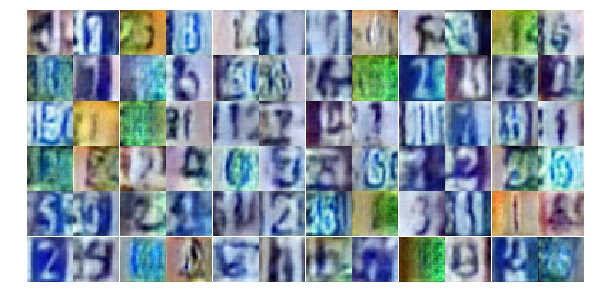

Epoch 7/25... Discriminator Loss: 0.5989... Generator Loss: 1.4096
Epoch 7/25... Discriminator Loss: 0.8841... Generator Loss: 0.7117
Epoch 7/25... Discriminator Loss: 1.0031... Generator Loss: 0.9985
Epoch 7/25... Discriminator Loss: 0.5424... Generator Loss: 2.2174
Epoch 7/25... Discriminator Loss: 0.6441... Generator Loss: 1.4755
Epoch 7/25... Discriminator Loss: 0.6940... Generator Loss: 0.9997
Epoch 7/25... Discriminator Loss: 0.8980... Generator Loss: 2.8759
Epoch 7/25... Discriminator Loss: 0.9024... Generator Loss: 2.1828
Epoch 7/25... Discriminator Loss: 0.6424... Generator Loss: 2.0790
Epoch 7/25... Discriminator Loss: 0.6582... Generator Loss: 1.0718


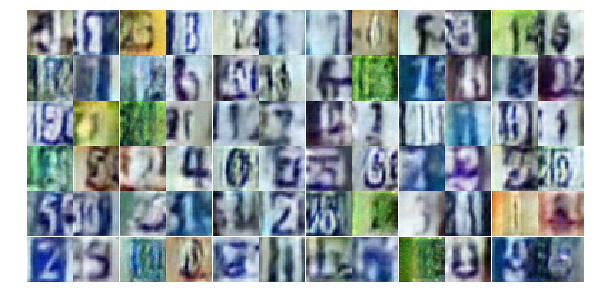

Epoch 7/25... Discriminator Loss: 0.7345... Generator Loss: 1.0129
Epoch 7/25... Discriminator Loss: 0.6288... Generator Loss: 1.3116
Epoch 7/25... Discriminator Loss: 0.6473... Generator Loss: 1.0623
Epoch 7/25... Discriminator Loss: 0.4723... Generator Loss: 1.5551
Epoch 7/25... Discriminator Loss: 0.5494... Generator Loss: 1.8140
Epoch 7/25... Discriminator Loss: 0.6302... Generator Loss: 2.3805
Epoch 7/25... Discriminator Loss: 0.8153... Generator Loss: 0.8581
Epoch 7/25... Discriminator Loss: 0.8269... Generator Loss: 0.7988
Epoch 7/25... Discriminator Loss: 0.3650... Generator Loss: 1.7642
Epoch 7/25... Discriminator Loss: 0.4940... Generator Loss: 2.1092


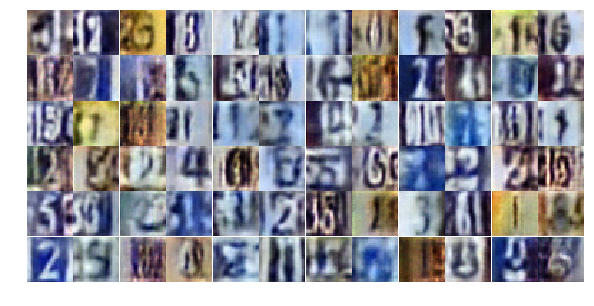

Epoch 7/25... Discriminator Loss: 0.9594... Generator Loss: 0.6635
Epoch 7/25... Discriminator Loss: 1.1290... Generator Loss: 0.5518
Epoch 7/25... Discriminator Loss: 0.6155... Generator Loss: 1.1669
Epoch 7/25... Discriminator Loss: 0.7000... Generator Loss: 1.3080
Epoch 7/25... Discriminator Loss: 0.7328... Generator Loss: 1.6197
Epoch 7/25... Discriminator Loss: 0.8573... Generator Loss: 0.8176
Epoch 7/25... Discriminator Loss: 0.9248... Generator Loss: 0.6608
Epoch 7/25... Discriminator Loss: 0.5044... Generator Loss: 1.4277
Epoch 7/25... Discriminator Loss: 1.0082... Generator Loss: 0.6151
Epoch 7/25... Discriminator Loss: 0.8024... Generator Loss: 2.8265


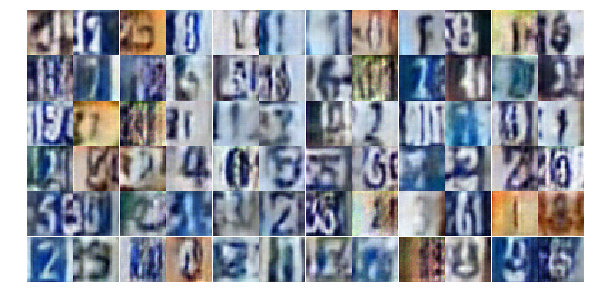

Epoch 7/25... Discriminator Loss: 1.1028... Generator Loss: 0.5762
Epoch 7/25... Discriminator Loss: 1.0433... Generator Loss: 1.7984
Epoch 7/25... Discriminator Loss: 0.4516... Generator Loss: 1.6188
Epoch 7/25... Discriminator Loss: 0.6809... Generator Loss: 1.6156
Epoch 7/25... Discriminator Loss: 0.6164... Generator Loss: 1.4352
Epoch 7/25... Discriminator Loss: 0.5131... Generator Loss: 1.2536
Epoch 7/25... Discriminator Loss: 0.4485... Generator Loss: 1.7217
Epoch 7/25... Discriminator Loss: 1.0903... Generator Loss: 2.5320
Epoch 7/25... Discriminator Loss: 0.3133... Generator Loss: 2.6747
Epoch 7/25... Discriminator Loss: 0.7448... Generator Loss: 1.9910


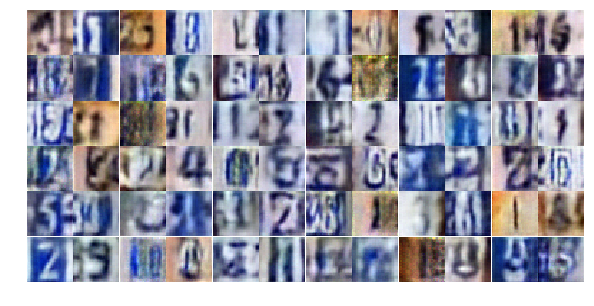

Epoch 7/25... Discriminator Loss: 0.3088... Generator Loss: 2.0734
Epoch 7/25... Discriminator Loss: 0.5146... Generator Loss: 1.9628
Epoch 7/25... Discriminator Loss: 0.9468... Generator Loss: 2.9426
Epoch 7/25... Discriminator Loss: 1.4366... Generator Loss: 0.3981
Epoch 7/25... Discriminator Loss: 1.0569... Generator Loss: 0.6280
Epoch 7/25... Discriminator Loss: 0.6993... Generator Loss: 1.7547
Epoch 7/25... Discriminator Loss: 1.2643... Generator Loss: 0.4516
Epoch 7/25... Discriminator Loss: 0.8844... Generator Loss: 0.9221
Epoch 7/25... Discriminator Loss: 0.6807... Generator Loss: 1.5965
Epoch 7/25... Discriminator Loss: 0.5836... Generator Loss: 1.5018


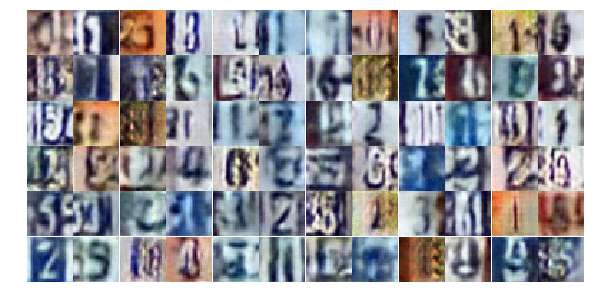

Epoch 7/25... Discriminator Loss: 0.5382... Generator Loss: 1.7741
Epoch 8/25... Discriminator Loss: 0.5938... Generator Loss: 1.4873
Epoch 8/25... Discriminator Loss: 0.6325... Generator Loss: 1.1653
Epoch 8/25... Discriminator Loss: 0.6820... Generator Loss: 0.9972
Epoch 8/25... Discriminator Loss: 0.8157... Generator Loss: 0.9914
Epoch 8/25... Discriminator Loss: 0.9205... Generator Loss: 1.3048
Epoch 8/25... Discriminator Loss: 0.8446... Generator Loss: 0.8135
Epoch 8/25... Discriminator Loss: 0.5551... Generator Loss: 1.7241
Epoch 8/25... Discriminator Loss: 1.0822... Generator Loss: 1.8994
Epoch 8/25... Discriminator Loss: 0.5292... Generator Loss: 1.4293


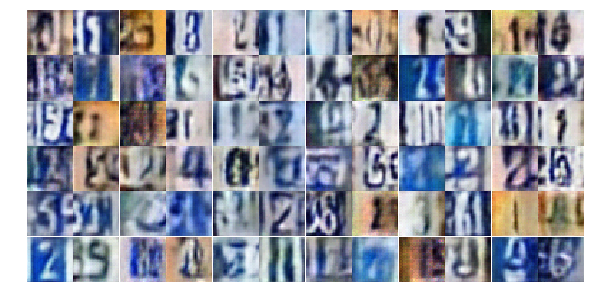

Epoch 8/25... Discriminator Loss: 0.5424... Generator Loss: 1.3178
Epoch 8/25... Discriminator Loss: 0.4049... Generator Loss: 1.5021
Epoch 8/25... Discriminator Loss: 0.6985... Generator Loss: 1.2643
Epoch 8/25... Discriminator Loss: 1.0552... Generator Loss: 0.7175
Epoch 8/25... Discriminator Loss: 0.7205... Generator Loss: 1.2329
Epoch 8/25... Discriminator Loss: 1.0142... Generator Loss: 2.2435
Epoch 8/25... Discriminator Loss: 0.6101... Generator Loss: 1.3941
Epoch 8/25... Discriminator Loss: 0.7035... Generator Loss: 1.1253
Epoch 8/25... Discriminator Loss: 0.7862... Generator Loss: 0.8654
Epoch 8/25... Discriminator Loss: 1.4555... Generator Loss: 0.3587


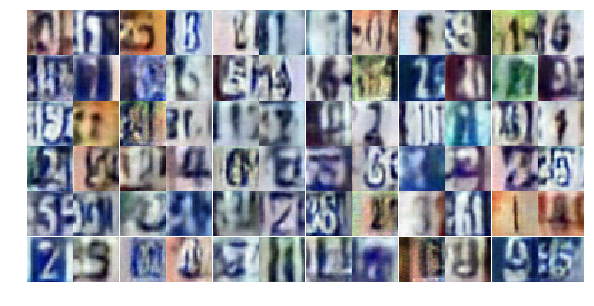

Epoch 8/25... Discriminator Loss: 0.5240... Generator Loss: 1.5022
Epoch 8/25... Discriminator Loss: 0.5950... Generator Loss: 1.0769
Epoch 8/25... Discriminator Loss: 0.8871... Generator Loss: 0.8437
Epoch 8/25... Discriminator Loss: 0.8244... Generator Loss: 2.3499
Epoch 8/25... Discriminator Loss: 0.3782... Generator Loss: 1.8140
Epoch 8/25... Discriminator Loss: 0.6381... Generator Loss: 1.2673
Epoch 8/25... Discriminator Loss: 0.7470... Generator Loss: 0.8922
Epoch 8/25... Discriminator Loss: 0.5717... Generator Loss: 1.4536
Epoch 8/25... Discriminator Loss: 0.7098... Generator Loss: 1.6112
Epoch 8/25... Discriminator Loss: 0.6008... Generator Loss: 1.2257


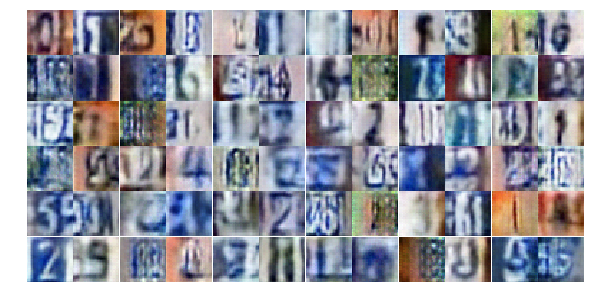

Epoch 8/25... Discriminator Loss: 0.6136... Generator Loss: 1.5076
Epoch 8/25... Discriminator Loss: 1.0631... Generator Loss: 0.5730
Epoch 8/25... Discriminator Loss: 0.6747... Generator Loss: 1.0722
Epoch 8/25... Discriminator Loss: 0.9570... Generator Loss: 0.6891
Epoch 8/25... Discriminator Loss: 1.4570... Generator Loss: 0.3860
Epoch 8/25... Discriminator Loss: 0.5640... Generator Loss: 1.1559
Epoch 8/25... Discriminator Loss: 0.6216... Generator Loss: 1.4441
Epoch 8/25... Discriminator Loss: 0.6411... Generator Loss: 1.1275
Epoch 8/25... Discriminator Loss: 0.6411... Generator Loss: 1.8164
Epoch 8/25... Discriminator Loss: 0.4676... Generator Loss: 1.6521


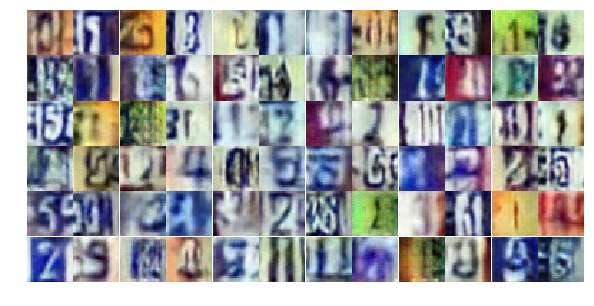

Epoch 8/25... Discriminator Loss: 0.5750... Generator Loss: 1.8525
Epoch 8/25... Discriminator Loss: 1.1910... Generator Loss: 0.5764
Epoch 8/25... Discriminator Loss: 0.5977... Generator Loss: 1.0531
Epoch 8/25... Discriminator Loss: 0.8370... Generator Loss: 0.7319
Epoch 8/25... Discriminator Loss: 0.7087... Generator Loss: 1.9816
Epoch 8/25... Discriminator Loss: 0.4004... Generator Loss: 1.5778
Epoch 8/25... Discriminator Loss: 0.4666... Generator Loss: 1.2550
Epoch 8/25... Discriminator Loss: 0.7714... Generator Loss: 0.8968
Epoch 8/25... Discriminator Loss: 0.5541... Generator Loss: 1.2275
Epoch 8/25... Discriminator Loss: 0.8079... Generator Loss: 1.7243


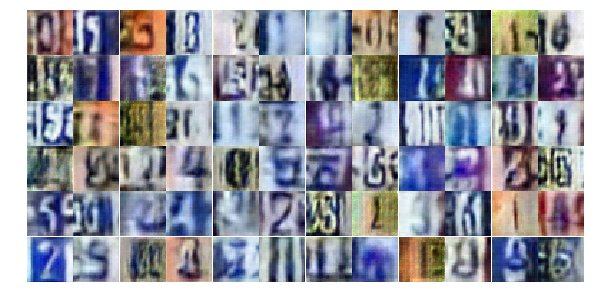

Epoch 8/25... Discriminator Loss: 0.5513... Generator Loss: 1.2937
Epoch 8/25... Discriminator Loss: 0.6183... Generator Loss: 1.0795
Epoch 8/25... Discriminator Loss: 0.5277... Generator Loss: 1.5303
Epoch 8/25... Discriminator Loss: 0.8611... Generator Loss: 0.7361
Epoch 8/25... Discriminator Loss: 0.3337... Generator Loss: 1.9684
Epoch 8/25... Discriminator Loss: 0.9089... Generator Loss: 0.7630
Epoch 8/25... Discriminator Loss: 0.4707... Generator Loss: 1.2875
Epoch 8/25... Discriminator Loss: 0.5185... Generator Loss: 1.6378
Epoch 9/25... Discriminator Loss: 1.7883... Generator Loss: 0.2831
Epoch 9/25... Discriminator Loss: 0.7717... Generator Loss: 0.9447


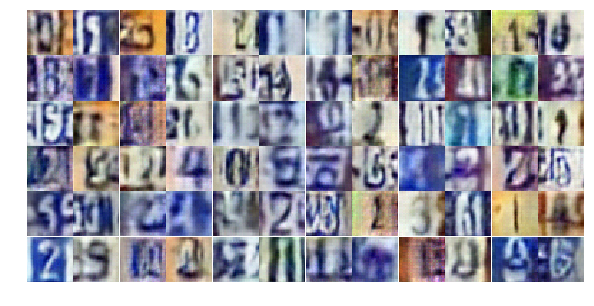

Epoch 9/25... Discriminator Loss: 0.9365... Generator Loss: 0.7177
Epoch 9/25... Discriminator Loss: 0.6559... Generator Loss: 1.0847
Epoch 9/25... Discriminator Loss: 1.1949... Generator Loss: 0.5599
Epoch 9/25... Discriminator Loss: 0.5407... Generator Loss: 1.5148
Epoch 9/25... Discriminator Loss: 0.8832... Generator Loss: 0.7444
Epoch 9/25... Discriminator Loss: 0.6964... Generator Loss: 2.2260
Epoch 9/25... Discriminator Loss: 0.5845... Generator Loss: 1.4674
Epoch 9/25... Discriminator Loss: 0.5649... Generator Loss: 1.1162
Epoch 9/25... Discriminator Loss: 0.7071... Generator Loss: 0.9669
Epoch 9/25... Discriminator Loss: 0.6335... Generator Loss: 1.5622


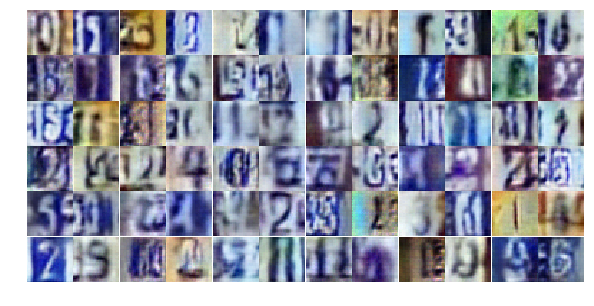

Epoch 9/25... Discriminator Loss: 0.8167... Generator Loss: 0.8288
Epoch 9/25... Discriminator Loss: 0.9690... Generator Loss: 0.7581
Epoch 9/25... Discriminator Loss: 0.7424... Generator Loss: 0.9517
Epoch 9/25... Discriminator Loss: 2.7778... Generator Loss: 0.1064
Epoch 9/25... Discriminator Loss: 0.4439... Generator Loss: 1.5220
Epoch 9/25... Discriminator Loss: 1.1008... Generator Loss: 0.5526
Epoch 9/25... Discriminator Loss: 1.0039... Generator Loss: 0.6327
Epoch 9/25... Discriminator Loss: 0.5188... Generator Loss: 1.3309
Epoch 9/25... Discriminator Loss: 0.7259... Generator Loss: 0.9781
Epoch 9/25... Discriminator Loss: 0.9442... Generator Loss: 0.6869


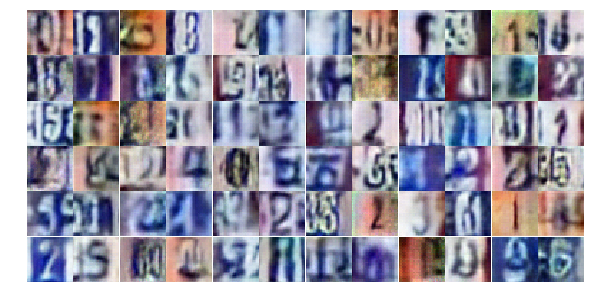

Epoch 9/25... Discriminator Loss: 1.2338... Generator Loss: 0.5278
Epoch 9/25... Discriminator Loss: 0.7906... Generator Loss: 0.8391
Epoch 9/25... Discriminator Loss: 0.6313... Generator Loss: 1.3441
Epoch 9/25... Discriminator Loss: 0.7351... Generator Loss: 0.9302
Epoch 9/25... Discriminator Loss: 0.6080... Generator Loss: 1.1077
Epoch 9/25... Discriminator Loss: 0.4839... Generator Loss: 1.4966
Epoch 9/25... Discriminator Loss: 1.8188... Generator Loss: 0.2504
Epoch 9/25... Discriminator Loss: 0.4933... Generator Loss: 1.6053
Epoch 9/25... Discriminator Loss: 0.5737... Generator Loss: 1.2010
Epoch 9/25... Discriminator Loss: 0.7747... Generator Loss: 0.8718


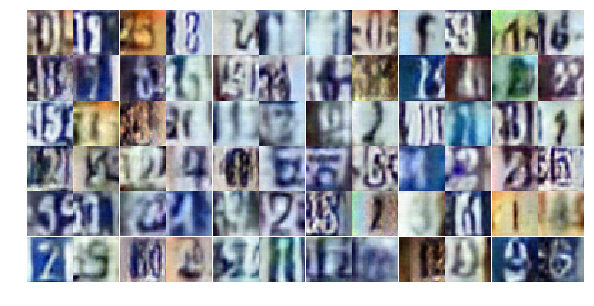

Epoch 9/25... Discriminator Loss: 0.5080... Generator Loss: 1.2823
Epoch 9/25... Discriminator Loss: 0.5138... Generator Loss: 1.3026
Epoch 9/25... Discriminator Loss: 1.1141... Generator Loss: 0.5400
Epoch 9/25... Discriminator Loss: 0.6236... Generator Loss: 1.4778
Epoch 9/25... Discriminator Loss: 0.7252... Generator Loss: 0.9746
Epoch 9/25... Discriminator Loss: 0.6766... Generator Loss: 1.1079
Epoch 9/25... Discriminator Loss: 0.6088... Generator Loss: 1.7768
Epoch 9/25... Discriminator Loss: 0.4243... Generator Loss: 1.3874
Epoch 9/25... Discriminator Loss: 0.6425... Generator Loss: 1.0234
Epoch 9/25... Discriminator Loss: 0.5632... Generator Loss: 1.1394


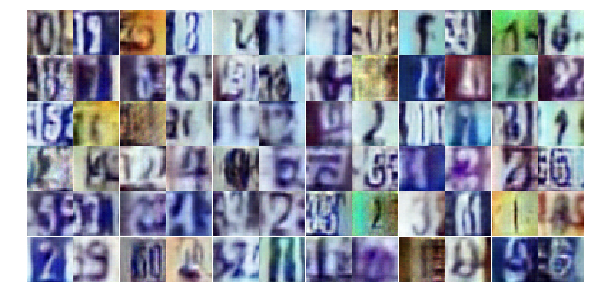

Epoch 9/25... Discriminator Loss: 0.6110... Generator Loss: 1.0814
Epoch 9/25... Discriminator Loss: 0.6949... Generator Loss: 0.9970
Epoch 9/25... Discriminator Loss: 1.4148... Generator Loss: 0.3890
Epoch 9/25... Discriminator Loss: 0.6539... Generator Loss: 1.2230
Epoch 9/25... Discriminator Loss: 0.3930... Generator Loss: 1.8902
Epoch 9/25... Discriminator Loss: 1.3858... Generator Loss: 0.4051
Epoch 9/25... Discriminator Loss: 0.6359... Generator Loss: 1.2435
Epoch 9/25... Discriminator Loss: 0.6374... Generator Loss: 1.0560
Epoch 9/25... Discriminator Loss: 0.4905... Generator Loss: 1.6995
Epoch 9/25... Discriminator Loss: 0.6473... Generator Loss: 2.7891


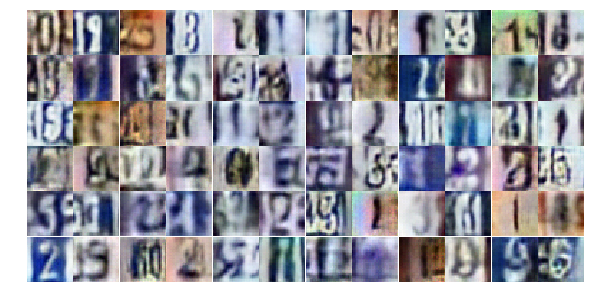

Epoch 9/25... Discriminator Loss: 2.2641... Generator Loss: 0.1510
Epoch 9/25... Discriminator Loss: 1.0884... Generator Loss: 2.8566
Epoch 9/25... Discriminator Loss: 0.5927... Generator Loss: 1.4619
Epoch 9/25... Discriminator Loss: 1.1636... Generator Loss: 0.5949
Epoch 9/25... Discriminator Loss: 0.5613... Generator Loss: 1.3005
Epoch 10/25... Discriminator Loss: 0.5303... Generator Loss: 1.4805
Epoch 10/25... Discriminator Loss: 0.6187... Generator Loss: 1.1715
Epoch 10/25... Discriminator Loss: 0.5775... Generator Loss: 1.3277
Epoch 10/25... Discriminator Loss: 0.7566... Generator Loss: 0.8734
Epoch 10/25... Discriminator Loss: 1.3516... Generator Loss: 0.3829


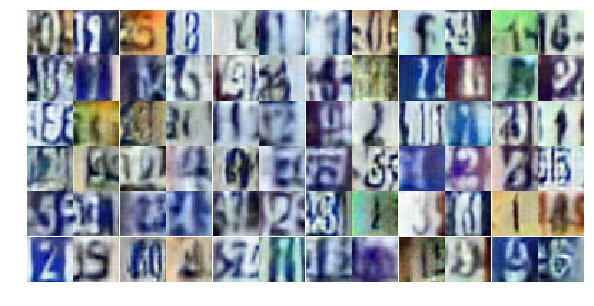

Epoch 10/25... Discriminator Loss: 0.7836... Generator Loss: 0.8504
Epoch 10/25... Discriminator Loss: 0.6955... Generator Loss: 1.0161
Epoch 10/25... Discriminator Loss: 0.6577... Generator Loss: 1.1018
Epoch 10/25... Discriminator Loss: 0.5661... Generator Loss: 1.6827
Epoch 10/25... Discriminator Loss: 0.5327... Generator Loss: 1.2329
Epoch 10/25... Discriminator Loss: 0.8068... Generator Loss: 1.3228
Epoch 10/25... Discriminator Loss: 0.6850... Generator Loss: 3.3151
Epoch 10/25... Discriminator Loss: 1.6764... Generator Loss: 0.3201
Epoch 10/25... Discriminator Loss: 0.6921... Generator Loss: 1.1197
Epoch 10/25... Discriminator Loss: 0.6782... Generator Loss: 1.2972


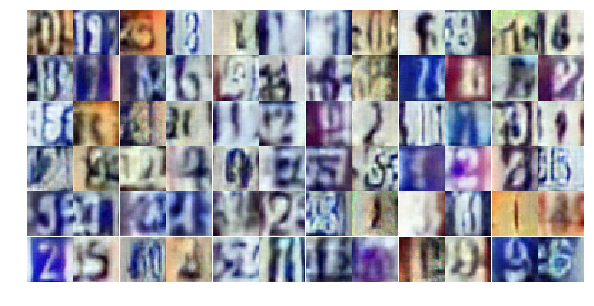

Epoch 10/25... Discriminator Loss: 1.0239... Generator Loss: 0.9749
Epoch 10/25... Discriminator Loss: 1.2134... Generator Loss: 0.5508
Epoch 10/25... Discriminator Loss: 0.9187... Generator Loss: 0.7938
Epoch 10/25... Discriminator Loss: 1.1693... Generator Loss: 0.5111
Epoch 10/25... Discriminator Loss: 0.7268... Generator Loss: 0.9430
Epoch 10/25... Discriminator Loss: 0.5715... Generator Loss: 1.2593
Epoch 10/25... Discriminator Loss: 0.5947... Generator Loss: 1.1417
Epoch 10/25... Discriminator Loss: 0.7264... Generator Loss: 2.0891
Epoch 10/25... Discriminator Loss: 0.7789... Generator Loss: 0.8523
Epoch 10/25... Discriminator Loss: 0.4904... Generator Loss: 2.4359


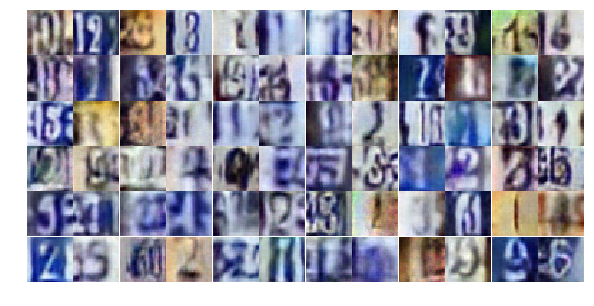

Epoch 10/25... Discriminator Loss: 1.0810... Generator Loss: 0.5391
Epoch 10/25... Discriminator Loss: 0.6168... Generator Loss: 1.3282
Epoch 10/25... Discriminator Loss: 0.3996... Generator Loss: 1.5992
Epoch 10/25... Discriminator Loss: 0.5371... Generator Loss: 2.2576
Epoch 10/25... Discriminator Loss: 1.4324... Generator Loss: 0.3750
Epoch 10/25... Discriminator Loss: 0.7074... Generator Loss: 1.0177
Epoch 10/25... Discriminator Loss: 0.3671... Generator Loss: 1.7004
Epoch 10/25... Discriminator Loss: 0.6804... Generator Loss: 1.6847
Epoch 10/25... Discriminator Loss: 0.6675... Generator Loss: 0.9908
Epoch 10/25... Discriminator Loss: 0.8650... Generator Loss: 1.9497


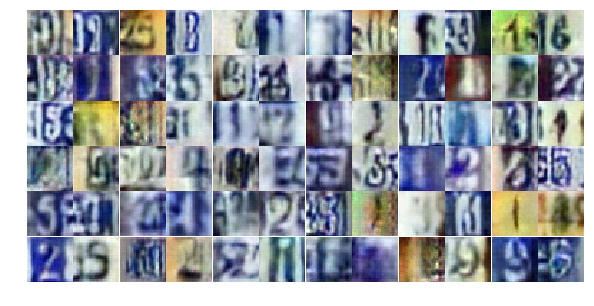

Epoch 10/25... Discriminator Loss: 0.7047... Generator Loss: 1.0097
Epoch 10/25... Discriminator Loss: 0.7271... Generator Loss: 0.9368
Epoch 10/25... Discriminator Loss: 0.6085... Generator Loss: 1.6538
Epoch 10/25... Discriminator Loss: 0.5464... Generator Loss: 1.4352
Epoch 10/25... Discriminator Loss: 0.8640... Generator Loss: 0.7396
Epoch 10/25... Discriminator Loss: 1.0724... Generator Loss: 0.5491
Epoch 10/25... Discriminator Loss: 0.8209... Generator Loss: 0.7837
Epoch 10/25... Discriminator Loss: 0.7102... Generator Loss: 1.0098
Epoch 10/25... Discriminator Loss: 0.9871... Generator Loss: 0.6391
Epoch 10/25... Discriminator Loss: 0.8188... Generator Loss: 2.5286


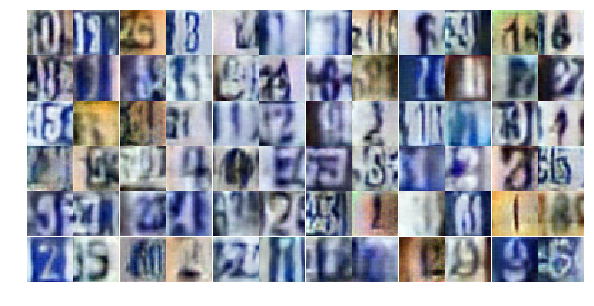

Epoch 10/25... Discriminator Loss: 1.8217... Generator Loss: 0.3201
Epoch 10/25... Discriminator Loss: 1.4587... Generator Loss: 0.7884
Epoch 10/25... Discriminator Loss: 0.8206... Generator Loss: 0.7985
Epoch 10/25... Discriminator Loss: 0.9506... Generator Loss: 0.7416
Epoch 10/25... Discriminator Loss: 0.5770... Generator Loss: 1.5848
Epoch 10/25... Discriminator Loss: 0.9049... Generator Loss: 0.7448
Epoch 10/25... Discriminator Loss: 0.5415... Generator Loss: 1.3204
Epoch 10/25... Discriminator Loss: 0.5378... Generator Loss: 1.3102
Epoch 10/25... Discriminator Loss: 0.5413... Generator Loss: 1.4632
Epoch 10/25... Discriminator Loss: 0.6043... Generator Loss: 1.5084


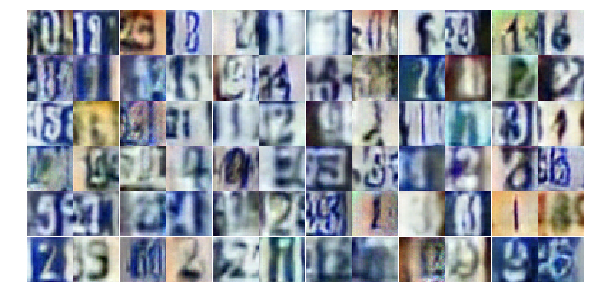

Epoch 10/25... Discriminator Loss: 0.6550... Generator Loss: 1.4229
Epoch 10/25... Discriminator Loss: 0.5767... Generator Loss: 1.3130
Epoch 10/25... Discriminator Loss: 0.4337... Generator Loss: 1.6344
Epoch 11/25... Discriminator Loss: 1.1492... Generator Loss: 0.5552
Epoch 11/25... Discriminator Loss: 0.8646... Generator Loss: 0.7895
Epoch 11/25... Discriminator Loss: 0.9770... Generator Loss: 0.6740
Epoch 11/25... Discriminator Loss: 0.9186... Generator Loss: 0.6658
Epoch 11/25... Discriminator Loss: 0.7332... Generator Loss: 1.4945
Epoch 11/25... Discriminator Loss: 1.2187... Generator Loss: 0.5009
Epoch 11/25... Discriminator Loss: 0.5053... Generator Loss: 1.6092


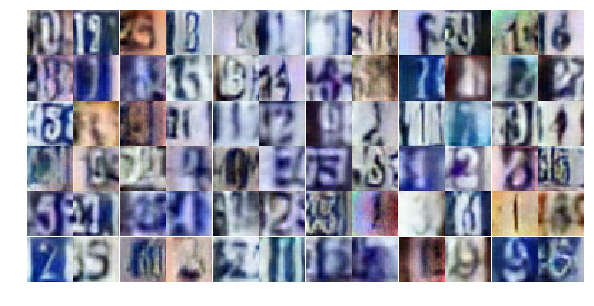

Epoch 11/25... Discriminator Loss: 0.4648... Generator Loss: 1.6185
Epoch 11/25... Discriminator Loss: 0.7762... Generator Loss: 0.8828
Epoch 11/25... Discriminator Loss: 0.4288... Generator Loss: 1.5821
Epoch 11/25... Discriminator Loss: 0.6606... Generator Loss: 1.3588
Epoch 11/25... Discriminator Loss: 0.8685... Generator Loss: 0.7916
Epoch 11/25... Discriminator Loss: 0.4521... Generator Loss: 1.6196
Epoch 11/25... Discriminator Loss: 0.6026... Generator Loss: 1.7010
Epoch 11/25... Discriminator Loss: 0.4060... Generator Loss: 1.9945
Epoch 11/25... Discriminator Loss: 1.4460... Generator Loss: 0.4444
Epoch 11/25... Discriminator Loss: 1.1349... Generator Loss: 0.5393


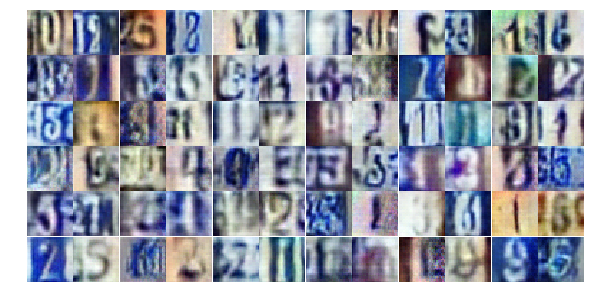

Epoch 11/25... Discriminator Loss: 1.0326... Generator Loss: 0.6480
Epoch 11/25... Discriminator Loss: 0.4019... Generator Loss: 1.6121
Epoch 11/25... Discriminator Loss: 0.7102... Generator Loss: 0.9980
Epoch 11/25... Discriminator Loss: 0.7413... Generator Loss: 0.9708
Epoch 11/25... Discriminator Loss: 0.4015... Generator Loss: 1.9901
Epoch 11/25... Discriminator Loss: 0.4804... Generator Loss: 2.0951
Epoch 11/25... Discriminator Loss: 0.5474... Generator Loss: 1.5273
Epoch 11/25... Discriminator Loss: 1.4096... Generator Loss: 0.4013
Epoch 11/25... Discriminator Loss: 0.4510... Generator Loss: 1.5441
Epoch 11/25... Discriminator Loss: 0.8800... Generator Loss: 0.7270


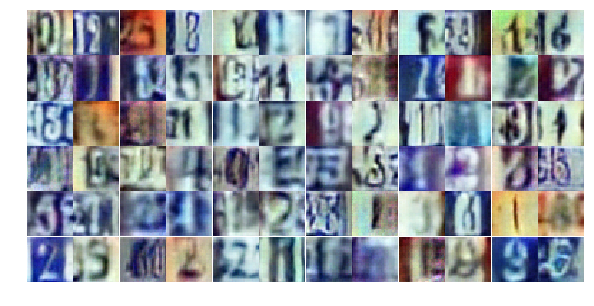

Epoch 11/25... Discriminator Loss: 0.8142... Generator Loss: 1.0769
Epoch 11/25... Discriminator Loss: 0.7647... Generator Loss: 0.9243
Epoch 11/25... Discriminator Loss: 1.1435... Generator Loss: 0.5662
Epoch 11/25... Discriminator Loss: 0.4867... Generator Loss: 1.6929
Epoch 11/25... Discriminator Loss: 0.7505... Generator Loss: 0.9596
Epoch 11/25... Discriminator Loss: 1.0724... Generator Loss: 0.5691
Epoch 11/25... Discriminator Loss: 1.2567... Generator Loss: 0.4856
Epoch 11/25... Discriminator Loss: 0.7673... Generator Loss: 0.8906
Epoch 11/25... Discriminator Loss: 0.5505... Generator Loss: 1.1971
Epoch 11/25... Discriminator Loss: 0.8482... Generator Loss: 0.8367


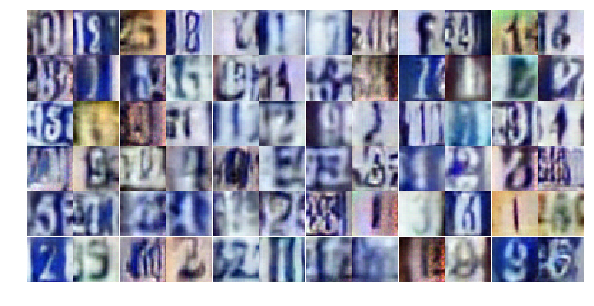

Epoch 11/25... Discriminator Loss: 0.4701... Generator Loss: 1.4953
Epoch 11/25... Discriminator Loss: 0.5213... Generator Loss: 1.2258
Epoch 11/25... Discriminator Loss: 0.6198... Generator Loss: 1.1272
Epoch 11/25... Discriminator Loss: 1.3025... Generator Loss: 0.4709
Epoch 11/25... Discriminator Loss: 1.1814... Generator Loss: 0.5150
Epoch 11/25... Discriminator Loss: 0.8077... Generator Loss: 0.8405
Epoch 11/25... Discriminator Loss: 0.3651... Generator Loss: 1.7858
Epoch 11/25... Discriminator Loss: 0.8904... Generator Loss: 0.7306
Epoch 11/25... Discriminator Loss: 1.6820... Generator Loss: 0.3284
Epoch 11/25... Discriminator Loss: 0.4520... Generator Loss: 1.4932


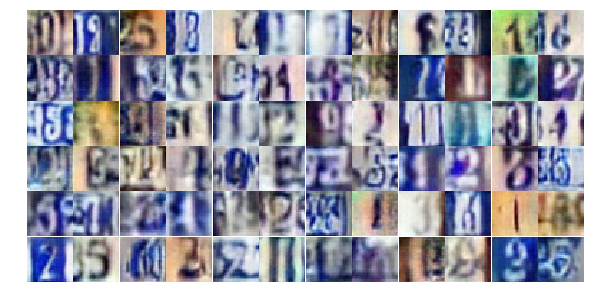

Epoch 11/25... Discriminator Loss: 0.9590... Generator Loss: 0.7840
Epoch 11/25... Discriminator Loss: 0.5451... Generator Loss: 1.3606
Epoch 11/25... Discriminator Loss: 0.5638... Generator Loss: 1.4326
Epoch 11/25... Discriminator Loss: 0.6631... Generator Loss: 1.0016
Epoch 11/25... Discriminator Loss: 1.1440... Generator Loss: 0.5281
Epoch 11/25... Discriminator Loss: 0.7238... Generator Loss: 0.9625
Epoch 11/25... Discriminator Loss: 0.7462... Generator Loss: 0.9164
Epoch 11/25... Discriminator Loss: 0.5439... Generator Loss: 1.5611
Epoch 11/25... Discriminator Loss: 0.9538... Generator Loss: 1.3454
Epoch 11/25... Discriminator Loss: 0.9659... Generator Loss: 0.7366


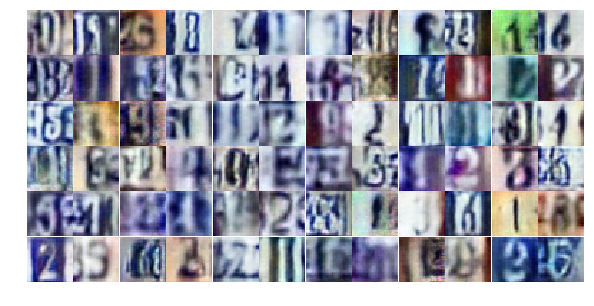

Epoch 12/25... Discriminator Loss: 0.6005... Generator Loss: 1.7531
Epoch 12/25... Discriminator Loss: 0.5736... Generator Loss: 1.5814
Epoch 12/25... Discriminator Loss: 0.8492... Generator Loss: 1.1414
Epoch 12/25... Discriminator Loss: 0.4909... Generator Loss: 1.6405
Epoch 12/25... Discriminator Loss: 0.5265... Generator Loss: 1.2772
Epoch 12/25... Discriminator Loss: 1.1542... Generator Loss: 0.5392
Epoch 12/25... Discriminator Loss: 0.4885... Generator Loss: 1.5422
Epoch 12/25... Discriminator Loss: 0.4426... Generator Loss: 1.5303
Epoch 12/25... Discriminator Loss: 0.6569... Generator Loss: 1.5296
Epoch 12/25... Discriminator Loss: 1.4203... Generator Loss: 0.4410


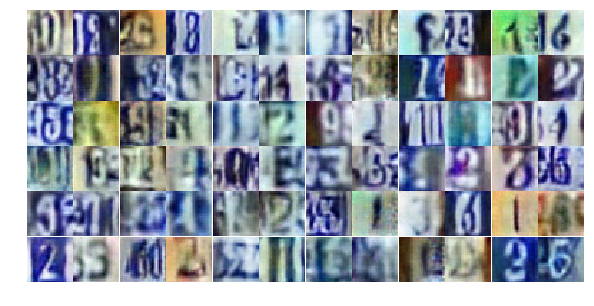

Epoch 12/25... Discriminator Loss: 0.3857... Generator Loss: 2.1980
Epoch 12/25... Discriminator Loss: 0.9374... Generator Loss: 0.6427
Epoch 12/25... Discriminator Loss: 0.8909... Generator Loss: 2.8780
Epoch 12/25... Discriminator Loss: 0.7970... Generator Loss: 1.0845
Epoch 12/25... Discriminator Loss: 0.4766... Generator Loss: 1.7124
Epoch 12/25... Discriminator Loss: 1.2185... Generator Loss: 0.6136
Epoch 12/25... Discriminator Loss: 1.8547... Generator Loss: 0.2362
Epoch 12/25... Discriminator Loss: 0.4659... Generator Loss: 1.9961
Epoch 12/25... Discriminator Loss: 0.5910... Generator Loss: 2.1817
Epoch 12/25... Discriminator Loss: 0.8476... Generator Loss: 0.8592


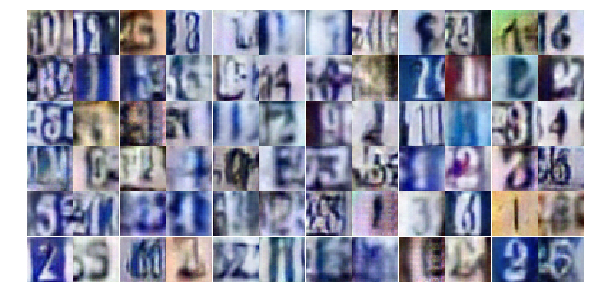

Epoch 12/25... Discriminator Loss: 0.5140... Generator Loss: 1.9195
Epoch 12/25... Discriminator Loss: 0.4407... Generator Loss: 1.4879
Epoch 12/25... Discriminator Loss: 0.4704... Generator Loss: 1.5095
Epoch 12/25... Discriminator Loss: 0.5997... Generator Loss: 2.1988
Epoch 12/25... Discriminator Loss: 0.5396... Generator Loss: 1.3230
Epoch 12/25... Discriminator Loss: 0.5053... Generator Loss: 1.7528
Epoch 12/25... Discriminator Loss: 0.6086... Generator Loss: 1.4359
Epoch 12/25... Discriminator Loss: 0.4129... Generator Loss: 1.6929
Epoch 12/25... Discriminator Loss: 0.5372... Generator Loss: 1.3110
Epoch 12/25... Discriminator Loss: 0.6462... Generator Loss: 1.3626


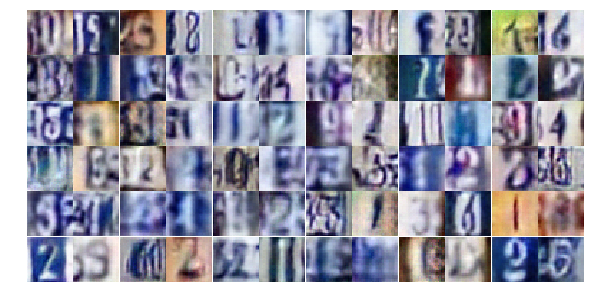

Epoch 12/25... Discriminator Loss: 0.5835... Generator Loss: 1.1390
Epoch 12/25... Discriminator Loss: 0.7594... Generator Loss: 0.8816
Epoch 12/25... Discriminator Loss: 0.8591... Generator Loss: 0.7443
Epoch 12/25... Discriminator Loss: 1.3009... Generator Loss: 0.4253
Epoch 12/25... Discriminator Loss: 1.1783... Generator Loss: 2.8056
Epoch 12/25... Discriminator Loss: 0.9279... Generator Loss: 0.9619
Epoch 12/25... Discriminator Loss: 0.8519... Generator Loss: 0.8168
Epoch 12/25... Discriminator Loss: 0.6973... Generator Loss: 1.2466
Epoch 12/25... Discriminator Loss: 0.7995... Generator Loss: 0.8607
Epoch 12/25... Discriminator Loss: 0.4186... Generator Loss: 1.5649


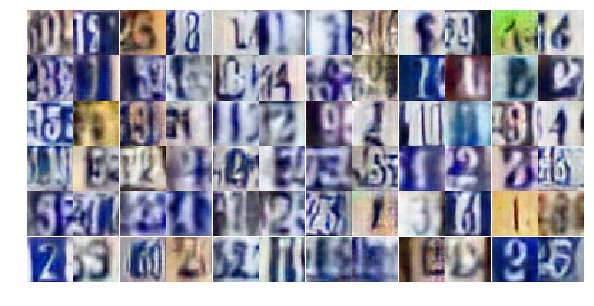

Epoch 12/25... Discriminator Loss: 0.5229... Generator Loss: 1.4605
Epoch 12/25... Discriminator Loss: 0.4552... Generator Loss: 1.4281
Epoch 12/25... Discriminator Loss: 0.4089... Generator Loss: 1.5801
Epoch 12/25... Discriminator Loss: 0.5738... Generator Loss: 1.1143
Epoch 12/25... Discriminator Loss: 1.9522... Generator Loss: 0.3137
Epoch 12/25... Discriminator Loss: 1.0479... Generator Loss: 0.6736
Epoch 12/25... Discriminator Loss: 0.7900... Generator Loss: 0.8770
Epoch 12/25... Discriminator Loss: 1.0415... Generator Loss: 0.6598
Epoch 12/25... Discriminator Loss: 0.6306... Generator Loss: 1.0825
Epoch 12/25... Discriminator Loss: 1.0091... Generator Loss: 0.6419


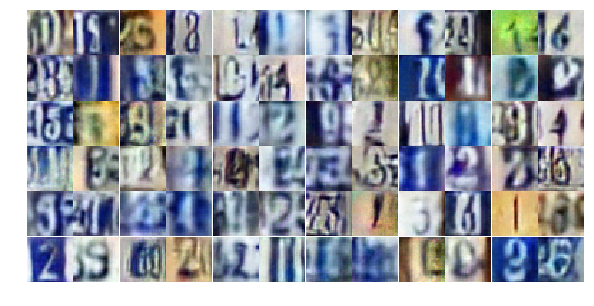

Epoch 12/25... Discriminator Loss: 0.9838... Generator Loss: 0.7119
Epoch 12/25... Discriminator Loss: 0.7837... Generator Loss: 0.8984
Epoch 12/25... Discriminator Loss: 0.9252... Generator Loss: 0.7545
Epoch 12/25... Discriminator Loss: 1.1868... Generator Loss: 0.5091
Epoch 12/25... Discriminator Loss: 0.7147... Generator Loss: 0.9654
Epoch 12/25... Discriminator Loss: 0.7404... Generator Loss: 1.1227
Epoch 12/25... Discriminator Loss: 1.1587... Generator Loss: 0.5485
Epoch 13/25... Discriminator Loss: 0.5490... Generator Loss: 1.2739
Epoch 13/25... Discriminator Loss: 0.4813... Generator Loss: 1.4909
Epoch 13/25... Discriminator Loss: 0.9196... Generator Loss: 0.8054


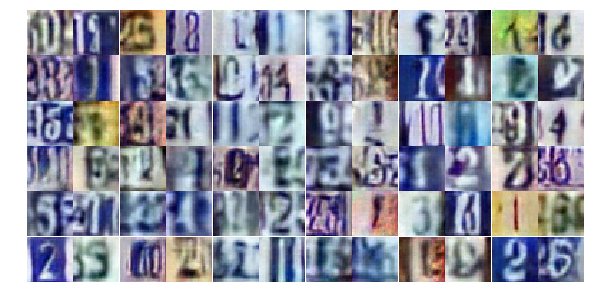

Epoch 13/25... Discriminator Loss: 0.4822... Generator Loss: 1.6061
Epoch 13/25... Discriminator Loss: 0.5446... Generator Loss: 1.2081
Epoch 13/25... Discriminator Loss: 1.1859... Generator Loss: 0.6067
Epoch 13/25... Discriminator Loss: 1.4416... Generator Loss: 0.5440
Epoch 13/25... Discriminator Loss: 0.6141... Generator Loss: 1.4756
Epoch 13/25... Discriminator Loss: 0.6202... Generator Loss: 1.2315
Epoch 13/25... Discriminator Loss: 0.4006... Generator Loss: 1.9153
Epoch 13/25... Discriminator Loss: 0.5706... Generator Loss: 1.1646
Epoch 13/25... Discriminator Loss: 0.7326... Generator Loss: 0.9409
Epoch 13/25... Discriminator Loss: 0.5025... Generator Loss: 1.7717


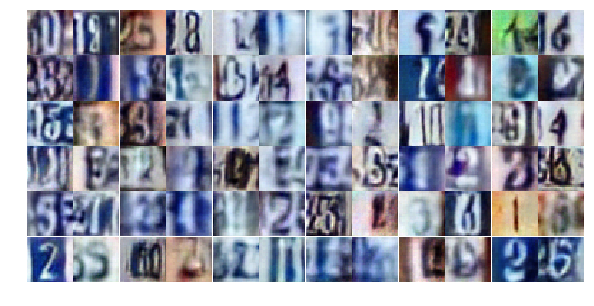

Epoch 13/25... Discriminator Loss: 0.7500... Generator Loss: 0.8910
Epoch 13/25... Discriminator Loss: 0.5366... Generator Loss: 1.3139
Epoch 13/25... Discriminator Loss: 1.3807... Generator Loss: 0.4340
Epoch 13/25... Discriminator Loss: 0.5951... Generator Loss: 1.6503
Epoch 13/25... Discriminator Loss: 0.5954... Generator Loss: 1.5035
Epoch 13/25... Discriminator Loss: 0.7728... Generator Loss: 1.2180
Epoch 13/25... Discriminator Loss: 0.7011... Generator Loss: 1.0447
Epoch 13/25... Discriminator Loss: 1.2690... Generator Loss: 0.4865
Epoch 13/25... Discriminator Loss: 0.7161... Generator Loss: 0.9570
Epoch 13/25... Discriminator Loss: 1.0266... Generator Loss: 0.6212


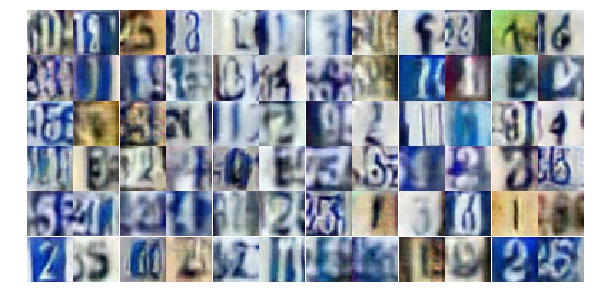

Epoch 13/25... Discriminator Loss: 0.8934... Generator Loss: 0.7095
Epoch 13/25... Discriminator Loss: 0.5585... Generator Loss: 1.3717
Epoch 13/25... Discriminator Loss: 0.5530... Generator Loss: 2.2012
Epoch 13/25... Discriminator Loss: 0.7403... Generator Loss: 0.8749
Epoch 13/25... Discriminator Loss: 0.7520... Generator Loss: 0.8949
Epoch 13/25... Discriminator Loss: 1.4491... Generator Loss: 0.3862
Epoch 13/25... Discriminator Loss: 0.8419... Generator Loss: 0.9870
Epoch 13/25... Discriminator Loss: 0.5023... Generator Loss: 1.2660
Epoch 13/25... Discriminator Loss: 0.4897... Generator Loss: 1.4463
Epoch 13/25... Discriminator Loss: 0.5479... Generator Loss: 1.3047


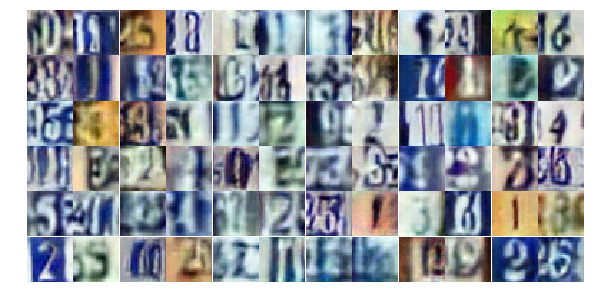

Epoch 13/25... Discriminator Loss: 1.1687... Generator Loss: 0.5261
Epoch 13/25... Discriminator Loss: 0.5293... Generator Loss: 1.6684
Epoch 13/25... Discriminator Loss: 1.9443... Generator Loss: 0.2310
Epoch 13/25... Discriminator Loss: 0.8466... Generator Loss: 1.1458
Epoch 13/25... Discriminator Loss: 0.6117... Generator Loss: 1.2506
Epoch 13/25... Discriminator Loss: 0.6654... Generator Loss: 1.9765
Epoch 13/25... Discriminator Loss: 0.6096... Generator Loss: 1.2229
Epoch 13/25... Discriminator Loss: 0.8718... Generator Loss: 0.8374
Epoch 13/25... Discriminator Loss: 0.6513... Generator Loss: 1.0513
Epoch 13/25... Discriminator Loss: 0.5954... Generator Loss: 1.2456


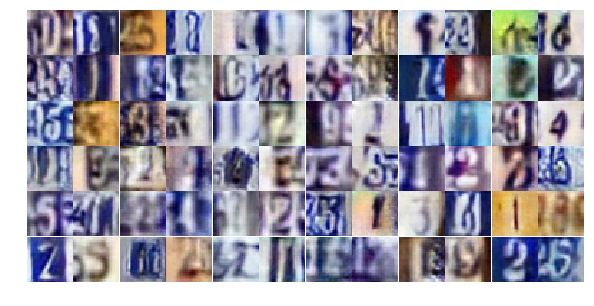

Epoch 13/25... Discriminator Loss: 0.5868... Generator Loss: 1.4036
Epoch 13/25... Discriminator Loss: 0.9258... Generator Loss: 0.7413
Epoch 13/25... Discriminator Loss: 0.6722... Generator Loss: 1.2000
Epoch 13/25... Discriminator Loss: 0.7343... Generator Loss: 1.1861
Epoch 13/25... Discriminator Loss: 1.0241... Generator Loss: 0.6033
Epoch 13/25... Discriminator Loss: 0.5081... Generator Loss: 1.2769
Epoch 13/25... Discriminator Loss: 0.8681... Generator Loss: 0.7933
Epoch 13/25... Discriminator Loss: 0.7509... Generator Loss: 0.9475
Epoch 13/25... Discriminator Loss: 0.8380... Generator Loss: 0.7778
Epoch 13/25... Discriminator Loss: 0.6369... Generator Loss: 1.0054


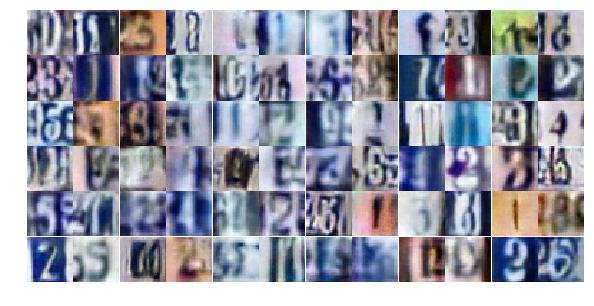

Epoch 13/25... Discriminator Loss: 0.2997... Generator Loss: 2.5454
Epoch 13/25... Discriminator Loss: 1.2467... Generator Loss: 0.5560
Epoch 13/25... Discriminator Loss: 0.8130... Generator Loss: 0.8672
Epoch 13/25... Discriminator Loss: 1.2034... Generator Loss: 0.4981
Epoch 14/25... Discriminator Loss: 1.0306... Generator Loss: 0.6685
Epoch 14/25... Discriminator Loss: 0.8391... Generator Loss: 1.0166
Epoch 14/25... Discriminator Loss: 0.7844... Generator Loss: 1.0005
Epoch 14/25... Discriminator Loss: 0.6500... Generator Loss: 1.9621
Epoch 14/25... Discriminator Loss: 0.5963... Generator Loss: 1.1682
Epoch 14/25... Discriminator Loss: 1.0666... Generator Loss: 0.5912


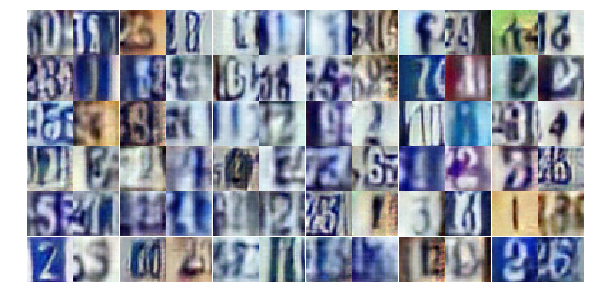

Epoch 14/25... Discriminator Loss: 0.6892... Generator Loss: 1.7972
Epoch 14/25... Discriminator Loss: 0.6118... Generator Loss: 1.1459
Epoch 14/25... Discriminator Loss: 0.5171... Generator Loss: 1.3535
Epoch 14/25... Discriminator Loss: 0.5838... Generator Loss: 1.3967
Epoch 14/25... Discriminator Loss: 1.1463... Generator Loss: 0.4844
Epoch 14/25... Discriminator Loss: 0.4343... Generator Loss: 1.4504
Epoch 14/25... Discriminator Loss: 0.3724... Generator Loss: 1.9029
Epoch 14/25... Discriminator Loss: 1.3374... Generator Loss: 0.4005
Epoch 14/25... Discriminator Loss: 1.2938... Generator Loss: 0.4319
Epoch 14/25... Discriminator Loss: 1.3479... Generator Loss: 0.4389


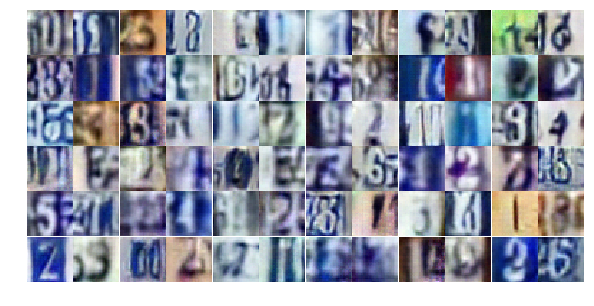

Epoch 14/25... Discriminator Loss: 0.5193... Generator Loss: 1.3298
Epoch 14/25... Discriminator Loss: 0.6377... Generator Loss: 1.6965
Epoch 14/25... Discriminator Loss: 1.0625... Generator Loss: 0.6354
Epoch 14/25... Discriminator Loss: 0.5846... Generator Loss: 1.3457
Epoch 14/25... Discriminator Loss: 0.9455... Generator Loss: 0.7103
Epoch 14/25... Discriminator Loss: 0.8924... Generator Loss: 0.7721
Epoch 14/25... Discriminator Loss: 0.6701... Generator Loss: 1.0848
Epoch 14/25... Discriminator Loss: 0.7235... Generator Loss: 0.9853
Epoch 14/25... Discriminator Loss: 0.6318... Generator Loss: 1.0792
Epoch 14/25... Discriminator Loss: 0.4593... Generator Loss: 1.5928


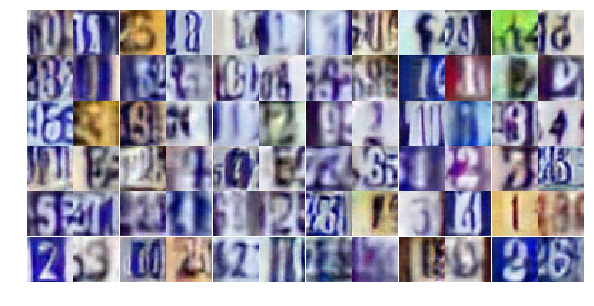

Epoch 14/25... Discriminator Loss: 1.0550... Generator Loss: 0.7171
Epoch 14/25... Discriminator Loss: 0.3510... Generator Loss: 2.0900
Epoch 14/25... Discriminator Loss: 0.7155... Generator Loss: 1.0677
Epoch 14/25... Discriminator Loss: 2.1369... Generator Loss: 1.1412
Epoch 14/25... Discriminator Loss: 1.3394... Generator Loss: 1.9616
Epoch 14/25... Discriminator Loss: 1.2171... Generator Loss: 0.5476
Epoch 14/25... Discriminator Loss: 0.8450... Generator Loss: 1.0592
Epoch 14/25... Discriminator Loss: 0.5691... Generator Loss: 2.2371
Epoch 14/25... Discriminator Loss: 0.5755... Generator Loss: 1.3756
Epoch 14/25... Discriminator Loss: 0.7248... Generator Loss: 1.0842


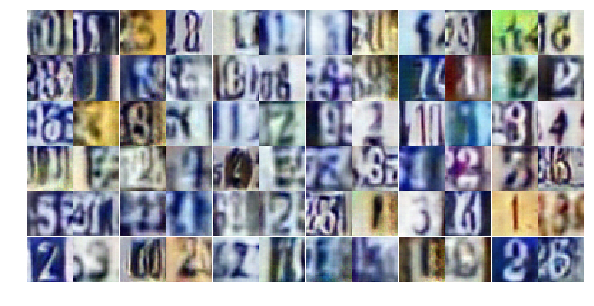

Epoch 14/25... Discriminator Loss: 1.1858... Generator Loss: 0.4944
Epoch 14/25... Discriminator Loss: 0.7547... Generator Loss: 0.9718
Epoch 14/25... Discriminator Loss: 1.1065... Generator Loss: 0.5834
Epoch 14/25... Discriminator Loss: 1.2153... Generator Loss: 0.5125
Epoch 14/25... Discriminator Loss: 0.9126... Generator Loss: 0.7788
Epoch 14/25... Discriminator Loss: 0.8545... Generator Loss: 0.9216
Epoch 14/25... Discriminator Loss: 0.7792... Generator Loss: 0.8840
Epoch 14/25... Discriminator Loss: 0.5512... Generator Loss: 1.2367
Epoch 14/25... Discriminator Loss: 0.9794... Generator Loss: 0.7005
Epoch 14/25... Discriminator Loss: 1.3266... Generator Loss: 0.4266


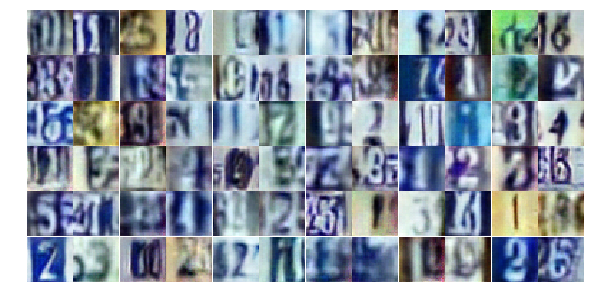

Epoch 14/25... Discriminator Loss: 1.0236... Generator Loss: 0.8749
Epoch 14/25... Discriminator Loss: 1.1972... Generator Loss: 0.5260
Epoch 14/25... Discriminator Loss: 0.6652... Generator Loss: 1.1560
Epoch 14/25... Discriminator Loss: 0.8550... Generator Loss: 0.8027
Epoch 14/25... Discriminator Loss: 0.6716... Generator Loss: 1.0273
Epoch 14/25... Discriminator Loss: 0.4943... Generator Loss: 1.4723
Epoch 14/25... Discriminator Loss: 0.7614... Generator Loss: 1.9888
Epoch 14/25... Discriminator Loss: 0.7646... Generator Loss: 1.0856
Epoch 14/25... Discriminator Loss: 1.9132... Generator Loss: 0.3604
Epoch 14/25... Discriminator Loss: 0.7661... Generator Loss: 0.9549


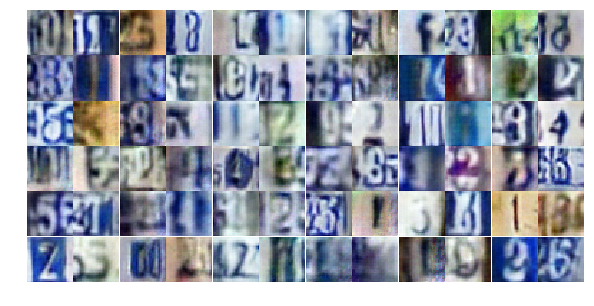

Epoch 14/25... Discriminator Loss: 0.8013... Generator Loss: 1.0357
Epoch 14/25... Discriminator Loss: 0.8407... Generator Loss: 0.8036
Epoch 15/25... Discriminator Loss: 0.7636... Generator Loss: 0.9569
Epoch 15/25... Discriminator Loss: 0.6307... Generator Loss: 1.2659
Epoch 15/25... Discriminator Loss: 0.5735... Generator Loss: 1.1623
Epoch 15/25... Discriminator Loss: 0.7714... Generator Loss: 0.8621
Epoch 15/25... Discriminator Loss: 1.0171... Generator Loss: 0.6652
Epoch 15/25... Discriminator Loss: 0.7162... Generator Loss: 0.8935
Epoch 15/25... Discriminator Loss: 1.4815... Generator Loss: 0.3688
Epoch 15/25... Discriminator Loss: 0.5389... Generator Loss: 1.3239


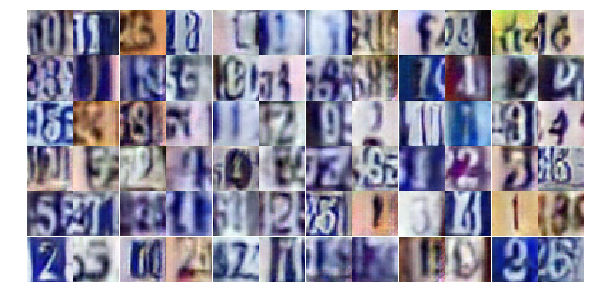

Epoch 15/25... Discriminator Loss: 1.0487... Generator Loss: 0.6580
Epoch 15/25... Discriminator Loss: 0.7177... Generator Loss: 1.5361
Epoch 15/25... Discriminator Loss: 0.7304... Generator Loss: 1.0851
Epoch 15/25... Discriminator Loss: 0.6716... Generator Loss: 1.1574
Epoch 15/25... Discriminator Loss: 1.0205... Generator Loss: 0.6895
Epoch 15/25... Discriminator Loss: 0.5167... Generator Loss: 1.4020
Epoch 15/25... Discriminator Loss: 1.1766... Generator Loss: 0.5189
Epoch 15/25... Discriminator Loss: 0.7959... Generator Loss: 2.3772
Epoch 15/25... Discriminator Loss: 1.5759... Generator Loss: 3.7476
Epoch 15/25... Discriminator Loss: 1.1678... Generator Loss: 0.5568


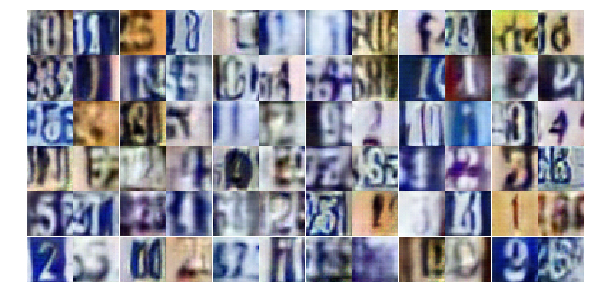

Epoch 15/25... Discriminator Loss: 0.9646... Generator Loss: 0.7801
Epoch 15/25... Discriminator Loss: 0.7976... Generator Loss: 0.9044
Epoch 15/25... Discriminator Loss: 0.7236... Generator Loss: 1.1941
Epoch 15/25... Discriminator Loss: 0.6896... Generator Loss: 1.1394
Epoch 15/25... Discriminator Loss: 1.3146... Generator Loss: 0.4492
Epoch 15/25... Discriminator Loss: 0.6592... Generator Loss: 1.1437
Epoch 15/25... Discriminator Loss: 1.0209... Generator Loss: 0.6442
Epoch 15/25... Discriminator Loss: 1.0127... Generator Loss: 0.6823
Epoch 15/25... Discriminator Loss: 0.5368... Generator Loss: 1.4084
Epoch 15/25... Discriminator Loss: 1.2874... Generator Loss: 0.5196


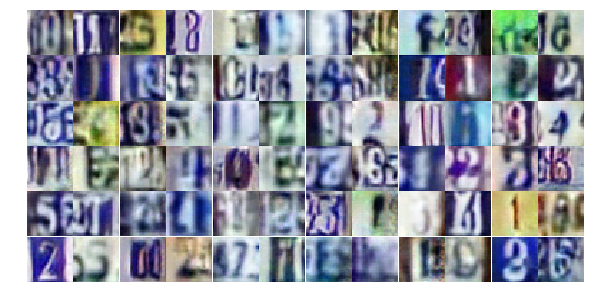

Epoch 15/25... Discriminator Loss: 0.6241... Generator Loss: 1.1273
Epoch 15/25... Discriminator Loss: 0.6352... Generator Loss: 1.1071
Epoch 15/25... Discriminator Loss: 0.6149... Generator Loss: 1.0458
Epoch 15/25... Discriminator Loss: 0.5850... Generator Loss: 1.3401
Epoch 15/25... Discriminator Loss: 0.5791... Generator Loss: 1.2028
Epoch 15/25... Discriminator Loss: 1.7466... Generator Loss: 3.4877
Epoch 15/25... Discriminator Loss: 0.6603... Generator Loss: 1.0086
Epoch 15/25... Discriminator Loss: 0.8095... Generator Loss: 0.8387
Epoch 15/25... Discriminator Loss: 0.5457... Generator Loss: 1.2463
Epoch 15/25... Discriminator Loss: 0.6774... Generator Loss: 1.2032


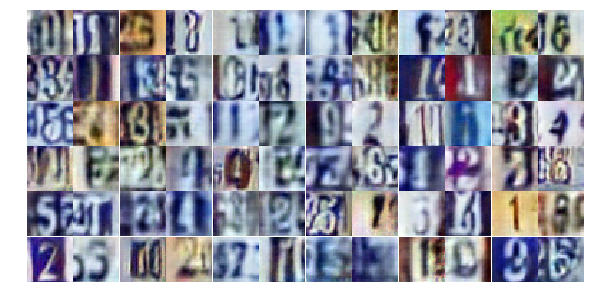

Epoch 15/25... Discriminator Loss: 0.6552... Generator Loss: 1.0945
Epoch 15/25... Discriminator Loss: 1.1631... Generator Loss: 0.5294
Epoch 15/25... Discriminator Loss: 0.6123... Generator Loss: 1.1427
Epoch 15/25... Discriminator Loss: 0.5312... Generator Loss: 1.2335
Epoch 15/25... Discriminator Loss: 0.4866... Generator Loss: 1.3394
Epoch 15/25... Discriminator Loss: 1.9135... Generator Loss: 0.2255
Epoch 15/25... Discriminator Loss: 0.4379... Generator Loss: 1.7814
Epoch 15/25... Discriminator Loss: 0.7009... Generator Loss: 1.4373
Epoch 15/25... Discriminator Loss: 1.0642... Generator Loss: 0.6268
Epoch 15/25... Discriminator Loss: 0.7823... Generator Loss: 1.0229


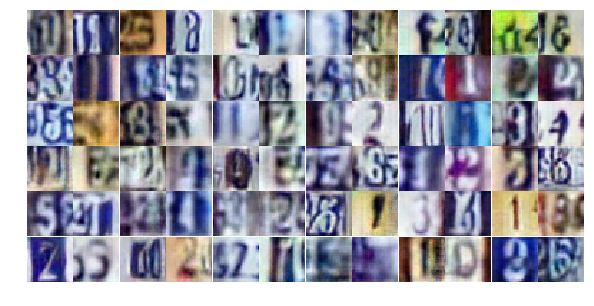

Epoch 15/25... Discriminator Loss: 1.1602... Generator Loss: 0.5400
Epoch 15/25... Discriminator Loss: 0.8469... Generator Loss: 1.0427
Epoch 15/25... Discriminator Loss: 0.5690... Generator Loss: 1.5035
Epoch 15/25... Discriminator Loss: 1.3142... Generator Loss: 0.4352
Epoch 15/25... Discriminator Loss: 0.6628... Generator Loss: 1.4521
Epoch 15/25... Discriminator Loss: 0.6376... Generator Loss: 1.4561
Epoch 15/25... Discriminator Loss: 0.9421... Generator Loss: 0.7044
Epoch 15/25... Discriminator Loss: 0.7190... Generator Loss: 1.0029
Epoch 15/25... Discriminator Loss: 1.5658... Generator Loss: 0.3330
Epoch 16/25... Discriminator Loss: 1.3666... Generator Loss: 0.4136


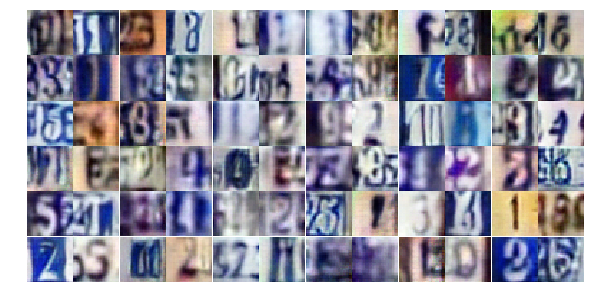

Epoch 16/25... Discriminator Loss: 0.7831... Generator Loss: 0.9466
Epoch 16/25... Discriminator Loss: 0.8891... Generator Loss: 0.7763
Epoch 16/25... Discriminator Loss: 1.0030... Generator Loss: 0.6342
Epoch 16/25... Discriminator Loss: 0.6302... Generator Loss: 1.2871
Epoch 16/25... Discriminator Loss: 0.9303... Generator Loss: 2.5812
Epoch 16/25... Discriminator Loss: 1.2981... Generator Loss: 3.4203
Epoch 16/25... Discriminator Loss: 1.2825... Generator Loss: 0.5261
Epoch 16/25... Discriminator Loss: 0.8185... Generator Loss: 0.8145
Epoch 16/25... Discriminator Loss: 0.5927... Generator Loss: 1.1805
Epoch 16/25... Discriminator Loss: 0.6606... Generator Loss: 0.9995


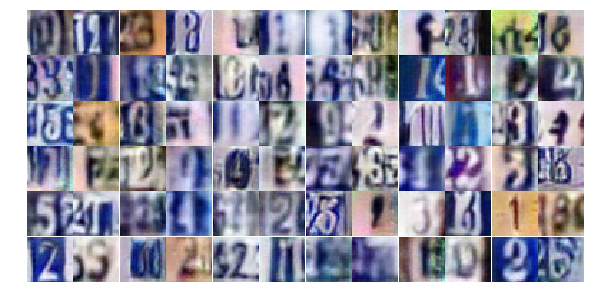

Epoch 16/25... Discriminator Loss: 1.1269... Generator Loss: 0.5525
Epoch 16/25... Discriminator Loss: 0.7970... Generator Loss: 1.0196
Epoch 16/25... Discriminator Loss: 0.7216... Generator Loss: 0.9886
Epoch 16/25... Discriminator Loss: 1.9079... Generator Loss: 0.2296
Epoch 16/25... Discriminator Loss: 0.6268... Generator Loss: 1.1399
Epoch 16/25... Discriminator Loss: 0.9272... Generator Loss: 0.7270
Epoch 16/25... Discriminator Loss: 1.6981... Generator Loss: 0.3466
Epoch 16/25... Discriminator Loss: 0.6042... Generator Loss: 1.1856
Epoch 16/25... Discriminator Loss: 0.4426... Generator Loss: 1.5678
Epoch 16/25... Discriminator Loss: 0.5836... Generator Loss: 1.3594


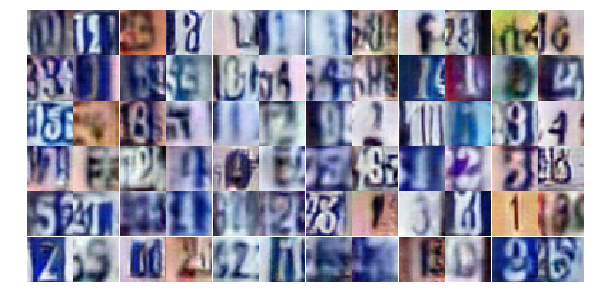

Epoch 16/25... Discriminator Loss: 0.6493... Generator Loss: 1.2210
Epoch 16/25... Discriminator Loss: 0.9339... Generator Loss: 0.6811
Epoch 16/25... Discriminator Loss: 0.7078... Generator Loss: 0.9550
Epoch 16/25... Discriminator Loss: 1.0847... Generator Loss: 0.5909
Epoch 16/25... Discriminator Loss: 0.6383... Generator Loss: 1.5583
Epoch 16/25... Discriminator Loss: 0.8536... Generator Loss: 1.0282
Epoch 16/25... Discriminator Loss: 0.5763... Generator Loss: 1.1751
Epoch 16/25... Discriminator Loss: 0.5806... Generator Loss: 1.1224
Epoch 16/25... Discriminator Loss: 1.0944... Generator Loss: 0.6548
Epoch 16/25... Discriminator Loss: 0.6493... Generator Loss: 1.1640


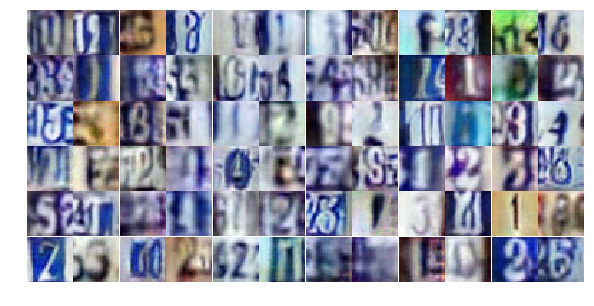

Epoch 16/25... Discriminator Loss: 0.8516... Generator Loss: 0.7934
Epoch 16/25... Discriminator Loss: 0.6930... Generator Loss: 0.9560
Epoch 16/25... Discriminator Loss: 0.5626... Generator Loss: 1.4431
Epoch 16/25... Discriminator Loss: 1.1657... Generator Loss: 0.6214
Epoch 16/25... Discriminator Loss: 1.1746... Generator Loss: 0.5433
Epoch 16/25... Discriminator Loss: 0.6828... Generator Loss: 1.0181
Epoch 16/25... Discriminator Loss: 1.1431... Generator Loss: 0.5463
Epoch 16/25... Discriminator Loss: 0.9045... Generator Loss: 0.7191
Epoch 16/25... Discriminator Loss: 1.0171... Generator Loss: 0.6378
Epoch 16/25... Discriminator Loss: 0.5680... Generator Loss: 1.1272


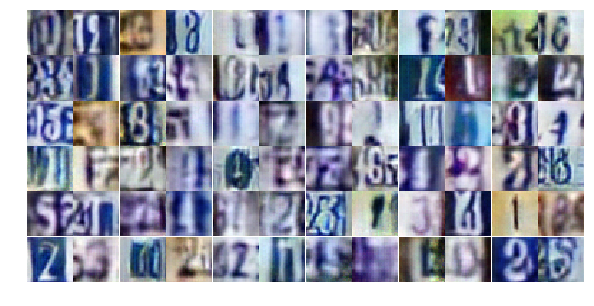

Epoch 16/25... Discriminator Loss: 0.4389... Generator Loss: 1.4421
Epoch 16/25... Discriminator Loss: 0.9882... Generator Loss: 0.6569
Epoch 16/25... Discriminator Loss: 1.5450... Generator Loss: 0.3881
Epoch 16/25... Discriminator Loss: 1.5497... Generator Loss: 0.4042
Epoch 16/25... Discriminator Loss: 0.8566... Generator Loss: 0.8457
Epoch 16/25... Discriminator Loss: 0.8547... Generator Loss: 0.8499
Epoch 16/25... Discriminator Loss: 0.5770... Generator Loss: 1.7080
Epoch 16/25... Discriminator Loss: 0.8761... Generator Loss: 0.8519
Epoch 16/25... Discriminator Loss: 0.7040... Generator Loss: 0.9363
Epoch 16/25... Discriminator Loss: 0.7132... Generator Loss: 0.9918


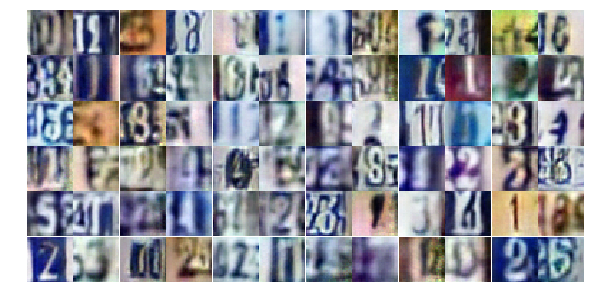

Epoch 16/25... Discriminator Loss: 1.4017... Generator Loss: 0.4000
Epoch 16/25... Discriminator Loss: 0.7214... Generator Loss: 0.9965
Epoch 16/25... Discriminator Loss: 1.3665... Generator Loss: 0.4546
Epoch 16/25... Discriminator Loss: 0.5178... Generator Loss: 1.9789
Epoch 16/25... Discriminator Loss: 0.6662... Generator Loss: 1.1782
Epoch 16/25... Discriminator Loss: 0.7385... Generator Loss: 0.9233
Epoch 17/25... Discriminator Loss: 0.6858... Generator Loss: 1.0630
Epoch 17/25... Discriminator Loss: 0.7162... Generator Loss: 1.0344
Epoch 17/25... Discriminator Loss: 0.6865... Generator Loss: 1.2115
Epoch 17/25... Discriminator Loss: 0.6337... Generator Loss: 1.2947


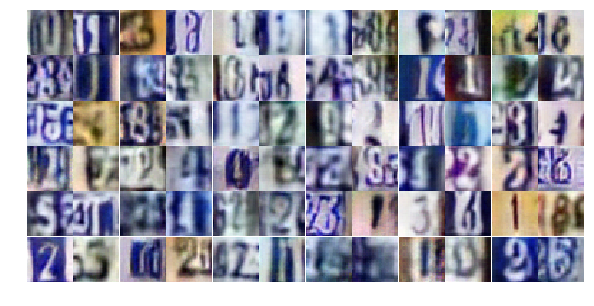

Epoch 17/25... Discriminator Loss: 0.4457... Generator Loss: 2.0492
Epoch 17/25... Discriminator Loss: 0.7146... Generator Loss: 1.0367
Epoch 17/25... Discriminator Loss: 0.7337... Generator Loss: 1.0779
Epoch 17/25... Discriminator Loss: 0.5958... Generator Loss: 1.4731
Epoch 17/25... Discriminator Loss: 1.0969... Generator Loss: 0.6082
Epoch 17/25... Discriminator Loss: 0.8836... Generator Loss: 0.8638
Epoch 17/25... Discriminator Loss: 0.7892... Generator Loss: 0.8910
Epoch 17/25... Discriminator Loss: 0.8094... Generator Loss: 0.8047
Epoch 17/25... Discriminator Loss: 0.5914... Generator Loss: 1.1182
Epoch 17/25... Discriminator Loss: 0.6071... Generator Loss: 2.4559


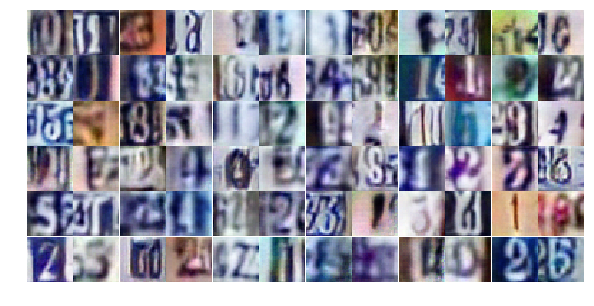

Epoch 17/25... Discriminator Loss: 1.2227... Generator Loss: 2.6182
Epoch 17/25... Discriminator Loss: 0.7612... Generator Loss: 1.7623
Epoch 17/25... Discriminator Loss: 0.4253... Generator Loss: 1.7270
Epoch 17/25... Discriminator Loss: 1.3977... Generator Loss: 0.4364
Epoch 17/25... Discriminator Loss: 0.6199... Generator Loss: 1.2741
Epoch 17/25... Discriminator Loss: 0.9604... Generator Loss: 0.6976
Epoch 17/25... Discriminator Loss: 0.6840... Generator Loss: 1.2495
Epoch 17/25... Discriminator Loss: 0.7740... Generator Loss: 0.9511
Epoch 17/25... Discriminator Loss: 0.9231... Generator Loss: 0.7101
Epoch 17/25... Discriminator Loss: 0.8727... Generator Loss: 0.7497


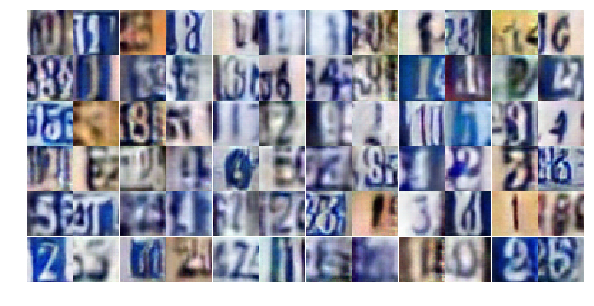

Epoch 17/25... Discriminator Loss: 1.6959... Generator Loss: 0.2939
Epoch 17/25... Discriminator Loss: 0.4503... Generator Loss: 1.7768
Epoch 17/25... Discriminator Loss: 0.4824... Generator Loss: 1.6713
Epoch 17/25... Discriminator Loss: 1.0419... Generator Loss: 0.6556
Epoch 17/25... Discriminator Loss: 1.1798... Generator Loss: 0.5130
Epoch 17/25... Discriminator Loss: 0.5724... Generator Loss: 1.1795
Epoch 17/25... Discriminator Loss: 0.6905... Generator Loss: 1.2987
Epoch 17/25... Discriminator Loss: 0.7179... Generator Loss: 0.9776
Epoch 17/25... Discriminator Loss: 0.8224... Generator Loss: 0.8896
Epoch 17/25... Discriminator Loss: 0.4259... Generator Loss: 1.7486


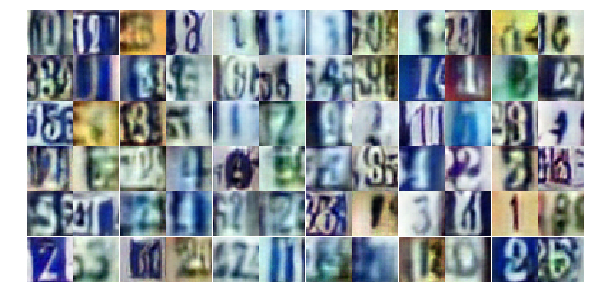

Epoch 17/25... Discriminator Loss: 0.5634... Generator Loss: 1.6074
Epoch 17/25... Discriminator Loss: 1.0141... Generator Loss: 0.9307
Epoch 17/25... Discriminator Loss: 0.4703... Generator Loss: 1.8505
Epoch 17/25... Discriminator Loss: 0.7576... Generator Loss: 0.9211
Epoch 17/25... Discriminator Loss: 0.8145... Generator Loss: 0.8501
Epoch 17/25... Discriminator Loss: 0.7619... Generator Loss: 0.9805
Epoch 17/25... Discriminator Loss: 0.7604... Generator Loss: 0.9631
Epoch 17/25... Discriminator Loss: 0.6668... Generator Loss: 1.1311
Epoch 17/25... Discriminator Loss: 0.6069... Generator Loss: 3.1886
Epoch 17/25... Discriminator Loss: 1.0512... Generator Loss: 0.5864


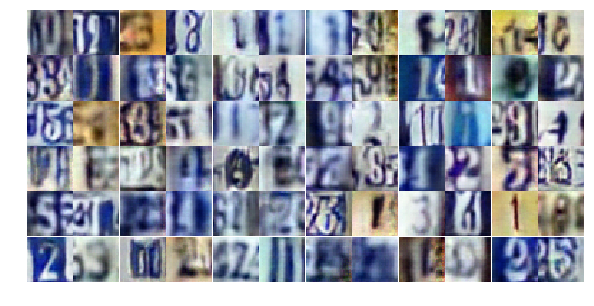

Epoch 17/25... Discriminator Loss: 1.0090... Generator Loss: 1.4594
Epoch 17/25... Discriminator Loss: 0.4156... Generator Loss: 1.6276
Epoch 17/25... Discriminator Loss: 0.8360... Generator Loss: 1.6047
Epoch 17/25... Discriminator Loss: 0.5584... Generator Loss: 1.1792
Epoch 17/25... Discriminator Loss: 0.9131... Generator Loss: 0.7459
Epoch 17/25... Discriminator Loss: 1.0226... Generator Loss: 0.6602
Epoch 17/25... Discriminator Loss: 0.9938... Generator Loss: 0.6501
Epoch 17/25... Discriminator Loss: 0.7304... Generator Loss: 1.6054
Epoch 17/25... Discriminator Loss: 0.9313... Generator Loss: 0.7738
Epoch 17/25... Discriminator Loss: 1.3648... Generator Loss: 0.4690


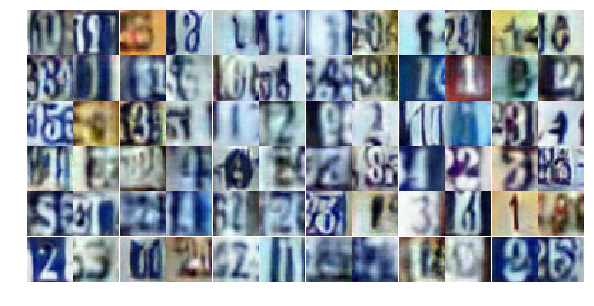

Epoch 17/25... Discriminator Loss: 1.6983... Generator Loss: 0.3223
Epoch 17/25... Discriminator Loss: 1.0155... Generator Loss: 0.7001
Epoch 17/25... Discriminator Loss: 1.0827... Generator Loss: 0.6798
Epoch 17/25... Discriminator Loss: 0.6778... Generator Loss: 2.2220
Epoch 18/25... Discriminator Loss: 0.8479... Generator Loss: 0.8348
Epoch 18/25... Discriminator Loss: 1.1248... Generator Loss: 0.5717
Epoch 18/25... Discriminator Loss: 0.4935... Generator Loss: 1.4251
Epoch 18/25... Discriminator Loss: 0.6462... Generator Loss: 1.1886
Epoch 18/25... Discriminator Loss: 1.1573... Generator Loss: 0.5528
Epoch 18/25... Discriminator Loss: 0.6531... Generator Loss: 1.5010


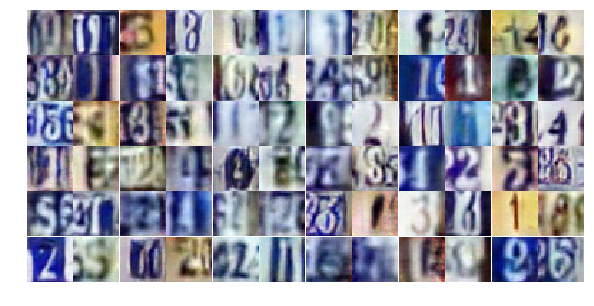

Epoch 18/25... Discriminator Loss: 0.4639... Generator Loss: 1.3948
Epoch 18/25... Discriminator Loss: 0.9646... Generator Loss: 1.1952
Epoch 18/25... Discriminator Loss: 0.9705... Generator Loss: 0.7605
Epoch 18/25... Discriminator Loss: 0.5012... Generator Loss: 1.9059
Epoch 18/25... Discriminator Loss: 1.0225... Generator Loss: 0.6386
Epoch 18/25... Discriminator Loss: 0.8382... Generator Loss: 0.8759
Epoch 18/25... Discriminator Loss: 0.6295... Generator Loss: 1.1356
Epoch 18/25... Discriminator Loss: 0.6153... Generator Loss: 1.1042
Epoch 18/25... Discriminator Loss: 0.7760... Generator Loss: 0.9077
Epoch 18/25... Discriminator Loss: 0.3486... Generator Loss: 2.3225


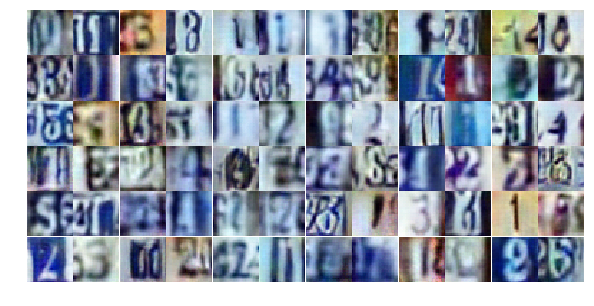

Epoch 18/25... Discriminator Loss: 0.6945... Generator Loss: 1.1648
Epoch 18/25... Discriminator Loss: 0.4690... Generator Loss: 2.1796
Epoch 18/25... Discriminator Loss: 1.0549... Generator Loss: 1.4458
Epoch 18/25... Discriminator Loss: 0.6343... Generator Loss: 1.2067
Epoch 18/25... Discriminator Loss: 0.8259... Generator Loss: 0.9924
Epoch 18/25... Discriminator Loss: 1.1164... Generator Loss: 0.5610
Epoch 18/25... Discriminator Loss: 0.9775... Generator Loss: 1.0524
Epoch 18/25... Discriminator Loss: 0.9393... Generator Loss: 0.7912
Epoch 18/25... Discriminator Loss: 0.6315... Generator Loss: 1.0557
Epoch 18/25... Discriminator Loss: 0.8053... Generator Loss: 0.8085


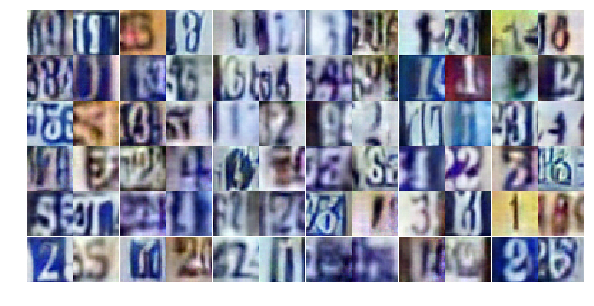

Epoch 18/25... Discriminator Loss: 0.4834... Generator Loss: 1.4283
Epoch 18/25... Discriminator Loss: 0.6426... Generator Loss: 1.2765
Epoch 18/25... Discriminator Loss: 0.7097... Generator Loss: 0.9855
Epoch 18/25... Discriminator Loss: 0.6789... Generator Loss: 1.4256
Epoch 18/25... Discriminator Loss: 1.2470... Generator Loss: 0.5028
Epoch 18/25... Discriminator Loss: 0.7628... Generator Loss: 1.0429
Epoch 18/25... Discriminator Loss: 0.8279... Generator Loss: 0.8863
Epoch 18/25... Discriminator Loss: 0.3856... Generator Loss: 1.7436
Epoch 18/25... Discriminator Loss: 1.0164... Generator Loss: 0.6476
Epoch 18/25... Discriminator Loss: 0.7950... Generator Loss: 0.9513


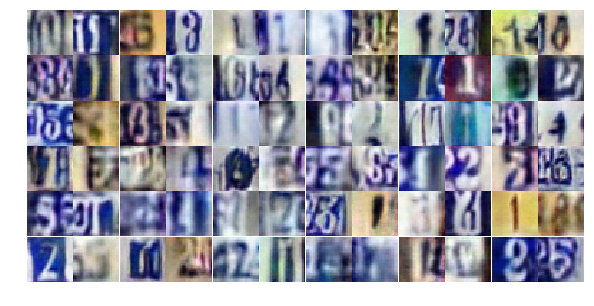

Epoch 18/25... Discriminator Loss: 0.4897... Generator Loss: 1.7777
Epoch 18/25... Discriminator Loss: 0.6662... Generator Loss: 1.2489
Epoch 18/25... Discriminator Loss: 0.9006... Generator Loss: 0.7291
Epoch 18/25... Discriminator Loss: 0.6758... Generator Loss: 1.1120
Epoch 18/25... Discriminator Loss: 0.9387... Generator Loss: 0.7947
Epoch 18/25... Discriminator Loss: 0.6514... Generator Loss: 1.0106
Epoch 18/25... Discriminator Loss: 0.9189... Generator Loss: 0.7060
Epoch 18/25... Discriminator Loss: 0.8138... Generator Loss: 1.9067
Epoch 18/25... Discriminator Loss: 1.1089... Generator Loss: 0.5802
Epoch 18/25... Discriminator Loss: 0.3796... Generator Loss: 1.6939


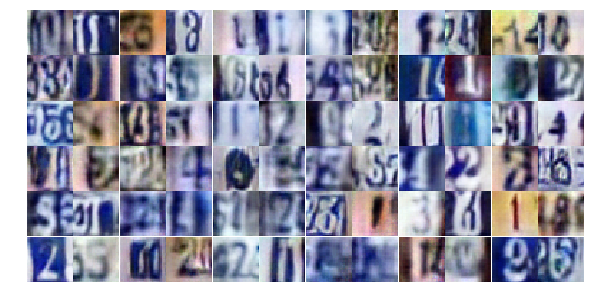

Epoch 18/25... Discriminator Loss: 0.5848... Generator Loss: 1.1906
Epoch 18/25... Discriminator Loss: 0.6176... Generator Loss: 1.3088
Epoch 18/25... Discriminator Loss: 0.6739... Generator Loss: 1.1505
Epoch 18/25... Discriminator Loss: 0.9122... Generator Loss: 0.8188
Epoch 18/25... Discriminator Loss: 0.5947... Generator Loss: 1.0826
Epoch 18/25... Discriminator Loss: 1.0030... Generator Loss: 0.7513
Epoch 18/25... Discriminator Loss: 0.6686... Generator Loss: 1.0582
Epoch 18/25... Discriminator Loss: 0.4132... Generator Loss: 1.9199
Epoch 18/25... Discriminator Loss: 1.1436... Generator Loss: 0.5868
Epoch 18/25... Discriminator Loss: 1.6623... Generator Loss: 0.3858


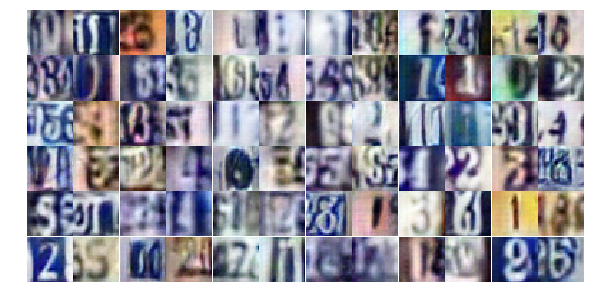

Epoch 18/25... Discriminator Loss: 0.7234... Generator Loss: 1.4456
Epoch 19/25... Discriminator Loss: 0.8521... Generator Loss: 0.8955
Epoch 19/25... Discriminator Loss: 0.8544... Generator Loss: 1.1112
Epoch 19/25... Discriminator Loss: 0.8776... Generator Loss: 0.8627
Epoch 19/25... Discriminator Loss: 0.7866... Generator Loss: 0.8429
Epoch 19/25... Discriminator Loss: 0.8006... Generator Loss: 0.9850
Epoch 19/25... Discriminator Loss: 0.8774... Generator Loss: 0.7589
Epoch 19/25... Discriminator Loss: 0.8978... Generator Loss: 0.8822
Epoch 19/25... Discriminator Loss: 0.6665... Generator Loss: 1.2322
Epoch 19/25... Discriminator Loss: 0.9004... Generator Loss: 0.7678


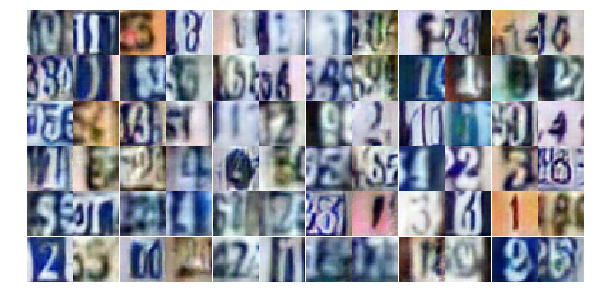

Epoch 19/25... Discriminator Loss: 0.5208... Generator Loss: 1.2660
Epoch 19/25... Discriminator Loss: 1.3722... Generator Loss: 0.4197
Epoch 19/25... Discriminator Loss: 0.8712... Generator Loss: 0.8732
Epoch 19/25... Discriminator Loss: 0.7969... Generator Loss: 0.8627
Epoch 19/25... Discriminator Loss: 1.1104... Generator Loss: 0.5664
Epoch 19/25... Discriminator Loss: 0.7598... Generator Loss: 0.9765
Epoch 19/25... Discriminator Loss: 0.8708... Generator Loss: 0.7706
Epoch 19/25... Discriminator Loss: 0.5447... Generator Loss: 1.4759
Epoch 19/25... Discriminator Loss: 0.9415... Generator Loss: 0.9596
Epoch 19/25... Discriminator Loss: 1.1734... Generator Loss: 0.5942


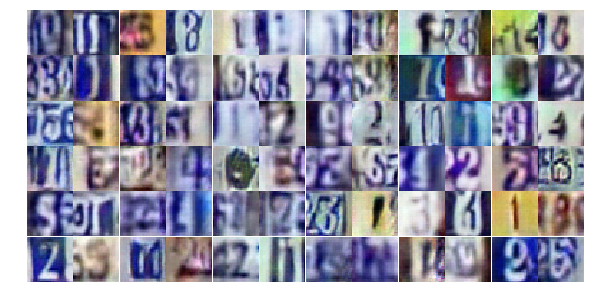

Epoch 19/25... Discriminator Loss: 0.6517... Generator Loss: 1.1409
Epoch 19/25... Discriminator Loss: 1.5093... Generator Loss: 0.3458
Epoch 19/25... Discriminator Loss: 1.3240... Generator Loss: 0.4751
Epoch 19/25... Discriminator Loss: 0.8617... Generator Loss: 0.7714
Epoch 19/25... Discriminator Loss: 1.3082... Generator Loss: 0.4712
Epoch 19/25... Discriminator Loss: 0.7069... Generator Loss: 1.6576
Epoch 19/25... Discriminator Loss: 1.1458... Generator Loss: 0.6692
Epoch 19/25... Discriminator Loss: 0.4158... Generator Loss: 1.5976
Epoch 19/25... Discriminator Loss: 0.5692... Generator Loss: 1.2734
Epoch 19/25... Discriminator Loss: 1.5053... Generator Loss: 0.3409


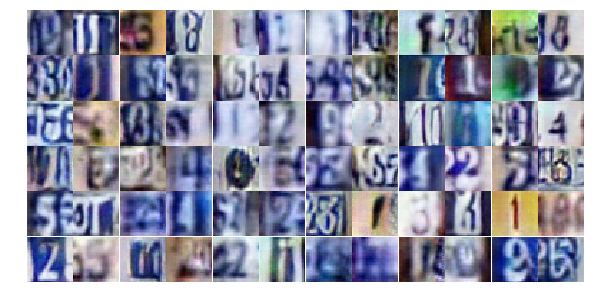

Epoch 19/25... Discriminator Loss: 0.6172... Generator Loss: 1.6162
Epoch 19/25... Discriminator Loss: 0.6240... Generator Loss: 1.1248
Epoch 19/25... Discriminator Loss: 0.8425... Generator Loss: 0.7973
Epoch 19/25... Discriminator Loss: 0.6390... Generator Loss: 1.0717
Epoch 19/25... Discriminator Loss: 0.6607... Generator Loss: 1.1687
Epoch 19/25... Discriminator Loss: 1.7382... Generator Loss: 0.2859
Epoch 19/25... Discriminator Loss: 1.4398... Generator Loss: 3.1618
Epoch 19/25... Discriminator Loss: 0.4953... Generator Loss: 1.7720
Epoch 19/25... Discriminator Loss: 0.8251... Generator Loss: 0.9924
Epoch 19/25... Discriminator Loss: 0.5716... Generator Loss: 1.5130


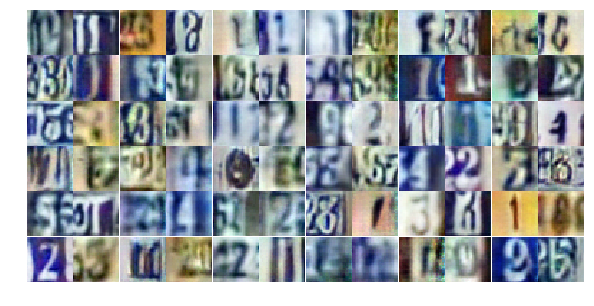

Epoch 19/25... Discriminator Loss: 0.7205... Generator Loss: 0.9614
Epoch 19/25... Discriminator Loss: 0.8876... Generator Loss: 0.8293
Epoch 19/25... Discriminator Loss: 0.9174... Generator Loss: 0.7015
Epoch 19/25... Discriminator Loss: 0.7391... Generator Loss: 0.9453
Epoch 19/25... Discriminator Loss: 0.8506... Generator Loss: 1.0053
Epoch 19/25... Discriminator Loss: 4.9303... Generator Loss: 6.9001
Epoch 19/25... Discriminator Loss: 0.4470... Generator Loss: 2.2928
Epoch 19/25... Discriminator Loss: 0.6114... Generator Loss: 1.2271
Epoch 19/25... Discriminator Loss: 0.8639... Generator Loss: 0.8997
Epoch 19/25... Discriminator Loss: 0.6598... Generator Loss: 1.4273


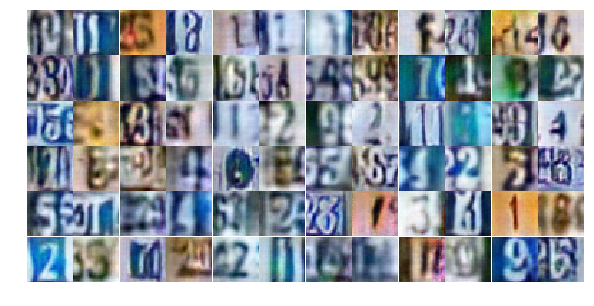

Epoch 19/25... Discriminator Loss: 0.8400... Generator Loss: 0.8201
Epoch 19/25... Discriminator Loss: 0.9156... Generator Loss: 0.8803
Epoch 19/25... Discriminator Loss: 0.6160... Generator Loss: 1.3826
Epoch 19/25... Discriminator Loss: 1.0381... Generator Loss: 0.6533
Epoch 19/25... Discriminator Loss: 1.2588... Generator Loss: 0.4500
Epoch 19/25... Discriminator Loss: 0.5876... Generator Loss: 1.3060
Epoch 19/25... Discriminator Loss: 2.7057... Generator Loss: 0.1503
Epoch 19/25... Discriminator Loss: 0.8832... Generator Loss: 0.7932
Epoch 20/25... Discriminator Loss: 0.6424... Generator Loss: 1.0467
Epoch 20/25... Discriminator Loss: 0.6438... Generator Loss: 1.0629


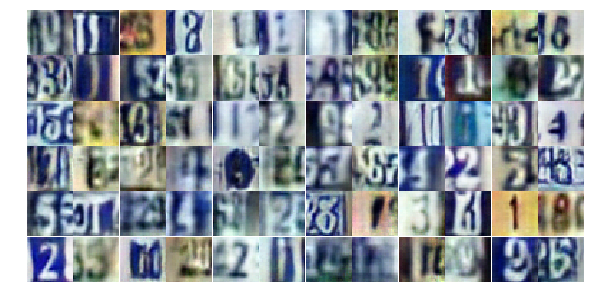

Epoch 20/25... Discriminator Loss: 0.7388... Generator Loss: 0.9497
Epoch 20/25... Discriminator Loss: 0.9410... Generator Loss: 0.7680
Epoch 20/25... Discriminator Loss: 0.8693... Generator Loss: 0.7729
Epoch 20/25... Discriminator Loss: 1.0460... Generator Loss: 0.6626
Epoch 20/25... Discriminator Loss: 0.4652... Generator Loss: 1.3821
Epoch 20/25... Discriminator Loss: 0.5858... Generator Loss: 1.2011
Epoch 20/25... Discriminator Loss: 0.6823... Generator Loss: 1.3836
Epoch 20/25... Discriminator Loss: 0.6648... Generator Loss: 1.4992
Epoch 20/25... Discriminator Loss: 0.9377... Generator Loss: 0.7295
Epoch 20/25... Discriminator Loss: 0.8918... Generator Loss: 0.7422


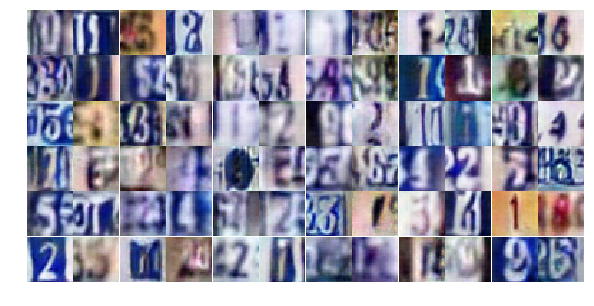

Epoch 20/25... Discriminator Loss: 1.6701... Generator Loss: 0.3729
Epoch 20/25... Discriminator Loss: 0.9364... Generator Loss: 0.7816
Epoch 20/25... Discriminator Loss: 0.6234... Generator Loss: 1.1731
Epoch 20/25... Discriminator Loss: 1.7883... Generator Loss: 0.3263
Epoch 20/25... Discriminator Loss: 1.3957... Generator Loss: 0.4383
Epoch 20/25... Discriminator Loss: 0.8868... Generator Loss: 0.8293
Epoch 20/25... Discriminator Loss: 0.9292... Generator Loss: 0.7924
Epoch 20/25... Discriminator Loss: 0.8711... Generator Loss: 0.8070
Epoch 20/25... Discriminator Loss: 0.5910... Generator Loss: 1.1495
Epoch 20/25... Discriminator Loss: 0.9296... Generator Loss: 0.7528


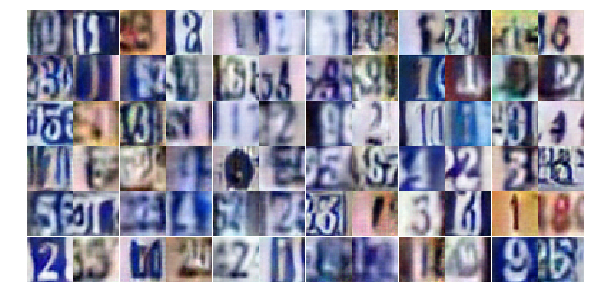

Epoch 20/25... Discriminator Loss: 0.6086... Generator Loss: 1.1178
Epoch 20/25... Discriminator Loss: 0.8042... Generator Loss: 0.8693
Epoch 20/25... Discriminator Loss: 0.3478... Generator Loss: 1.9860
Epoch 20/25... Discriminator Loss: 1.6376... Generator Loss: 0.3377
Epoch 20/25... Discriminator Loss: 0.7292... Generator Loss: 0.9434
Epoch 20/25... Discriminator Loss: 0.5982... Generator Loss: 1.1052
Epoch 20/25... Discriminator Loss: 0.5872... Generator Loss: 1.4825
Epoch 20/25... Discriminator Loss: 1.9499... Generator Loss: 0.2511
Epoch 20/25... Discriminator Loss: 1.0291... Generator Loss: 0.6695
Epoch 20/25... Discriminator Loss: 0.4505... Generator Loss: 1.4314


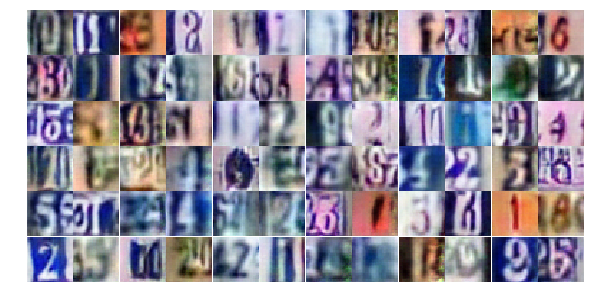

Epoch 20/25... Discriminator Loss: 0.9497... Generator Loss: 0.7365
Epoch 20/25... Discriminator Loss: 0.7456... Generator Loss: 0.9325
Epoch 20/25... Discriminator Loss: 1.1370... Generator Loss: 0.5686
Epoch 20/25... Discriminator Loss: 0.6771... Generator Loss: 1.5407
Epoch 20/25... Discriminator Loss: 0.7402... Generator Loss: 1.0349
Epoch 20/25... Discriminator Loss: 0.6060... Generator Loss: 1.2416
Epoch 20/25... Discriminator Loss: 0.8702... Generator Loss: 0.8268
Epoch 20/25... Discriminator Loss: 1.2376... Generator Loss: 0.5192
Epoch 20/25... Discriminator Loss: 0.9515... Generator Loss: 0.7865
Epoch 20/25... Discriminator Loss: 0.7089... Generator Loss: 1.0485


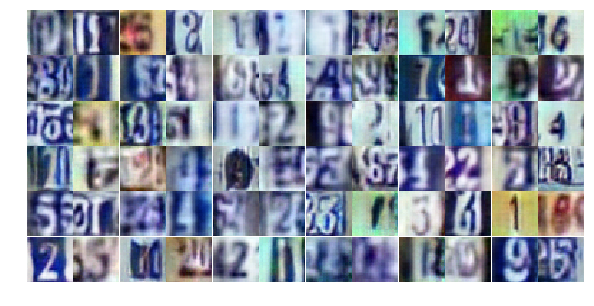

Epoch 20/25... Discriminator Loss: 1.2896... Generator Loss: 0.5404
Epoch 20/25... Discriminator Loss: 0.7057... Generator Loss: 1.0769
Epoch 20/25... Discriminator Loss: 0.7273... Generator Loss: 1.1025
Epoch 20/25... Discriminator Loss: 0.6711... Generator Loss: 1.1780
Epoch 20/25... Discriminator Loss: 0.8758... Generator Loss: 0.8292
Epoch 20/25... Discriminator Loss: 0.7515... Generator Loss: 0.9558
Epoch 20/25... Discriminator Loss: 0.8828... Generator Loss: 0.7816
Epoch 20/25... Discriminator Loss: 0.5243... Generator Loss: 1.3779
Epoch 20/25... Discriminator Loss: 0.6163... Generator Loss: 1.5780
Epoch 20/25... Discriminator Loss: 1.0076... Generator Loss: 0.7167


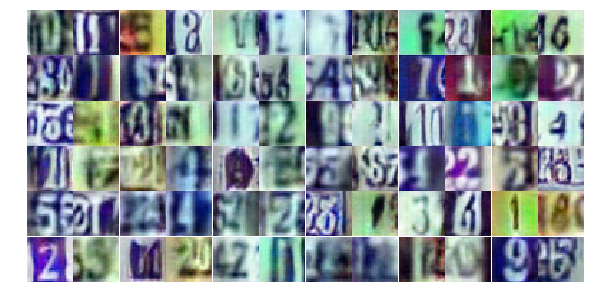

Epoch 20/25... Discriminator Loss: 0.5752... Generator Loss: 1.4119
Epoch 20/25... Discriminator Loss: 0.6433... Generator Loss: 1.3821
Epoch 20/25... Discriminator Loss: 0.4672... Generator Loss: 2.1823
Epoch 20/25... Discriminator Loss: 0.7774... Generator Loss: 0.9732
Epoch 20/25... Discriminator Loss: 0.5163... Generator Loss: 1.4193
Epoch 20/25... Discriminator Loss: 0.5284... Generator Loss: 1.2925
Epoch 21/25... Discriminator Loss: 1.0651... Generator Loss: 0.6756
Epoch 21/25... Discriminator Loss: 0.8080... Generator Loss: 0.9609
Epoch 21/25... Discriminator Loss: 0.8426... Generator Loss: 0.9776
Epoch 21/25... Discriminator Loss: 1.2856... Generator Loss: 0.5100


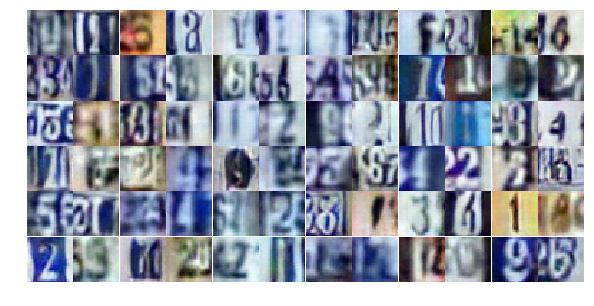

Epoch 21/25... Discriminator Loss: 1.4204... Generator Loss: 0.4840
Epoch 21/25... Discriminator Loss: 1.8523... Generator Loss: 0.2361
Epoch 21/25... Discriminator Loss: 0.4668... Generator Loss: 1.6847
Epoch 21/25... Discriminator Loss: 0.5453... Generator Loss: 1.1770
Epoch 21/25... Discriminator Loss: 1.3390... Generator Loss: 0.4387
Epoch 21/25... Discriminator Loss: 0.5860... Generator Loss: 1.1409
Epoch 21/25... Discriminator Loss: 0.8411... Generator Loss: 0.8316
Epoch 21/25... Discriminator Loss: 1.0559... Generator Loss: 0.6419
Epoch 21/25... Discriminator Loss: 0.7284... Generator Loss: 0.9173
Epoch 21/25... Discriminator Loss: 1.1510... Generator Loss: 0.5362


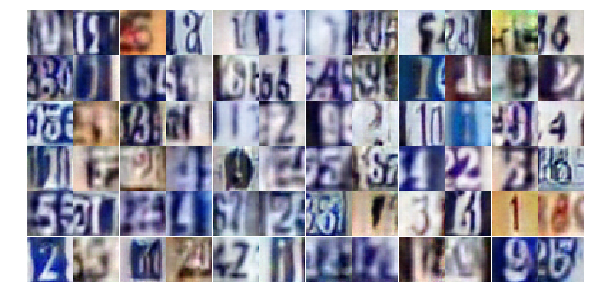

Epoch 21/25... Discriminator Loss: 0.3566... Generator Loss: 2.1308
Epoch 21/25... Discriminator Loss: 1.8202... Generator Loss: 0.2840
Epoch 21/25... Discriminator Loss: 1.3221... Generator Loss: 0.5614
Epoch 21/25... Discriminator Loss: 0.7275... Generator Loss: 1.2255
Epoch 21/25... Discriminator Loss: 0.5066... Generator Loss: 1.4209
Epoch 21/25... Discriminator Loss: 1.1345... Generator Loss: 0.5447
Epoch 21/25... Discriminator Loss: 1.0039... Generator Loss: 0.6597
Epoch 21/25... Discriminator Loss: 0.5660... Generator Loss: 1.1293
Epoch 21/25... Discriminator Loss: 0.6422... Generator Loss: 1.0000
Epoch 21/25... Discriminator Loss: 0.8757... Generator Loss: 0.7853


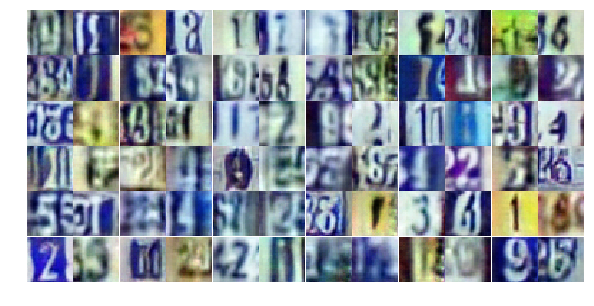

Epoch 21/25... Discriminator Loss: 0.8774... Generator Loss: 0.7929
Epoch 21/25... Discriminator Loss: 0.4739... Generator Loss: 1.4760
Epoch 21/25... Discriminator Loss: 0.9471... Generator Loss: 0.6928
Epoch 21/25... Discriminator Loss: 1.0884... Generator Loss: 0.5885
Epoch 21/25... Discriminator Loss: 1.1083... Generator Loss: 0.5424
Epoch 21/25... Discriminator Loss: 0.7895... Generator Loss: 1.2672
Epoch 21/25... Discriminator Loss: 0.6053... Generator Loss: 1.0547
Epoch 21/25... Discriminator Loss: 0.9991... Generator Loss: 0.6993
Epoch 21/25... Discriminator Loss: 1.3240... Generator Loss: 0.5163
Epoch 21/25... Discriminator Loss: 1.2626... Generator Loss: 0.5154


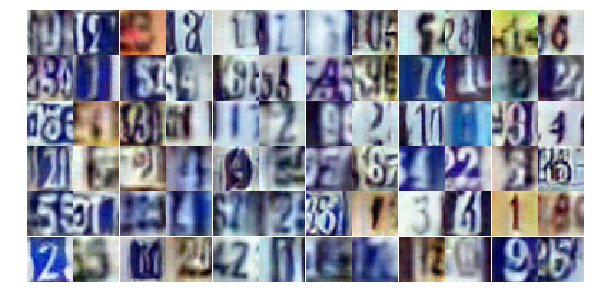

Epoch 21/25... Discriminator Loss: 1.2789... Generator Loss: 0.4789
Epoch 21/25... Discriminator Loss: 0.7464... Generator Loss: 0.9453
Epoch 21/25... Discriminator Loss: 1.1273... Generator Loss: 0.5617
Epoch 21/25... Discriminator Loss: 0.4960... Generator Loss: 1.3135
Epoch 21/25... Discriminator Loss: 0.6380... Generator Loss: 1.0698
Epoch 21/25... Discriminator Loss: 0.6655... Generator Loss: 1.1505
Epoch 21/25... Discriminator Loss: 1.1237... Generator Loss: 0.5467
Epoch 21/25... Discriminator Loss: 1.1174... Generator Loss: 0.5607
Epoch 21/25... Discriminator Loss: 0.7043... Generator Loss: 1.0175
Epoch 21/25... Discriminator Loss: 0.2762... Generator Loss: 2.1916


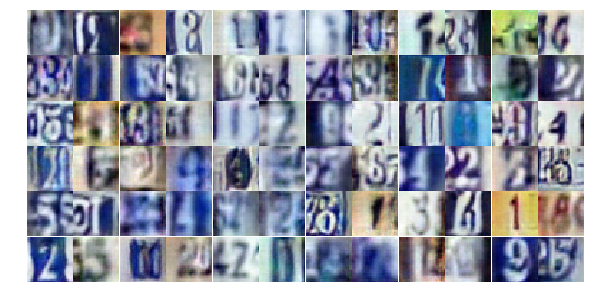

Epoch 21/25... Discriminator Loss: 0.6343... Generator Loss: 1.2372
Epoch 21/25... Discriminator Loss: 1.3569... Generator Loss: 0.5843
Epoch 21/25... Discriminator Loss: 0.5975... Generator Loss: 1.1553
Epoch 21/25... Discriminator Loss: 1.0032... Generator Loss: 0.7540
Epoch 21/25... Discriminator Loss: 0.3859... Generator Loss: 1.6047
Epoch 21/25... Discriminator Loss: 0.7776... Generator Loss: 0.9112
Epoch 21/25... Discriminator Loss: 0.8800... Generator Loss: 0.7904
Epoch 21/25... Discriminator Loss: 1.3502... Generator Loss: 0.5323
Epoch 21/25... Discriminator Loss: 0.6878... Generator Loss: 0.9670
Epoch 21/25... Discriminator Loss: 0.5545... Generator Loss: 1.1750


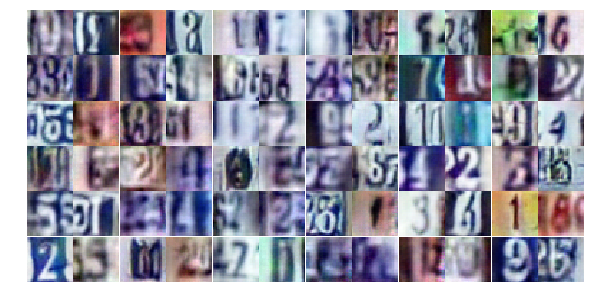

Epoch 21/25... Discriminator Loss: 0.5903... Generator Loss: 1.2381
Epoch 21/25... Discriminator Loss: 0.8691... Generator Loss: 1.0955
Epoch 21/25... Discriminator Loss: 0.6320... Generator Loss: 1.0397
Epoch 22/25... Discriminator Loss: 0.8336... Generator Loss: 1.0026
Epoch 22/25... Discriminator Loss: 1.0803... Generator Loss: 0.6594
Epoch 22/25... Discriminator Loss: 0.7305... Generator Loss: 0.9956
Epoch 22/25... Discriminator Loss: 0.7363... Generator Loss: 1.0360
Epoch 22/25... Discriminator Loss: 0.5944... Generator Loss: 1.1498
Epoch 22/25... Discriminator Loss: 1.0133... Generator Loss: 0.6399
Epoch 22/25... Discriminator Loss: 0.8482... Generator Loss: 0.9303


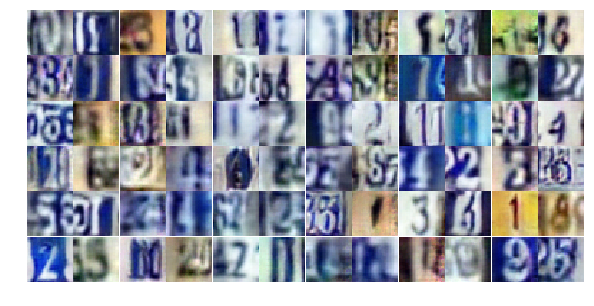

Epoch 22/25... Discriminator Loss: 0.4463... Generator Loss: 1.8715
Epoch 22/25... Discriminator Loss: 0.8839... Generator Loss: 0.8205
Epoch 22/25... Discriminator Loss: 1.3890... Generator Loss: 0.3992
Epoch 22/25... Discriminator Loss: 0.7491... Generator Loss: 0.9315
Epoch 22/25... Discriminator Loss: 1.3769... Generator Loss: 0.4202
Epoch 22/25... Discriminator Loss: 0.5913... Generator Loss: 1.3213
Epoch 22/25... Discriminator Loss: 0.6714... Generator Loss: 1.2548
Epoch 22/25... Discriminator Loss: 0.8415... Generator Loss: 0.9261
Epoch 22/25... Discriminator Loss: 1.5612... Generator Loss: 0.5471
Epoch 22/25... Discriminator Loss: 1.1154... Generator Loss: 0.6657


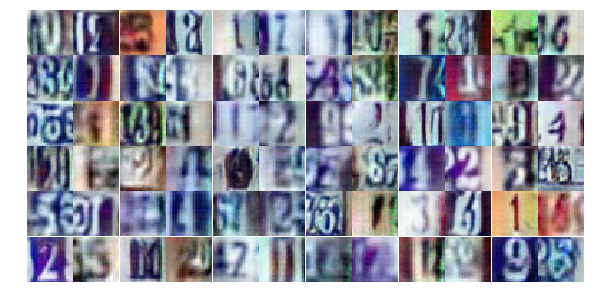

Epoch 22/25... Discriminator Loss: 0.5460... Generator Loss: 1.4745
Epoch 22/25... Discriminator Loss: 0.8433... Generator Loss: 0.7320
Epoch 22/25... Discriminator Loss: 0.9632... Generator Loss: 0.6977
Epoch 22/25... Discriminator Loss: 0.5402... Generator Loss: 1.3195
Epoch 22/25... Discriminator Loss: 0.7886... Generator Loss: 1.0299
Epoch 22/25... Discriminator Loss: 0.8576... Generator Loss: 0.8713
Epoch 22/25... Discriminator Loss: 0.6541... Generator Loss: 2.4387
Epoch 22/25... Discriminator Loss: 0.5126... Generator Loss: 1.3447
Epoch 22/25... Discriminator Loss: 0.6891... Generator Loss: 0.9273
Epoch 22/25... Discriminator Loss: 1.2078... Generator Loss: 0.5061


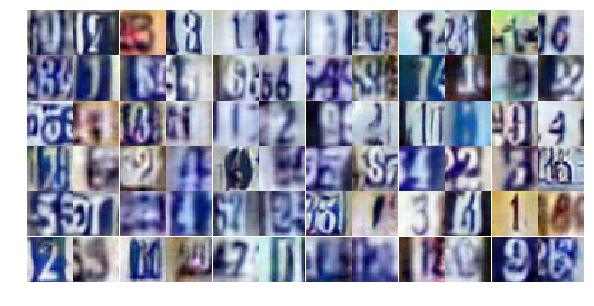

Epoch 22/25... Discriminator Loss: 0.4161... Generator Loss: 1.4618
Epoch 22/25... Discriminator Loss: 0.4441... Generator Loss: 2.2690
Epoch 22/25... Discriminator Loss: 0.9973... Generator Loss: 0.7401
Epoch 22/25... Discriminator Loss: 0.8774... Generator Loss: 0.7783
Epoch 22/25... Discriminator Loss: 0.7294... Generator Loss: 1.2982
Epoch 22/25... Discriminator Loss: 0.7937... Generator Loss: 0.9822
Epoch 22/25... Discriminator Loss: 2.0176... Generator Loss: 0.2079
Epoch 22/25... Discriminator Loss: 0.5785... Generator Loss: 1.3067
Epoch 22/25... Discriminator Loss: 0.7413... Generator Loss: 0.9703
Epoch 22/25... Discriminator Loss: 1.1173... Generator Loss: 0.6347


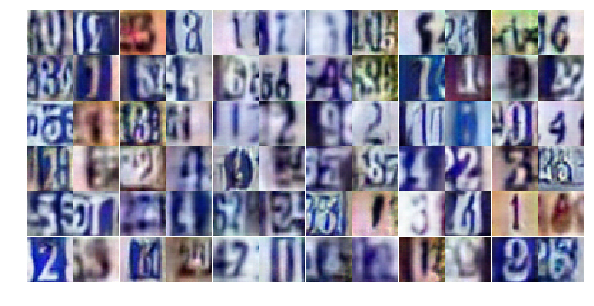

Epoch 22/25... Discriminator Loss: 0.8348... Generator Loss: 0.8369
Epoch 22/25... Discriminator Loss: 0.5924... Generator Loss: 1.6512
Epoch 22/25... Discriminator Loss: 0.5048... Generator Loss: 1.4847
Epoch 22/25... Discriminator Loss: 1.0864... Generator Loss: 4.3051
Epoch 22/25... Discriminator Loss: 0.6495... Generator Loss: 1.5204
Epoch 22/25... Discriminator Loss: 0.4774... Generator Loss: 1.3526
Epoch 22/25... Discriminator Loss: 0.8122... Generator Loss: 0.9567
Epoch 22/25... Discriminator Loss: 0.6972... Generator Loss: 1.2021
Epoch 22/25... Discriminator Loss: 1.1974... Generator Loss: 0.5895
Epoch 22/25... Discriminator Loss: 0.9594... Generator Loss: 0.8125


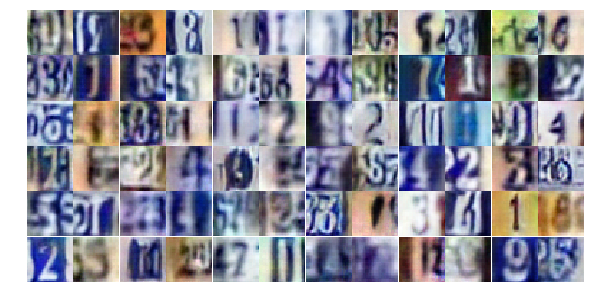

Epoch 22/25... Discriminator Loss: 1.1565... Generator Loss: 0.5529
Epoch 22/25... Discriminator Loss: 0.6010... Generator Loss: 1.0907
Epoch 22/25... Discriminator Loss: 0.7998... Generator Loss: 0.8941
Epoch 22/25... Discriminator Loss: 0.8827... Generator Loss: 0.9998
Epoch 22/25... Discriminator Loss: 0.6136... Generator Loss: 1.1674
Epoch 22/25... Discriminator Loss: 0.8601... Generator Loss: 0.8929
Epoch 22/25... Discriminator Loss: 0.9861... Generator Loss: 0.7544
Epoch 22/25... Discriminator Loss: 0.6143... Generator Loss: 1.0881
Epoch 22/25... Discriminator Loss: 1.4304... Generator Loss: 3.2386
Epoch 22/25... Discriminator Loss: 1.0805... Generator Loss: 0.6065


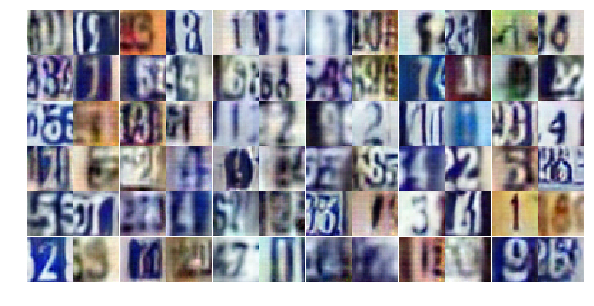

Epoch 23/25... Discriminator Loss: 0.6401... Generator Loss: 1.2607
Epoch 23/25... Discriminator Loss: 0.4335... Generator Loss: 1.5728
Epoch 23/25... Discriminator Loss: 1.1273... Generator Loss: 0.5837
Epoch 23/25... Discriminator Loss: 0.7489... Generator Loss: 0.9617
Epoch 23/25... Discriminator Loss: 0.6980... Generator Loss: 1.0167
Epoch 23/25... Discriminator Loss: 1.5840... Generator Loss: 0.3286
Epoch 23/25... Discriminator Loss: 1.1197... Generator Loss: 0.7031
Epoch 23/25... Discriminator Loss: 0.8220... Generator Loss: 0.9210
Epoch 23/25... Discriminator Loss: 0.7118... Generator Loss: 1.0037
Epoch 23/25... Discriminator Loss: 0.4627... Generator Loss: 1.2992


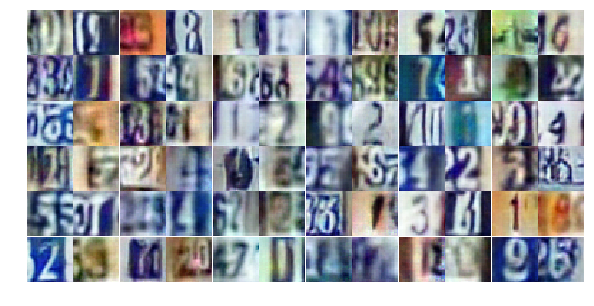

Epoch 23/25... Discriminator Loss: 0.5478... Generator Loss: 1.1620
Epoch 23/25... Discriminator Loss: 1.0326... Generator Loss: 0.6828
Epoch 23/25... Discriminator Loss: 0.7523... Generator Loss: 0.8526
Epoch 23/25... Discriminator Loss: 0.7898... Generator Loss: 0.9101
Epoch 23/25... Discriminator Loss: 0.6454... Generator Loss: 2.1622
Epoch 23/25... Discriminator Loss: 0.7660... Generator Loss: 1.0920
Epoch 23/25... Discriminator Loss: 0.9059... Generator Loss: 0.6805
Epoch 23/25... Discriminator Loss: 0.9466... Generator Loss: 0.9233
Epoch 23/25... Discriminator Loss: 0.9948... Generator Loss: 0.8220
Epoch 23/25... Discriminator Loss: 0.5802... Generator Loss: 1.3024


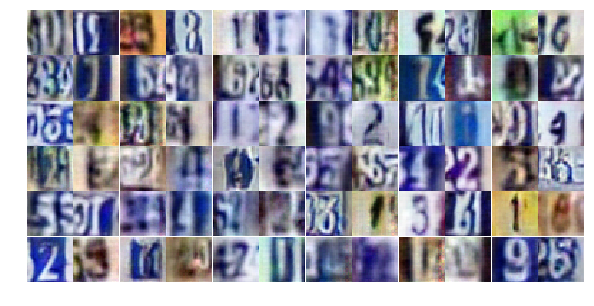

Epoch 23/25... Discriminator Loss: 1.3235... Generator Loss: 0.4741
Epoch 23/25... Discriminator Loss: 0.6975... Generator Loss: 1.0366
Epoch 23/25... Discriminator Loss: 1.0057... Generator Loss: 0.6855
Epoch 23/25... Discriminator Loss: 0.8417... Generator Loss: 0.8174
Epoch 23/25... Discriminator Loss: 0.5254... Generator Loss: 1.4914
Epoch 23/25... Discriminator Loss: 0.6152... Generator Loss: 2.4276
Epoch 23/25... Discriminator Loss: 0.7237... Generator Loss: 0.9524
Epoch 23/25... Discriminator Loss: 0.7630... Generator Loss: 0.9920
Epoch 23/25... Discriminator Loss: 0.8045... Generator Loss: 0.9200
Epoch 23/25... Discriminator Loss: 0.8763... Generator Loss: 1.9191


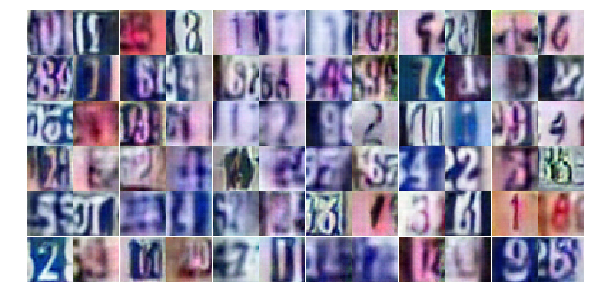

Epoch 23/25... Discriminator Loss: 0.4922... Generator Loss: 1.4025
Epoch 23/25... Discriminator Loss: 0.5100... Generator Loss: 1.4154
Epoch 23/25... Discriminator Loss: 0.7114... Generator Loss: 1.0884
Epoch 23/25... Discriminator Loss: 1.7320... Generator Loss: 0.3142
Epoch 23/25... Discriminator Loss: 0.6689... Generator Loss: 1.1813
Epoch 23/25... Discriminator Loss: 0.9922... Generator Loss: 0.7463
Epoch 23/25... Discriminator Loss: 1.5632... Generator Loss: 0.3641
Epoch 23/25... Discriminator Loss: 0.4801... Generator Loss: 1.4495
Epoch 23/25... Discriminator Loss: 0.7111... Generator Loss: 0.9468
Epoch 23/25... Discriminator Loss: 0.6317... Generator Loss: 1.4663


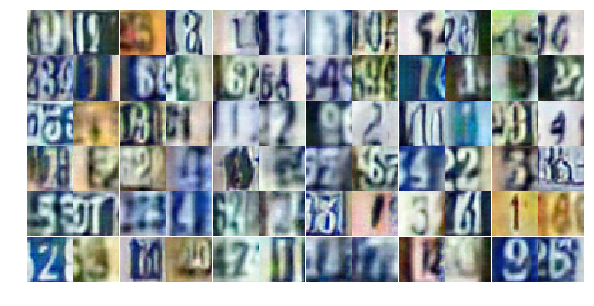

Epoch 23/25... Discriminator Loss: 1.2733... Generator Loss: 0.4432
Epoch 23/25... Discriminator Loss: 0.6894... Generator Loss: 1.0377
Epoch 23/25... Discriminator Loss: 0.9340... Generator Loss: 0.7061
Epoch 23/25... Discriminator Loss: 0.6880... Generator Loss: 1.0331
Epoch 23/25... Discriminator Loss: 0.7643... Generator Loss: 0.9172
Epoch 23/25... Discriminator Loss: 0.6914... Generator Loss: 1.1270
Epoch 23/25... Discriminator Loss: 0.7684... Generator Loss: 0.9679
Epoch 23/25... Discriminator Loss: 1.2618... Generator Loss: 0.4825
Epoch 23/25... Discriminator Loss: 0.6572... Generator Loss: 1.0807
Epoch 23/25... Discriminator Loss: 1.1788... Generator Loss: 0.6492


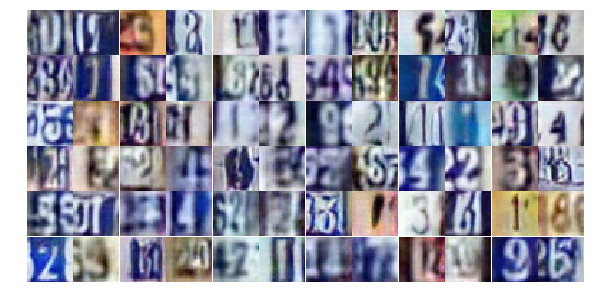

Epoch 23/25... Discriminator Loss: 0.5843... Generator Loss: 1.4801
Epoch 23/25... Discriminator Loss: 1.0207... Generator Loss: 0.6475
Epoch 23/25... Discriminator Loss: 1.5561... Generator Loss: 0.4314
Epoch 23/25... Discriminator Loss: 0.4092... Generator Loss: 1.6490
Epoch 23/25... Discriminator Loss: 1.9685... Generator Loss: 0.2211
Epoch 23/25... Discriminator Loss: 0.8828... Generator Loss: 0.7274
Epoch 23/25... Discriminator Loss: 1.1603... Generator Loss: 0.5645
Epoch 24/25... Discriminator Loss: 0.8445... Generator Loss: 0.7997
Epoch 24/25... Discriminator Loss: 1.2049... Generator Loss: 0.5661
Epoch 24/25... Discriminator Loss: 0.9480... Generator Loss: 1.5557


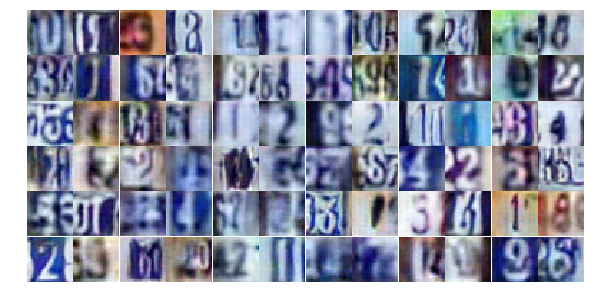

Epoch 24/25... Discriminator Loss: 0.5437... Generator Loss: 1.5228
Epoch 24/25... Discriminator Loss: 0.5063... Generator Loss: 1.4738
Epoch 24/25... Discriminator Loss: 0.6512... Generator Loss: 1.0908
Epoch 24/25... Discriminator Loss: 0.6012... Generator Loss: 2.1490
Epoch 24/25... Discriminator Loss: 0.4963... Generator Loss: 1.2963
Epoch 24/25... Discriminator Loss: 0.5568... Generator Loss: 1.3456
Epoch 24/25... Discriminator Loss: 0.7300... Generator Loss: 1.0544
Epoch 24/25... Discriminator Loss: 1.2459... Generator Loss: 0.5033
Epoch 24/25... Discriminator Loss: 0.3646... Generator Loss: 1.7132
Epoch 24/25... Discriminator Loss: 0.4957... Generator Loss: 2.1714


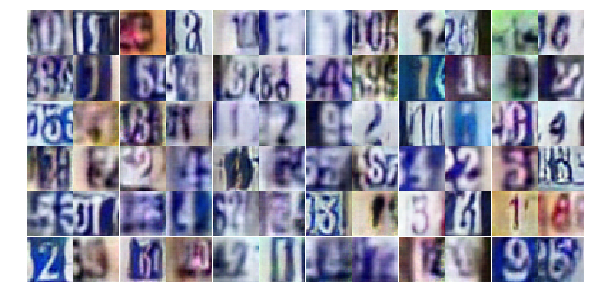

Epoch 24/25... Discriminator Loss: 2.4907... Generator Loss: 0.1954
Epoch 24/25... Discriminator Loss: 1.1908... Generator Loss: 0.7169
Epoch 24/25... Discriminator Loss: 1.0456... Generator Loss: 0.6960
Epoch 24/25... Discriminator Loss: 0.5944... Generator Loss: 1.0919
Epoch 24/25... Discriminator Loss: 0.9920... Generator Loss: 0.7155
Epoch 24/25... Discriminator Loss: 1.1061... Generator Loss: 0.5984
Epoch 24/25... Discriminator Loss: 0.8904... Generator Loss: 0.7287
Epoch 24/25... Discriminator Loss: 0.7962... Generator Loss: 0.9258
Epoch 24/25... Discriminator Loss: 0.9467... Generator Loss: 0.7065
Epoch 24/25... Discriminator Loss: 0.8339... Generator Loss: 0.9290


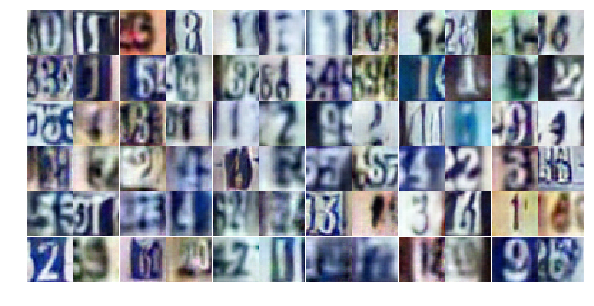

Epoch 24/25... Discriminator Loss: 0.7841... Generator Loss: 0.9301
Epoch 24/25... Discriminator Loss: 0.6559... Generator Loss: 1.0595
Epoch 24/25... Discriminator Loss: 0.7095... Generator Loss: 0.9975
Epoch 24/25... Discriminator Loss: 1.4640... Generator Loss: 0.3841
Epoch 24/25... Discriminator Loss: 0.7424... Generator Loss: 0.9162
Epoch 24/25... Discriminator Loss: 0.5263... Generator Loss: 1.2873
Epoch 24/25... Discriminator Loss: 0.4581... Generator Loss: 1.3466
Epoch 24/25... Discriminator Loss: 0.6244... Generator Loss: 1.1664
Epoch 24/25... Discriminator Loss: 0.7507... Generator Loss: 0.9603
Epoch 24/25... Discriminator Loss: 0.9494... Generator Loss: 0.6997


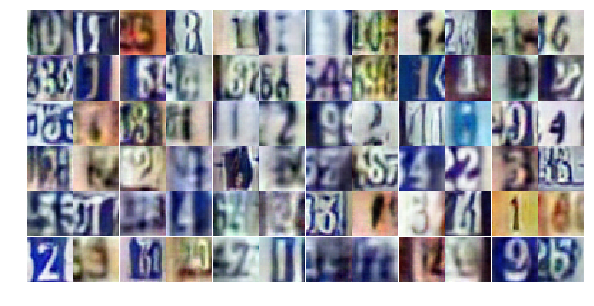

Epoch 24/25... Discriminator Loss: 0.4791... Generator Loss: 1.4250
Epoch 24/25... Discriminator Loss: 0.6760... Generator Loss: 0.9758
Epoch 24/25... Discriminator Loss: 1.0482... Generator Loss: 0.6207
Epoch 24/25... Discriminator Loss: 1.7384... Generator Loss: 0.3091
Epoch 24/25... Discriminator Loss: 0.7921... Generator Loss: 1.0892
Epoch 24/25... Discriminator Loss: 0.9241... Generator Loss: 0.7603
Epoch 24/25... Discriminator Loss: 1.3236... Generator Loss: 0.4601
Epoch 24/25... Discriminator Loss: 1.1565... Generator Loss: 0.5904
Epoch 24/25... Discriminator Loss: 1.3526... Generator Loss: 0.4514
Epoch 24/25... Discriminator Loss: 0.7220... Generator Loss: 1.7647


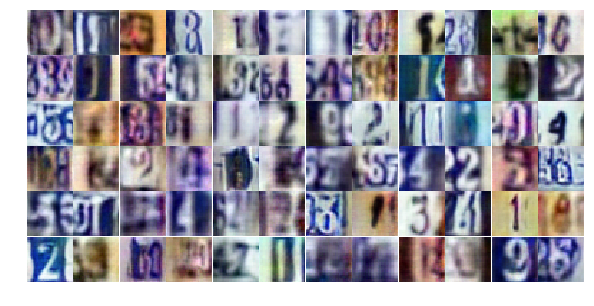

Epoch 24/25... Discriminator Loss: 0.6756... Generator Loss: 1.1404
Epoch 24/25... Discriminator Loss: 1.2136... Generator Loss: 0.5805
Epoch 24/25... Discriminator Loss: 0.7811... Generator Loss: 1.4975
Epoch 24/25... Discriminator Loss: 1.1224... Generator Loss: 0.6439
Epoch 24/25... Discriminator Loss: 1.4294... Generator Loss: 0.4365
Epoch 24/25... Discriminator Loss: 0.7055... Generator Loss: 1.0717
Epoch 24/25... Discriminator Loss: 0.9710... Generator Loss: 0.6756
Epoch 24/25... Discriminator Loss: 0.6733... Generator Loss: 0.9872
Epoch 24/25... Discriminator Loss: 0.9492... Generator Loss: 0.7241
Epoch 24/25... Discriminator Loss: 1.0779... Generator Loss: 0.7157


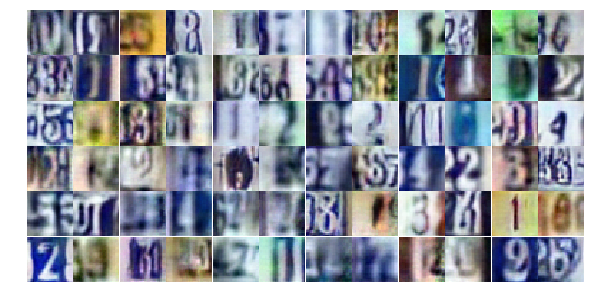

Epoch 24/25... Discriminator Loss: 0.9535... Generator Loss: 0.6409
Epoch 24/25... Discriminator Loss: 1.4662... Generator Loss: 0.4107
Epoch 24/25... Discriminator Loss: 0.7098... Generator Loss: 0.9726
Epoch 24/25... Discriminator Loss: 0.6482... Generator Loss: 1.3070
Epoch 24/25... Discriminator Loss: 0.9297... Generator Loss: 0.7044
Epoch 25/25... Discriminator Loss: 0.8184... Generator Loss: 0.8708
Epoch 25/25... Discriminator Loss: 0.4828... Generator Loss: 1.5554
Epoch 25/25... Discriminator Loss: 0.6416... Generator Loss: 1.0403
Epoch 25/25... Discriminator Loss: 0.9102... Generator Loss: 0.7913
Epoch 25/25... Discriminator Loss: 0.5756... Generator Loss: 1.2329


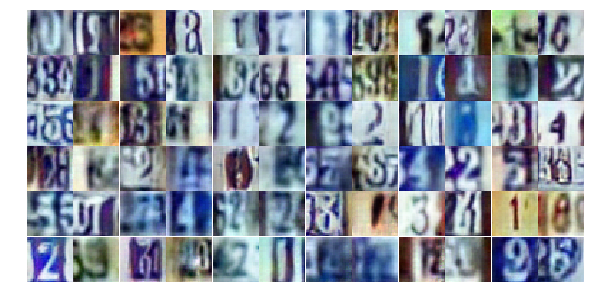

Epoch 25/25... Discriminator Loss: 1.0434... Generator Loss: 0.6233
Epoch 25/25... Discriminator Loss: 1.0971... Generator Loss: 0.6222
Epoch 25/25... Discriminator Loss: 1.3242... Generator Loss: 0.4529
Epoch 25/25... Discriminator Loss: 0.8709... Generator Loss: 2.2669
Epoch 25/25... Discriminator Loss: 1.1435... Generator Loss: 0.6470
Epoch 25/25... Discriminator Loss: 1.0623... Generator Loss: 0.6450
Epoch 25/25... Discriminator Loss: 0.8291... Generator Loss: 0.8179
Epoch 25/25... Discriminator Loss: 1.3539... Generator Loss: 0.5032
Epoch 25/25... Discriminator Loss: 0.5233... Generator Loss: 1.4842
Epoch 25/25... Discriminator Loss: 0.9378... Generator Loss: 0.8077


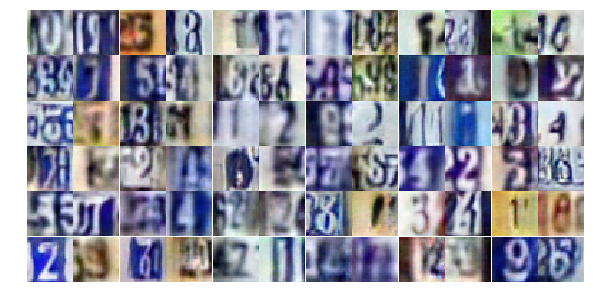

Epoch 25/25... Discriminator Loss: 0.6845... Generator Loss: 1.1322
Epoch 25/25... Discriminator Loss: 0.8027... Generator Loss: 2.8707
Epoch 25/25... Discriminator Loss: 1.2778... Generator Loss: 0.5122
Epoch 25/25... Discriminator Loss: 0.9918... Generator Loss: 0.6828
Epoch 25/25... Discriminator Loss: 0.6624... Generator Loss: 1.2057
Epoch 25/25... Discriminator Loss: 0.6055... Generator Loss: 1.2362
Epoch 25/25... Discriminator Loss: 0.8629... Generator Loss: 0.8328
Epoch 25/25... Discriminator Loss: 0.9749... Generator Loss: 1.5013
Epoch 25/25... Discriminator Loss: 0.4473... Generator Loss: 1.6004
Epoch 25/25... Discriminator Loss: 0.9638... Generator Loss: 0.7198


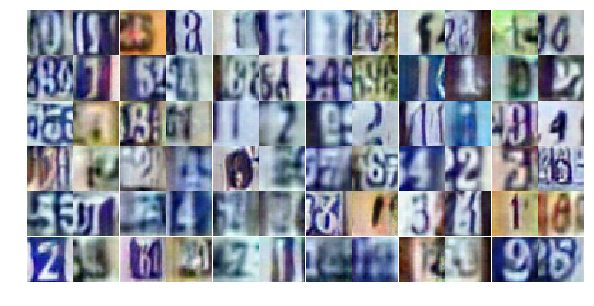

Epoch 25/25... Discriminator Loss: 1.2180... Generator Loss: 0.4823
Epoch 25/25... Discriminator Loss: 0.8255... Generator Loss: 0.8016
Epoch 25/25... Discriminator Loss: 1.1479... Generator Loss: 0.6688
Epoch 25/25... Discriminator Loss: 0.7013... Generator Loss: 1.0883
Epoch 25/25... Discriminator Loss: 0.7753... Generator Loss: 0.8991
Epoch 25/25... Discriminator Loss: 0.6534... Generator Loss: 1.0017
Epoch 25/25... Discriminator Loss: 0.6432... Generator Loss: 1.3489
Epoch 25/25... Discriminator Loss: 0.8609... Generator Loss: 0.7843
Epoch 25/25... Discriminator Loss: 0.7526... Generator Loss: 1.5393
Epoch 25/25... Discriminator Loss: 0.4458... Generator Loss: 1.4788


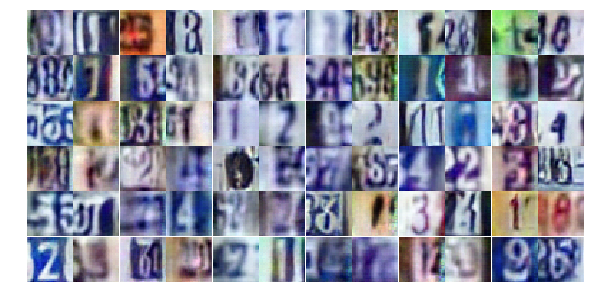

Epoch 25/25... Discriminator Loss: 0.8261... Generator Loss: 0.7958
Epoch 25/25... Discriminator Loss: 0.3981... Generator Loss: 1.6319
Epoch 25/25... Discriminator Loss: 0.6529... Generator Loss: 1.0806
Epoch 25/25... Discriminator Loss: 0.7784... Generator Loss: 0.8612
Epoch 25/25... Discriminator Loss: 1.1659... Generator Loss: 0.5361
Epoch 25/25... Discriminator Loss: 0.8431... Generator Loss: 0.8773
Epoch 25/25... Discriminator Loss: 0.5481... Generator Loss: 1.5035
Epoch 25/25... Discriminator Loss: 0.5369... Generator Loss: 1.1609
Epoch 25/25... Discriminator Loss: 2.0724... Generator Loss: 0.1973
Epoch 25/25... Discriminator Loss: 0.4622... Generator Loss: 1.5456


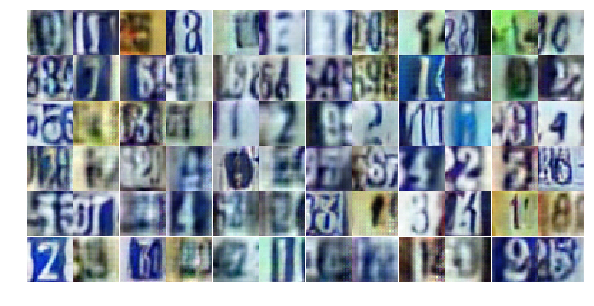

Epoch 25/25... Discriminator Loss: 4.0635... Generator Loss: 5.1822
Epoch 25/25... Discriminator Loss: 1.4308... Generator Loss: 0.4431
Epoch 25/25... Discriminator Loss: 0.8490... Generator Loss: 1.0677
Epoch 25/25... Discriminator Loss: 1.1075... Generator Loss: 0.6171
Epoch 25/25... Discriminator Loss: 1.0576... Generator Loss: 0.6860
Epoch 25/25... Discriminator Loss: 0.6524... Generator Loss: 0.9774
Epoch 25/25... Discriminator Loss: 1.1347... Generator Loss: 0.5552
Epoch 25/25... Discriminator Loss: 0.7165... Generator Loss: 0.9972
Epoch 25/25... Discriminator Loss: 0.8092... Generator Loss: 0.8284
Epoch 25/25... Discriminator Loss: 0.9311... Generator Loss: 0.7183


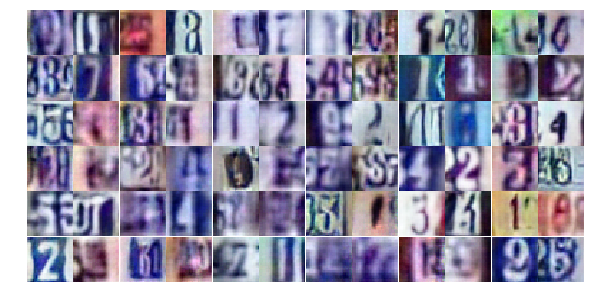

Epoch 25/25... Discriminator Loss: 0.4797... Generator Loss: 1.6768
Epoch 25/25... Discriminator Loss: 1.2506... Generator Loss: 0.5682


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

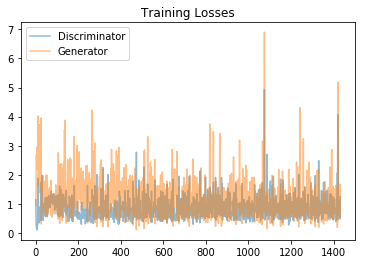

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

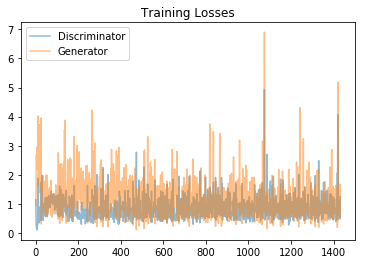

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/home/ubuntu/miniconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


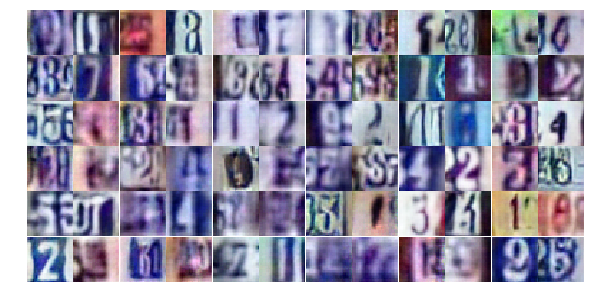

In [20]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

/home/ubuntu/miniconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


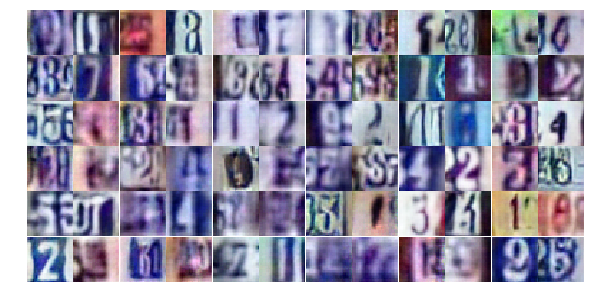

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))